Code for **"Inpainting"** figures $6$, $8$ and 7 (top) from the main paper. 

In [1]:
"""
*Uncomment if running on colab* 
Set Runtime -> Change runtime type -> Under Hardware Accelerator select GPU in Google Colab 
"""
!git clone https://github.com/DmitryUlyanov/deep-image-prior
!mv deep-image-prior/* ./

Cloning into 'deep-image-prior'...
remote: Enumerating objects: 289, done.
remote: Total 289 (delta 0), reused 0 (delta 0), pack-reused 289
Receiving objects: 100% (289/289), 24.28 MiB | 20.10 MiB/s, done.
Resolving deltas: 100% (155/155), done.


# Import libs

In [0]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import os
# os.environ['CUDA_VISIBLE_DEVICES'] = '1'

import numpy as np
from models.resnet import ResNet
from models.unet import UNet
from models.skip import skip
import torch
import torch.optim

from utils.inpainting_utils import *

torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark =True
dtype = torch.cuda.FloatTensor

PLOT = True
imsize = -1
dim_div_by = 64

# Choose figure

In [0]:
## Fig 6
# img_path  = 'data/inpainting/vase.png'
# mask_path = 'data/inpainting/vase_mask.png'

## Fig 8
# img_path  = 'data/inpainting/library.png'
# mask_path = 'data/inpainting/library_mask.png'

## Fig 7 (top)
img_path  = 'data/inpainting/kate.png'
mask_path = 'data/inpainting/kate_mask.png'

# Another text inpainting example
# img_path  = 'data/inpainting/peppers.png'
# mask_path = 'data/inpainting/peppers_mask.png'

NET_TYPE = 'skip_depth6' # one of skip_depth4|skip_depth2|UNET|ResNet

# Load mask

In [0]:
img_pil, img_np = get_image(img_path, imsize)
img_mask_pil, img_mask_np = get_image(mask_path, imsize)

### Center crop

In [0]:
img_mask_pil = crop_image(img_mask_pil, dim_div_by)
img_pil      = crop_image(img_pil,      dim_div_by)

img_np      = pil_to_np(img_pil)
img_mask_np = pil_to_np(img_mask_pil)

### Visualize

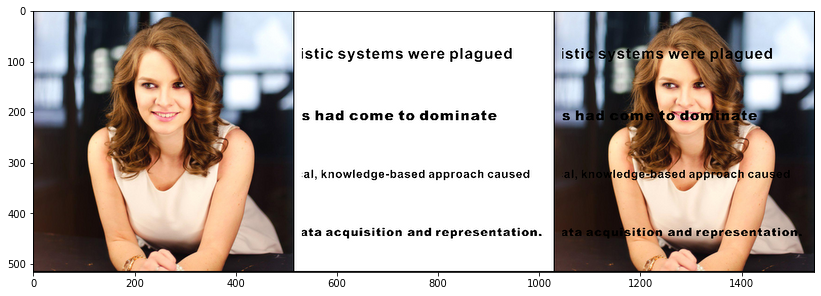

In [7]:
img_mask_var = np_to_torch(img_mask_np).type(dtype)

plot_image_grid([img_np, img_mask_np, img_mask_np*img_np], 3,11);

# Setup

In [0]:
pad = 'reflection' # 'zero'
OPT_OVER = 'net'
OPTIMIZER = 'adam'

In [0]:
if 'vase.png' in img_path:
    INPUT = 'meshgrid'
    input_depth = 2
    LR = 0.01 
    num_iter = 5001
    param_noise = False
    show_every = 50
    figsize = 5
    reg_noise_std = 0.03
    
    net = skip(input_depth, img_np.shape[0], 
               num_channels_down = [128] * 5,
               num_channels_up   = [128] * 5,
               num_channels_skip = [0] * 5,  
               upsample_mode='nearest', filter_skip_size=1, filter_size_up=3, filter_size_down=3,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
    
elif ('kate.png' in img_path) or ('peppers.png' in img_path):
    # Same params and net as in super-resolution and denoising
    INPUT = 'noise'
    input_depth = 32
    LR = 0.01 
    num_iter = 6001
    param_noise = False
    show_every = 50
    figsize = 5
    reg_noise_std = 0.03
    
    net = skip(input_depth, img_np.shape[0], 
               num_channels_down = [128] * 5,
               num_channels_up =   [128] * 5,
               num_channels_skip =    [128] * 5,  
               filter_size_up = 3, filter_size_down = 3, 
               upsample_mode='nearest', filter_skip_size=1,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
    
elif 'library.png' in img_path:
    
    INPUT = 'noise'
    input_depth = 1
    
    num_iter = 3001
    show_every = 50
    figsize = 8
    reg_noise_std = 0.00
    param_noise = True
    
    if 'skip' in NET_TYPE:
        
        depth = int(NET_TYPE[-1])
        net = skip(input_depth, img_np.shape[0], 
               num_channels_down = [16, 32, 64, 128, 128, 128][:depth],
               num_channels_up =   [16, 32, 64, 128, 128, 128][:depth],
               num_channels_skip =    [0, 0, 0, 0, 0, 0][:depth],  
               filter_size_up = 3,filter_size_down = 5,  filter_skip_size=1,
               upsample_mode='nearest', # downsample_mode='avg',
               need1x1_up=False,
               need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)
        
        LR = 0.01 
        
    elif NET_TYPE == 'UNET':
        
        net = UNet(num_input_channels=input_depth, num_output_channels=3, 
                   feature_scale=8, more_layers=1, 
                   concat_x=False, upsample_mode='deconv', 
                   pad='zero', norm_layer=torch.nn.InstanceNorm2d, need_sigmoid=True, need_bias=True)
        
        LR = 0.001
        param_noise = False
        
    elif NET_TYPE == 'ResNet':
        
        net = ResNet(input_depth, img_np.shape[0], 8, 32, need_sigmoid=True, act_fun='LeakyReLU')
        
        LR = 0.001
        param_noise = False
        
    else:
        assert False
else:
    assert False

net = net.type(dtype)
net_input = get_noise(input_depth, INPUT, img_np.shape[1:]).type(dtype)

In [10]:
# Compute number of parameters
s  = sum(np.prod(list(p.size())) for p in net.parameters())
print ('Number of params: %d' % s)

# Loss
mse = torch.nn.MSELoss().type(dtype)

img_var = np_to_torch(img_np).type(dtype)
mask_var = np_to_torch(img_mask_np).type(dtype)

Number of params: 3002627


# Main loop

Starting optimization with ADAM
Iteration 00000    Loss 0.126869

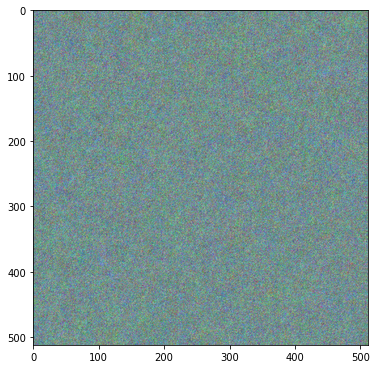

Iteration 00001    Loss 0.119360Iteration 00002    Loss 0.164346Iteration 00003    Loss 0.111029Iteration 00004    Loss 0.169787Iteration 00005    Loss 0.138762Iteration 00006    Loss 0.107541Iteration 00007    Loss 0.081837Iteration 00008    Loss 0.070669Iteration 00009    Loss 0.059835Iteration 00010    Loss 0.053408Iteration 00011    Loss 0.045425Iteration 00012    Loss 0.035828Iteration 00013    Loss 0.038908Iteration 00014    Loss 0.034400Iteration 00015    Loss 0.038100Iteration 00016    Loss 0.034839Iteration 00017    Loss 0.036295Iteration 00018    Loss 0.034915Iteration 00019    Loss 0.035550Iteration 00020    Loss 0.029798Iteration 00021    Loss 0.031761Iteration 00022    Loss 0.030094Iteration 00023    Loss 0.026461Iteration 00024    Loss 0.025354Iteration 00025    Loss 0.024232Iteration 00026    Loss 0.022848Iteration 00027    Loss 0.023580Iteration 00028    Loss 0.022079Iteration 00029    Loss 0.021912Iteration 00030    Loss 0.021291Iteration 00031    Loss 0.020867Iteratio

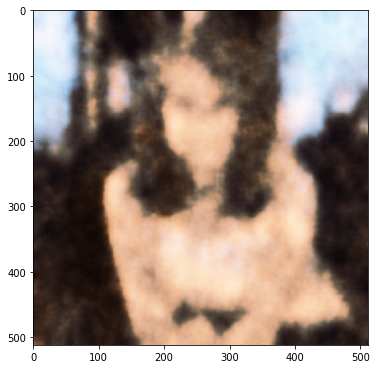

Iteration 00051    Loss 0.013056Iteration 00052    Loss 0.012828Iteration 00053    Loss 0.012655Iteration 00054    Loss 0.012144Iteration 00055    Loss 0.013084Iteration 00056    Loss 0.012645Iteration 00057    Loss 0.012578Iteration 00058    Loss 0.013442Iteration 00059    Loss 0.012986Iteration 00060    Loss 0.011713Iteration 00061    Loss 0.012797Iteration 00062    Loss 0.013181Iteration 00063    Loss 0.011462Iteration 00064    Loss 0.010982Iteration 00065    Loss 0.010949Iteration 00066    Loss 0.011934Iteration 00067    Loss 0.010919Iteration 00068    Loss 0.010509Iteration 00069    Loss 0.010919Iteration 00070    Loss 0.010767Iteration 00071    Loss 0.011340Iteration 00072    Loss 0.009307Iteration 00073    Loss 0.010947Iteration 00074    Loss 0.010612Iteration 00075    Loss 0.009105Iteration 00076    Loss 0.008963Iteration 00077    Loss 0.009511Iteration 00078    Loss 0.009150Iteration 00079    Loss 0.009835Iteration 00080    Loss 0.009900Iteration 00081    Loss 0.008999Iteratio

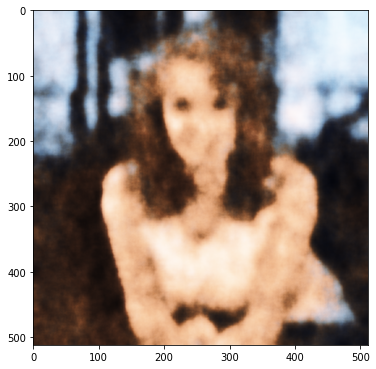

Iteration 00101    Loss 0.007030Iteration 00102    Loss 0.006941Iteration 00103    Loss 0.006888Iteration 00104    Loss 0.006442Iteration 00105    Loss 0.007228Iteration 00106    Loss 0.006796Iteration 00107    Loss 0.006604Iteration 00108    Loss 0.006480Iteration 00109    Loss 0.006487Iteration 00110    Loss 0.006924Iteration 00111    Loss 0.006094Iteration 00112    Loss 0.006402Iteration 00113    Loss 0.005975Iteration 00114    Loss 0.006581Iteration 00115    Loss 0.006355Iteration 00116    Loss 0.006246Iteration 00117    Loss 0.005937Iteration 00118    Loss 0.006171Iteration 00119    Loss 0.005920Iteration 00120    Loss 0.005844Iteration 00121    Loss 0.005604Iteration 00122    Loss 0.005800Iteration 00123    Loss 0.005765Iteration 00124    Loss 0.005920Iteration 00125    Loss 0.005455Iteration 00126    Loss 0.005500Iteration 00127    Loss 0.005441Iteration 00128    Loss 0.005756Iteration 00129    Loss 0.005568Iteration 00130    Loss 0.005463Iteration 00131    Loss 0.005623Iteratio

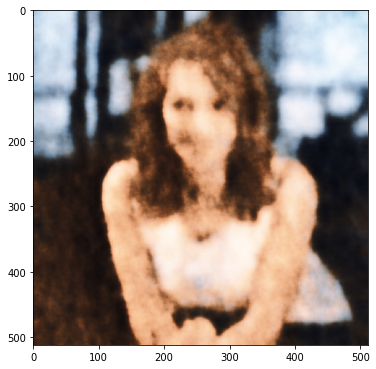

Iteration 00151    Loss 0.004841Iteration 00152    Loss 0.004825Iteration 00153    Loss 0.004831Iteration 00154    Loss 0.004644Iteration 00155    Loss 0.004787Iteration 00156    Loss 0.004641Iteration 00157    Loss 0.004505Iteration 00158    Loss 0.004864Iteration 00159    Loss 0.004768Iteration 00160    Loss 0.004395Iteration 00161    Loss 0.004585Iteration 00162    Loss 0.005027Iteration 00163    Loss 0.004775Iteration 00164    Loss 0.004241Iteration 00165    Loss 0.004685Iteration 00166    Loss 0.004624Iteration 00167    Loss 0.004466Iteration 00168    Loss 0.004131Iteration 00169    Loss 0.004240Iteration 00170    Loss 0.004121Iteration 00171    Loss 0.004343Iteration 00172    Loss 0.004165Iteration 00173    Loss 0.004245Iteration 00174    Loss 0.004206Iteration 00175    Loss 0.004006Iteration 00176    Loss 0.004209Iteration 00177    Loss 0.004057Iteration 00178    Loss 0.003934Iteration 00179    Loss 0.003948Iteration 00180    Loss 0.003945Iteration 00181    Loss 0.004184Iteratio

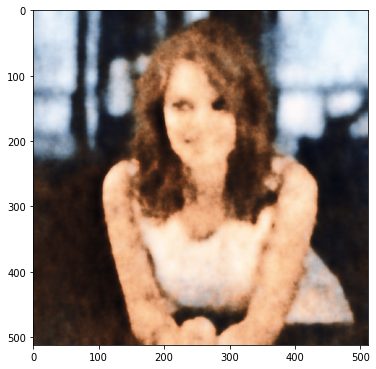

Iteration 00201    Loss 0.003793Iteration 00202    Loss 0.003767Iteration 00203    Loss 0.003509Iteration 00204    Loss 0.003860Iteration 00205    Loss 0.003680Iteration 00206    Loss 0.003713Iteration 00207    Loss 0.003455Iteration 00208    Loss 0.003451Iteration 00209    Loss 0.003698Iteration 00210    Loss 0.003496Iteration 00211    Loss 0.003580Iteration 00212    Loss 0.003400Iteration 00213    Loss 0.003554Iteration 00214    Loss 0.003382Iteration 00215    Loss 0.003502Iteration 00216    Loss 0.003399Iteration 00217    Loss 0.003226Iteration 00218    Loss 0.003298Iteration 00219    Loss 0.003288Iteration 00220    Loss 0.003283Iteration 00221    Loss 0.003395Iteration 00222    Loss 0.003280Iteration 00223    Loss 0.003268Iteration 00224    Loss 0.003285Iteration 00225    Loss 0.003356Iteration 00226    Loss 0.003170Iteration 00227    Loss 0.003169Iteration 00228    Loss 0.003080Iteration 00229    Loss 0.003228Iteration 00230    Loss 0.003130Iteration 00231    Loss 0.003114Iteratio

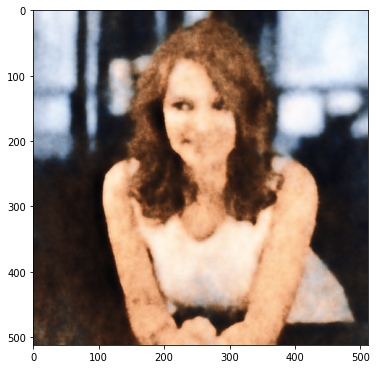

Iteration 00251    Loss 0.002890Iteration 00252    Loss 0.002833Iteration 00253    Loss 0.002819Iteration 00254    Loss 0.003013Iteration 00255    Loss 0.002847Iteration 00256    Loss 0.002795Iteration 00257    Loss 0.002883Iteration 00258    Loss 0.002992Iteration 00259    Loss 0.002866Iteration 00260    Loss 0.002746Iteration 00261    Loss 0.002801Iteration 00262    Loss 0.002779Iteration 00263    Loss 0.002739Iteration 00264    Loss 0.002757Iteration 00265    Loss 0.002962Iteration 00266    Loss 0.002966Iteration 00267    Loss 0.002806Iteration 00268    Loss 0.002994Iteration 00269    Loss 0.002886Iteration 00270    Loss 0.002903Iteration 00271    Loss 0.002841Iteration 00272    Loss 0.002761Iteration 00273    Loss 0.002641Iteration 00274    Loss 0.002699Iteration 00275    Loss 0.002744Iteration 00276    Loss 0.002722Iteration 00277    Loss 0.002864Iteration 00278    Loss 0.002825Iteration 00279    Loss 0.002714Iteration 00280    Loss 0.002491Iteration 00281    Loss 0.002720Iteratio

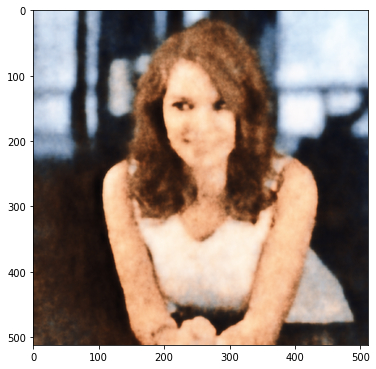

Iteration 00301    Loss 0.002551Iteration 00302    Loss 0.002510Iteration 00303    Loss 0.002586Iteration 00304    Loss 0.002331Iteration 00305    Loss 0.002456Iteration 00306    Loss 0.002479Iteration 00307    Loss 0.002441Iteration 00308    Loss 0.002312Iteration 00309    Loss 0.002450Iteration 00310    Loss 0.002242Iteration 00311    Loss 0.002348Iteration 00312    Loss 0.002302Iteration 00313    Loss 0.002372Iteration 00314    Loss 0.002372Iteration 00315    Loss 0.002473Iteration 00316    Loss 0.002333Iteration 00317    Loss 0.002348Iteration 00318    Loss 0.002371Iteration 00319    Loss 0.002227Iteration 00320    Loss 0.002453Iteration 00321    Loss 0.002376Iteration 00322    Loss 0.002203Iteration 00323    Loss 0.002214Iteration 00324    Loss 0.002323Iteration 00325    Loss 0.002227Iteration 00326    Loss 0.002261Iteration 00327    Loss 0.002207Iteration 00328    Loss 0.002261Iteration 00329    Loss 0.002224Iteration 00330    Loss 0.002229Iteration 00331    Loss 0.002202Iteratio

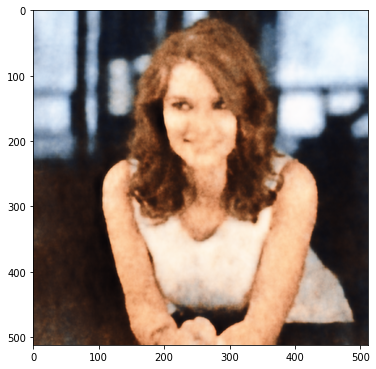

Iteration 00351    Loss 0.001957Iteration 00352    Loss 0.002248Iteration 00353    Loss 0.002143Iteration 00354    Loss 0.002115Iteration 00355    Loss 0.002138Iteration 00356    Loss 0.002062Iteration 00357    Loss 0.002118Iteration 00358    Loss 0.001990Iteration 00359    Loss 0.002226Iteration 00360    Loss 0.002053Iteration 00361    Loss 0.002017Iteration 00362    Loss 0.001895Iteration 00363    Loss 0.001887Iteration 00364    Loss 0.001951Iteration 00365    Loss 0.001949Iteration 00366    Loss 0.001956Iteration 00367    Loss 0.001947Iteration 00368    Loss 0.002176Iteration 00369    Loss 0.001937Iteration 00370    Loss 0.002014Iteration 00371    Loss 0.001911Iteration 00372    Loss 0.001956Iteration 00373    Loss 0.001858Iteration 00374    Loss 0.001865Iteration 00375    Loss 0.001939Iteration 00376    Loss 0.001893Iteration 00377    Loss 0.001946Iteration 00378    Loss 0.001974Iteration 00379    Loss 0.001965Iteration 00380    Loss 0.001944Iteration 00381    Loss 0.001975Iteratio

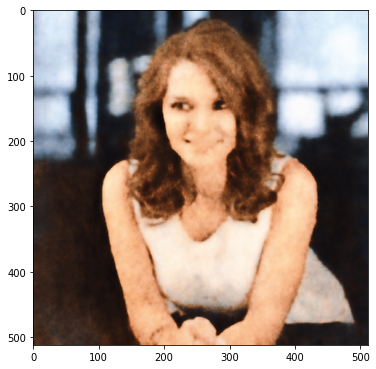

Iteration 00401    Loss 0.002147Iteration 00402    Loss 0.001802Iteration 00403    Loss 0.001872Iteration 00404    Loss 0.001843Iteration 00405    Loss 0.001879Iteration 00406    Loss 0.001790Iteration 00407    Loss 0.001775Iteration 00408    Loss 0.001901Iteration 00409    Loss 0.001706Iteration 00410    Loss 0.001991Iteration 00411    Loss 0.001752Iteration 00412    Loss 0.001790Iteration 00413    Loss 0.001799Iteration 00414    Loss 0.001694Iteration 00415    Loss 0.001723Iteration 00416    Loss 0.001748Iteration 00417    Loss 0.001713Iteration 00418    Loss 0.001784Iteration 00419    Loss 0.001646Iteration 00420    Loss 0.001849Iteration 00421    Loss 0.001702Iteration 00422    Loss 0.001742Iteration 00423    Loss 0.001684Iteration 00424    Loss 0.001597Iteration 00425    Loss 0.001657Iteration 00426    Loss 0.001581Iteration 00427    Loss 0.001640Iteration 00428    Loss 0.001682Iteration 00429    Loss 0.001638Iteration 00430    Loss 0.001697Iteration 00431    Loss 0.001715Iteratio

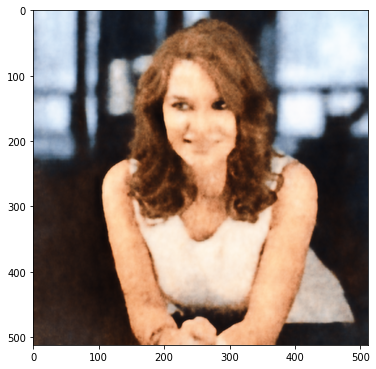

Iteration 00451    Loss 0.001632Iteration 00452    Loss 0.001611Iteration 00453    Loss 0.001623Iteration 00454    Loss 0.001602Iteration 00455    Loss 0.001610Iteration 00456    Loss 0.001567Iteration 00457    Loss 0.001558Iteration 00458    Loss 0.001601Iteration 00459    Loss 0.001557Iteration 00460    Loss 0.001563Iteration 00461    Loss 0.001626Iteration 00462    Loss 0.001493Iteration 00463    Loss 0.001524Iteration 00464    Loss 0.001556Iteration 00465    Loss 0.001668Iteration 00466    Loss 0.001528Iteration 00467    Loss 0.001718Iteration 00468    Loss 0.001579Iteration 00469    Loss 0.001474Iteration 00470    Loss 0.001538Iteration 00471    Loss 0.001515Iteration 00472    Loss 0.001529Iteration 00473    Loss 0.001521Iteration 00474    Loss 0.001487Iteration 00475    Loss 0.001552Iteration 00476    Loss 0.001532Iteration 00477    Loss 0.001649Iteration 00478    Loss 0.001640Iteration 00479    Loss 0.001521Iteration 00480    Loss 0.001527Iteration 00481    Loss 0.001763Iteratio

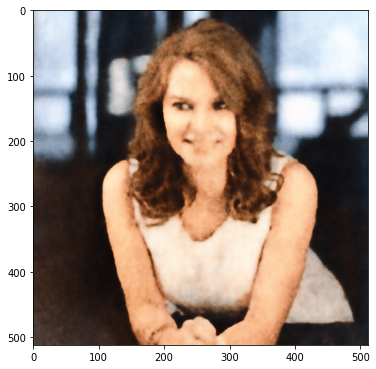

Iteration 00501    Loss 0.001411Iteration 00502    Loss 0.001475Iteration 00503    Loss 0.001511Iteration 00504    Loss 0.001512Iteration 00505    Loss 0.001522Iteration 00506    Loss 0.001446Iteration 00507    Loss 0.001436Iteration 00508    Loss 0.001443Iteration 00509    Loss 0.001554Iteration 00510    Loss 0.001446Iteration 00511    Loss 0.001482Iteration 00512    Loss 0.001414Iteration 00513    Loss 0.001360Iteration 00514    Loss 0.001451Iteration 00515    Loss 0.001467Iteration 00516    Loss 0.001445Iteration 00517    Loss 0.001395Iteration 00518    Loss 0.001414Iteration 00519    Loss 0.001423Iteration 00520    Loss 0.001357Iteration 00521    Loss 0.001382Iteration 00522    Loss 0.001376Iteration 00523    Loss 0.001338Iteration 00524    Loss 0.001375Iteration 00525    Loss 0.001347Iteration 00526    Loss 0.001357Iteration 00527    Loss 0.001363Iteration 00528    Loss 0.001302Iteration 00529    Loss 0.001403Iteration 00530    Loss 0.001343Iteration 00531    Loss 0.001387Iteratio

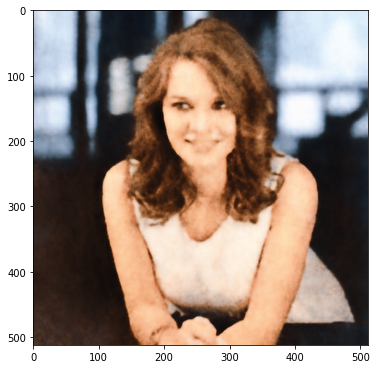

Iteration 00551    Loss 0.001342Iteration 00552    Loss 0.001356Iteration 00553    Loss 0.001423Iteration 00554    Loss 0.001408Iteration 00555    Loss 0.001338Iteration 00556    Loss 0.001347Iteration 00557    Loss 0.001324Iteration 00558    Loss 0.001321Iteration 00559    Loss 0.001365Iteration 00560    Loss 0.001289Iteration 00561    Loss 0.001236Iteration 00562    Loss 0.001240Iteration 00563    Loss 0.001301Iteration 00564    Loss 0.001349Iteration 00565    Loss 0.001292Iteration 00566    Loss 0.001338Iteration 00567    Loss 0.001315Iteration 00568    Loss 0.001295Iteration 00569    Loss 0.001284Iteration 00570    Loss 0.001301Iteration 00571    Loss 0.001308Iteration 00572    Loss 0.001218Iteration 00573    Loss 0.001289Iteration 00574    Loss 0.001250Iteration 00575    Loss 0.001266Iteration 00576    Loss 0.001245Iteration 00577    Loss 0.001215Iteration 00578    Loss 0.001280Iteration 00579    Loss 0.001290Iteration 00580    Loss 0.001254Iteration 00581    Loss 0.001187Iteratio

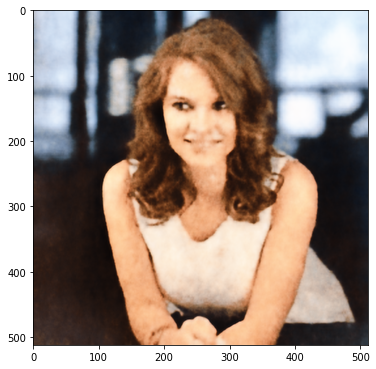

Iteration 00601    Loss 0.001215Iteration 00602    Loss 0.001208Iteration 00603    Loss 0.001228Iteration 00604    Loss 0.001385Iteration 00605    Loss 0.001192Iteration 00606    Loss 0.001304Iteration 00607    Loss 0.001222Iteration 00608    Loss 0.001259Iteration 00609    Loss 0.001138Iteration 00610    Loss 0.001228Iteration 00611    Loss 0.001169Iteration 00612    Loss 0.001256Iteration 00613    Loss 0.001196Iteration 00614    Loss 0.001171Iteration 00615    Loss 0.001251Iteration 00616    Loss 0.001127Iteration 00617    Loss 0.001218Iteration 00618    Loss 0.001199Iteration 00619    Loss 0.001229Iteration 00620    Loss 0.001181Iteration 00621    Loss 0.001225Iteration 00622    Loss 0.001166Iteration 00623    Loss 0.001233Iteration 00624    Loss 0.001154Iteration 00625    Loss 0.001209Iteration 00626    Loss 0.001142Iteration 00627    Loss 0.001099Iteration 00628    Loss 0.001123Iteration 00629    Loss 0.001113Iteration 00630    Loss 0.001134Iteration 00631    Loss 0.001177Iteratio

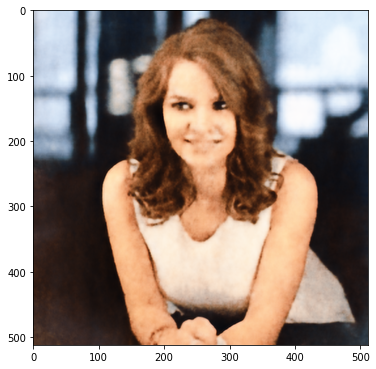

Iteration 00651    Loss 0.001133Iteration 00652    Loss 0.001152Iteration 00653    Loss 0.001105Iteration 00654    Loss 0.001100Iteration 00655    Loss 0.001199Iteration 00656    Loss 0.001112Iteration 00657    Loss 0.001108Iteration 00658    Loss 0.001119Iteration 00659    Loss 0.001076Iteration 00660    Loss 0.001098Iteration 00661    Loss 0.001111Iteration 00662    Loss 0.001157Iteration 00663    Loss 0.001123Iteration 00664    Loss 0.001123Iteration 00665    Loss 0.001082Iteration 00666    Loss 0.001122Iteration 00667    Loss 0.001138Iteration 00668    Loss 0.001057Iteration 00669    Loss 0.001081Iteration 00670    Loss 0.001089Iteration 00671    Loss 0.001081Iteration 00672    Loss 0.001097Iteration 00673    Loss 0.001105Iteration 00674    Loss 0.001043Iteration 00675    Loss 0.001082Iteration 00676    Loss 0.001091Iteration 00677    Loss 0.001064Iteration 00678    Loss 0.001123Iteration 00679    Loss 0.001106Iteration 00680    Loss 0.001080Iteration 00681    Loss 0.001119Iteratio

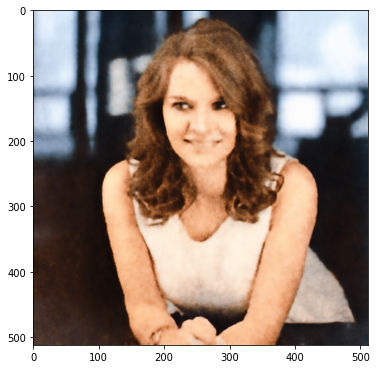

Iteration 00701    Loss 0.001050Iteration 00702    Loss 0.001009Iteration 00703    Loss 0.001019Iteration 00704    Loss 0.001028Iteration 00705    Loss 0.001034Iteration 00706    Loss 0.001013Iteration 00707    Loss 0.001045Iteration 00708    Loss 0.001009Iteration 00709    Loss 0.001008Iteration 00710    Loss 0.001060Iteration 00711    Loss 0.000995Iteration 00712    Loss 0.001051Iteration 00713    Loss 0.000984Iteration 00714    Loss 0.001100Iteration 00715    Loss 0.001035Iteration 00716    Loss 0.001020Iteration 00717    Loss 0.000984Iteration 00718    Loss 0.001015Iteration 00719    Loss 0.001002Iteration 00720    Loss 0.001022Iteration 00721    Loss 0.000996Iteration 00722    Loss 0.001010Iteration 00723    Loss 0.001051Iteration 00724    Loss 0.001091Iteration 00725    Loss 0.000993Iteration 00726    Loss 0.000974Iteration 00727    Loss 0.001036Iteration 00728    Loss 0.001002Iteration 00729    Loss 0.000992Iteration 00730    Loss 0.001043Iteration 00731    Loss 0.000990Iteratio

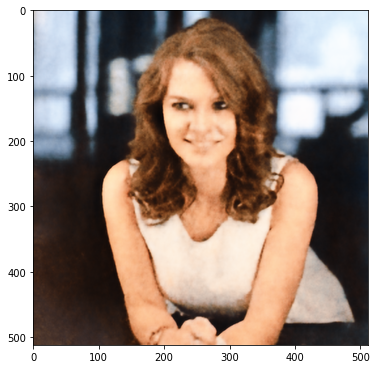

Iteration 00751    Loss 0.000942Iteration 00752    Loss 0.000969Iteration 00753    Loss 0.001003Iteration 00754    Loss 0.000976Iteration 00755    Loss 0.000955Iteration 00756    Loss 0.000989Iteration 00757    Loss 0.000969Iteration 00758    Loss 0.000980Iteration 00759    Loss 0.000959Iteration 00760    Loss 0.000971Iteration 00761    Loss 0.000990Iteration 00762    Loss 0.000959Iteration 00763    Loss 0.000953Iteration 00764    Loss 0.000945Iteration 00765    Loss 0.000992Iteration 00766    Loss 0.000931Iteration 00767    Loss 0.000977Iteration 00768    Loss 0.001002Iteration 00769    Loss 0.000987Iteration 00770    Loss 0.000942Iteration 00771    Loss 0.000954Iteration 00772    Loss 0.000992Iteration 00773    Loss 0.000934Iteration 00774    Loss 0.001042Iteration 00775    Loss 0.000954Iteration 00776    Loss 0.000940Iteration 00777    Loss 0.000968Iteration 00778    Loss 0.000972Iteration 00779    Loss 0.000902Iteration 00780    Loss 0.001004Iteration 00781    Loss 0.000951Iteratio

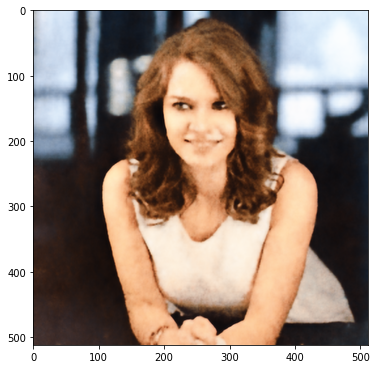

Iteration 00801    Loss 0.001056Iteration 00802    Loss 0.000971Iteration 00803    Loss 0.001067Iteration 00804    Loss 0.000963Iteration 00805    Loss 0.001113Iteration 00806    Loss 0.000923Iteration 00807    Loss 0.001048Iteration 00808    Loss 0.000904Iteration 00809    Loss 0.001018Iteration 00810    Loss 0.000948Iteration 00811    Loss 0.000907Iteration 00812    Loss 0.000935Iteration 00813    Loss 0.000883Iteration 00814    Loss 0.000947Iteration 00815    Loss 0.000931Iteration 00816    Loss 0.000888Iteration 00817    Loss 0.000916Iteration 00818    Loss 0.000887Iteration 00819    Loss 0.000903Iteration 00820    Loss 0.000936Iteration 00821    Loss 0.000948Iteration 00822    Loss 0.000900Iteration 00823    Loss 0.000945Iteration 00824    Loss 0.000943Iteration 00825    Loss 0.000901Iteration 00826    Loss 0.000914Iteration 00827    Loss 0.000926Iteration 00828    Loss 0.000915Iteration 00829    Loss 0.000953Iteration 00830    Loss 0.000844Iteration 00831    Loss 0.000916Iteratio

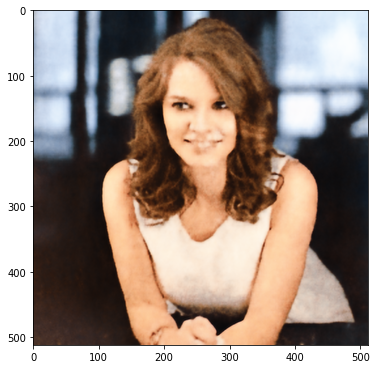

Iteration 00851    Loss 0.000860Iteration 00852    Loss 0.000924Iteration 00853    Loss 0.000870Iteration 00854    Loss 0.000922Iteration 00855    Loss 0.000843Iteration 00856    Loss 0.000847Iteration 00857    Loss 0.000866Iteration 00858    Loss 0.000878Iteration 00859    Loss 0.000873Iteration 00860    Loss 0.000845Iteration 00861    Loss 0.000907Iteration 00862    Loss 0.000862Iteration 00863    Loss 0.000865Iteration 00864    Loss 0.000851Iteration 00865    Loss 0.000861Iteration 00866    Loss 0.000844Iteration 00867    Loss 0.000863Iteration 00868    Loss 0.000849Iteration 00869    Loss 0.000851Iteration 00870    Loss 0.000836Iteration 00871    Loss 0.000874Iteration 00872    Loss 0.000843Iteration 00873    Loss 0.000890Iteration 00874    Loss 0.000854Iteration 00875    Loss 0.000814Iteration 00876    Loss 0.000885Iteration 00877    Loss 0.000868Iteration 00878    Loss 0.000844Iteration 00879    Loss 0.000819Iteration 00880    Loss 0.000889Iteration 00881    Loss 0.000835Iteratio

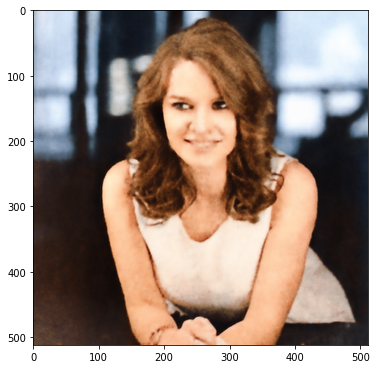

Iteration 00901    Loss 0.000842Iteration 00902    Loss 0.000837Iteration 00903    Loss 0.000824Iteration 00904    Loss 0.000804Iteration 00905    Loss 0.000850Iteration 00906    Loss 0.000810Iteration 00907    Loss 0.000827Iteration 00908    Loss 0.000835Iteration 00909    Loss 0.000816Iteration 00910    Loss 0.000831Iteration 00911    Loss 0.000840Iteration 00912    Loss 0.000807Iteration 00913    Loss 0.000805Iteration 00914    Loss 0.000776Iteration 00915    Loss 0.000797Iteration 00916    Loss 0.000824Iteration 00917    Loss 0.000783Iteration 00918    Loss 0.000817Iteration 00919    Loss 0.000800Iteration 00920    Loss 0.000799Iteration 00921    Loss 0.000775Iteration 00922    Loss 0.000786Iteration 00923    Loss 0.000784Iteration 00924    Loss 0.000774Iteration 00925    Loss 0.000802Iteration 00926    Loss 0.000805Iteration 00927    Loss 0.000785Iteration 00928    Loss 0.000812Iteration 00929    Loss 0.000758Iteration 00930    Loss 0.000789Iteration 00931    Loss 0.000777Iteratio

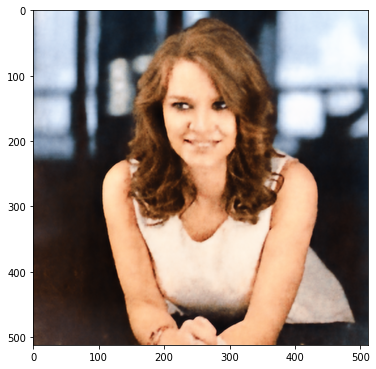

Iteration 00951    Loss 0.000782Iteration 00952    Loss 0.000849Iteration 00953    Loss 0.000777Iteration 00954    Loss 0.000757Iteration 00955    Loss 0.000763Iteration 00956    Loss 0.000805Iteration 00957    Loss 0.000761Iteration 00958    Loss 0.000786Iteration 00959    Loss 0.000726Iteration 00960    Loss 0.000787Iteration 00961    Loss 0.000781Iteration 00962    Loss 0.000747Iteration 00963    Loss 0.000758Iteration 00964    Loss 0.000786Iteration 00965    Loss 0.000780Iteration 00966    Loss 0.000762Iteration 00967    Loss 0.000786Iteration 00968    Loss 0.000756Iteration 00969    Loss 0.000775Iteration 00970    Loss 0.000743Iteration 00971    Loss 0.000773Iteration 00972    Loss 0.000779Iteration 00973    Loss 0.000734Iteration 00974    Loss 0.000782Iteration 00975    Loss 0.000783Iteration 00976    Loss 0.000774Iteration 00977    Loss 0.000770Iteration 00978    Loss 0.000789Iteration 00979    Loss 0.000748Iteration 00980    Loss 0.000739Iteration 00981    Loss 0.000747Iteratio

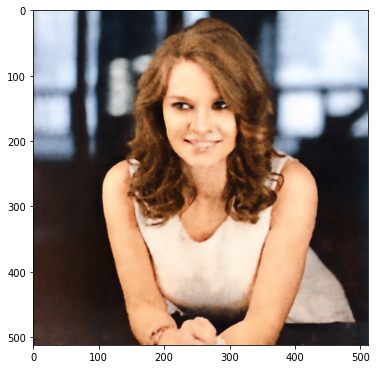

Iteration 01001    Loss 0.000725Iteration 01002    Loss 0.000739Iteration 01003    Loss 0.000719Iteration 01004    Loss 0.000820Iteration 01005    Loss 0.000741Iteration 01006    Loss 0.000748Iteration 01007    Loss 0.000714Iteration 01008    Loss 0.000744Iteration 01009    Loss 0.000708Iteration 01010    Loss 0.000723Iteration 01011    Loss 0.000754Iteration 01012    Loss 0.000761Iteration 01013    Loss 0.000748Iteration 01014    Loss 0.000724Iteration 01015    Loss 0.000733Iteration 01016    Loss 0.000714Iteration 01017    Loss 0.000731Iteration 01018    Loss 0.000720Iteration 01019    Loss 0.000727Iteration 01020    Loss 0.000731Iteration 01021    Loss 0.000750Iteration 01022    Loss 0.000714Iteration 01023    Loss 0.000724Iteration 01024    Loss 0.000741Iteration 01025    Loss 0.000706Iteration 01026    Loss 0.000728Iteration 01027    Loss 0.000721Iteration 01028    Loss 0.000724Iteration 01029    Loss 0.000698Iteration 01030    Loss 0.000727Iteration 01031    Loss 0.000700Iteratio

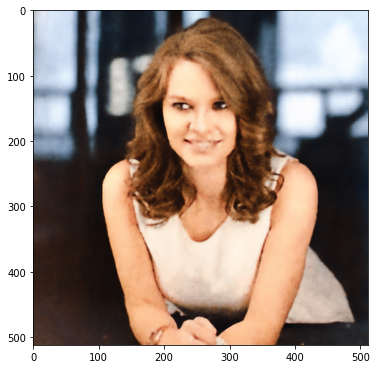

Iteration 01051    Loss 0.000730Iteration 01052    Loss 0.000697Iteration 01053    Loss 0.000690Iteration 01054    Loss 0.000703Iteration 01055    Loss 0.000691Iteration 01056    Loss 0.000754Iteration 01057    Loss 0.000696Iteration 01058    Loss 0.000749Iteration 01059    Loss 0.000708Iteration 01060    Loss 0.000712Iteration 01061    Loss 0.000718Iteration 01062    Loss 0.000700Iteration 01063    Loss 0.000693Iteration 01064    Loss 0.000685Iteration 01065    Loss 0.000716Iteration 01066    Loss 0.000712Iteration 01067    Loss 0.000685Iteration 01068    Loss 0.000706Iteration 01069    Loss 0.000692Iteration 01070    Loss 0.000728Iteration 01071    Loss 0.000710Iteration 01072    Loss 0.000703Iteration 01073    Loss 0.000696Iteration 01074    Loss 0.000673Iteration 01075    Loss 0.000715Iteration 01076    Loss 0.000721Iteration 01077    Loss 0.000696Iteration 01078    Loss 0.000671Iteration 01079    Loss 0.000716Iteration 01080    Loss 0.000729Iteration 01081    Loss 0.000679Iteratio

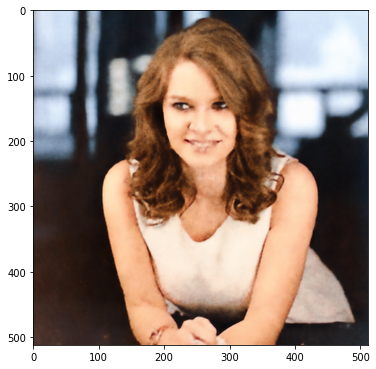

Iteration 01101    Loss 0.000671Iteration 01102    Loss 0.000665Iteration 01103    Loss 0.000657Iteration 01104    Loss 0.000693Iteration 01105    Loss 0.000655Iteration 01106    Loss 0.000706Iteration 01107    Loss 0.000657Iteration 01108    Loss 0.000692Iteration 01109    Loss 0.000652Iteration 01110    Loss 0.000677Iteration 01111    Loss 0.000669Iteration 01112    Loss 0.000663Iteration 01113    Loss 0.000691Iteration 01114    Loss 0.000660Iteration 01115    Loss 0.000639Iteration 01116    Loss 0.000669Iteration 01117    Loss 0.000652Iteration 01118    Loss 0.000638Iteration 01119    Loss 0.000665Iteration 01120    Loss 0.000663Iteration 01121    Loss 0.000646Iteration 01122    Loss 0.000659Iteration 01123    Loss 0.000680Iteration 01124    Loss 0.000655Iteration 01125    Loss 0.000671Iteration 01126    Loss 0.000672Iteration 01127    Loss 0.000658Iteration 01128    Loss 0.000674Iteration 01129    Loss 0.000649Iteration 01130    Loss 0.000660Iteration 01131    Loss 0.000628Iteratio

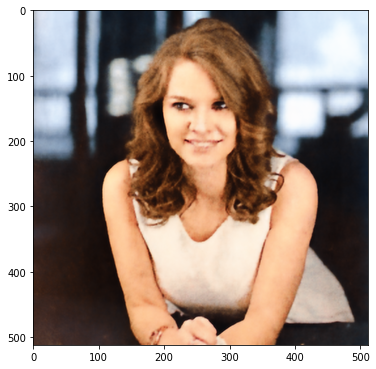

Iteration 01151    Loss 0.000621Iteration 01152    Loss 0.000655Iteration 01153    Loss 0.000624Iteration 01154    Loss 0.000646Iteration 01155    Loss 0.000627Iteration 01156    Loss 0.000646Iteration 01157    Loss 0.000643Iteration 01158    Loss 0.000682Iteration 01159    Loss 0.000651Iteration 01160    Loss 0.000630Iteration 01161    Loss 0.000648Iteration 01162    Loss 0.000634Iteration 01163    Loss 0.000667Iteration 01164    Loss 0.000602Iteration 01165    Loss 0.000688Iteration 01166    Loss 0.000625Iteration 01167    Loss 0.000650Iteration 01168    Loss 0.000633Iteration 01169    Loss 0.000671Iteration 01170    Loss 0.000641Iteration 01171    Loss 0.000615Iteration 01172    Loss 0.000650Iteration 01173    Loss 0.000641Iteration 01174    Loss 0.000674Iteration 01175    Loss 0.000621Iteration 01176    Loss 0.000642Iteration 01177    Loss 0.000632Iteration 01178    Loss 0.000631Iteration 01179    Loss 0.000644Iteration 01180    Loss 0.000653Iteration 01181    Loss 0.000630Iteratio

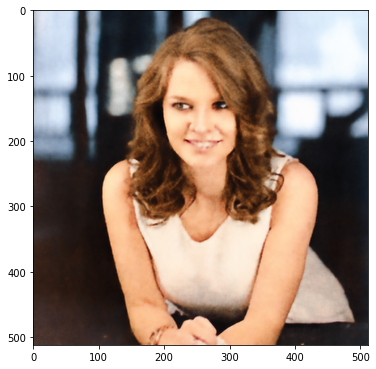

Iteration 01201    Loss 0.000643Iteration 01202    Loss 0.000626Iteration 01203    Loss 0.000650Iteration 01204    Loss 0.000616Iteration 01205    Loss 0.000611Iteration 01206    Loss 0.000646Iteration 01207    Loss 0.000604Iteration 01208    Loss 0.000623Iteration 01209    Loss 0.000630Iteration 01210    Loss 0.000625Iteration 01211    Loss 0.000636Iteration 01212    Loss 0.000633Iteration 01213    Loss 0.000612Iteration 01214    Loss 0.000673Iteration 01215    Loss 0.000648Iteration 01216    Loss 0.000618Iteration 01217    Loss 0.000643Iteration 01218    Loss 0.000635Iteration 01219    Loss 0.000648Iteration 01220    Loss 0.000626Iteration 01221    Loss 0.000612Iteration 01222    Loss 0.000607Iteration 01223    Loss 0.000618Iteration 01224    Loss 0.000614Iteration 01225    Loss 0.000604Iteration 01226    Loss 0.000651Iteration 01227    Loss 0.000628Iteration 01228    Loss 0.000614Iteration 01229    Loss 0.000632Iteration 01230    Loss 0.000617Iteration 01231    Loss 0.000609Iteratio

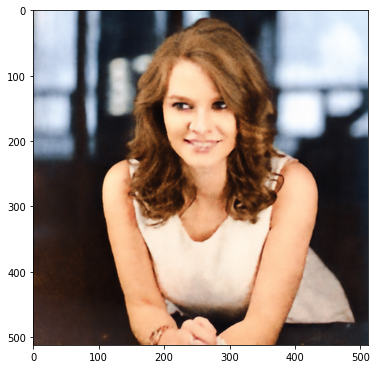

Iteration 01251    Loss 0.000604Iteration 01252    Loss 0.000574Iteration 01253    Loss 0.000605Iteration 01254    Loss 0.000604Iteration 01255    Loss 0.000613Iteration 01256    Loss 0.000584Iteration 01257    Loss 0.000596Iteration 01258    Loss 0.000598Iteration 01259    Loss 0.000581Iteration 01260    Loss 0.000600Iteration 01261    Loss 0.000589Iteration 01262    Loss 0.000573Iteration 01263    Loss 0.000574Iteration 01264    Loss 0.000595Iteration 01265    Loss 0.000570Iteration 01266    Loss 0.000579Iteration 01267    Loss 0.000566Iteration 01268    Loss 0.000563Iteration 01269    Loss 0.000582Iteration 01270    Loss 0.000580Iteration 01271    Loss 0.000578Iteration 01272    Loss 0.000580Iteration 01273    Loss 0.000551Iteration 01274    Loss 0.000568Iteration 01275    Loss 0.000567Iteration 01276    Loss 0.000588Iteration 01277    Loss 0.000555Iteration 01278    Loss 0.000575Iteration 01279    Loss 0.000565Iteration 01280    Loss 0.000573Iteration 01281    Loss 0.000568Iteratio

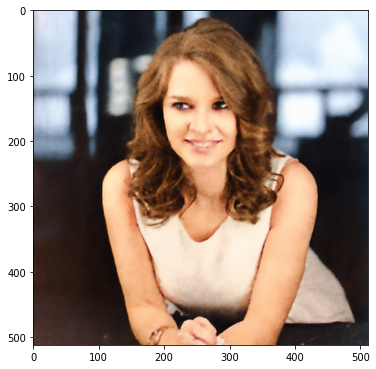

Iteration 01301    Loss 0.000582Iteration 01302    Loss 0.000599Iteration 01303    Loss 0.000551Iteration 01304    Loss 0.000642Iteration 01305    Loss 0.000552Iteration 01306    Loss 0.000604Iteration 01307    Loss 0.000558Iteration 01308    Loss 0.000565Iteration 01309    Loss 0.000563Iteration 01310    Loss 0.000567Iteration 01311    Loss 0.000561Iteration 01312    Loss 0.000572Iteration 01313    Loss 0.000567Iteration 01314    Loss 0.000544Iteration 01315    Loss 0.000585Iteration 01316    Loss 0.000552Iteration 01317    Loss 0.000585Iteration 01318    Loss 0.000561Iteration 01319    Loss 0.000576Iteration 01320    Loss 0.000581Iteration 01321    Loss 0.000576Iteration 01322    Loss 0.000593Iteration 01323    Loss 0.000573Iteration 01324    Loss 0.000559Iteration 01325    Loss 0.000542Iteration 01326    Loss 0.000569Iteration 01327    Loss 0.000544Iteration 01328    Loss 0.000587Iteration 01329    Loss 0.000579Iteration 01330    Loss 0.000549Iteration 01331    Loss 0.000556Iteratio

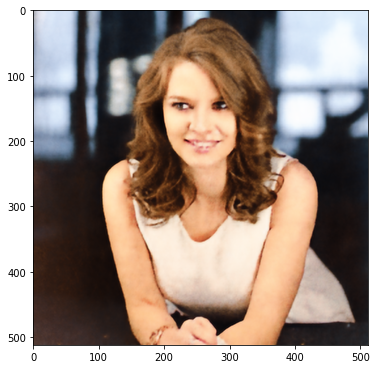

Iteration 01351    Loss 0.000565Iteration 01352    Loss 0.000573Iteration 01353    Loss 0.000546Iteration 01354    Loss 0.000598Iteration 01355    Loss 0.000552Iteration 01356    Loss 0.000572Iteration 01357    Loss 0.000596Iteration 01358    Loss 0.000524Iteration 01359    Loss 0.000570Iteration 01360    Loss 0.000556Iteration 01361    Loss 0.000530Iteration 01362    Loss 0.000564Iteration 01363    Loss 0.000554Iteration 01364    Loss 0.000535Iteration 01365    Loss 0.000553Iteration 01366    Loss 0.000542Iteration 01367    Loss 0.000567Iteration 01368    Loss 0.000537Iteration 01369    Loss 0.000544Iteration 01370    Loss 0.000545Iteration 01371    Loss 0.000544Iteration 01372    Loss 0.000561Iteration 01373    Loss 0.000526Iteration 01374    Loss 0.000519Iteration 01375    Loss 0.000525Iteration 01376    Loss 0.000508Iteration 01377    Loss 0.000536Iteration 01378    Loss 0.000529Iteration 01379    Loss 0.000512Iteration 01380    Loss 0.000521Iteration 01381    Loss 0.000526Iteratio

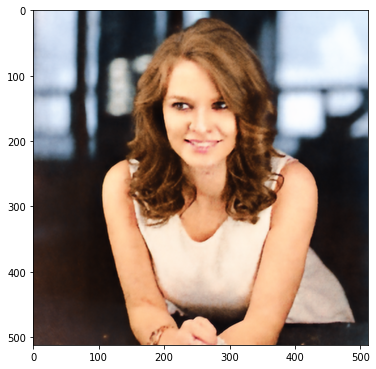

Iteration 01401    Loss 0.000520Iteration 01402    Loss 0.000513Iteration 01403    Loss 0.000542Iteration 01404    Loss 0.000545Iteration 01405    Loss 0.000518Iteration 01406    Loss 0.000538Iteration 01407    Loss 0.000573Iteration 01408    Loss 0.000525Iteration 01409    Loss 0.000574Iteration 01410    Loss 0.000541Iteration 01411    Loss 0.000539Iteration 01412    Loss 0.000507Iteration 01413    Loss 0.000566Iteration 01414    Loss 0.000531Iteration 01415    Loss 0.000544Iteration 01416    Loss 0.000552Iteration 01417    Loss 0.000516Iteration 01418    Loss 0.000551Iteration 01419    Loss 0.000514Iteration 01420    Loss 0.000521Iteration 01421    Loss 0.000510Iteration 01422    Loss 0.000515Iteration 01423    Loss 0.000531Iteration 01424    Loss 0.000494Iteration 01425    Loss 0.000525Iteration 01426    Loss 0.000499Iteration 01427    Loss 0.000543Iteration 01428    Loss 0.000539Iteration 01429    Loss 0.000540Iteration 01430    Loss 0.000531Iteration 01431    Loss 0.000533Iteratio

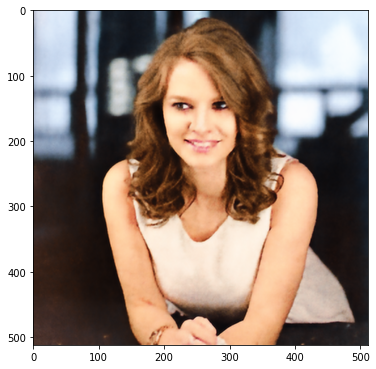

Iteration 01451    Loss 0.000498Iteration 01452    Loss 0.000509Iteration 01453    Loss 0.000523Iteration 01454    Loss 0.000512Iteration 01455    Loss 0.000542Iteration 01456    Loss 0.000546Iteration 01457    Loss 0.000517Iteration 01458    Loss 0.000517Iteration 01459    Loss 0.000533Iteration 01460    Loss 0.000497Iteration 01461    Loss 0.000514Iteration 01462    Loss 0.000512Iteration 01463    Loss 0.000503Iteration 01464    Loss 0.000528Iteration 01465    Loss 0.000490Iteration 01466    Loss 0.000502Iteration 01467    Loss 0.000532Iteration 01468    Loss 0.000489Iteration 01469    Loss 0.000483Iteration 01470    Loss 0.000494Iteration 01471    Loss 0.000519Iteration 01472    Loss 0.000514Iteration 01473    Loss 0.000511Iteration 01474    Loss 0.000487Iteration 01475    Loss 0.000495Iteration 01476    Loss 0.000516Iteration 01477    Loss 0.000501Iteration 01478    Loss 0.000501Iteration 01479    Loss 0.000523Iteration 01480    Loss 0.000524Iteration 01481    Loss 0.000497Iteratio

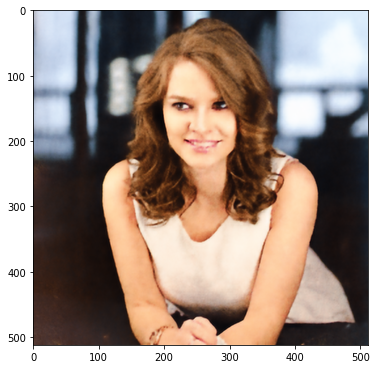

Iteration 01501    Loss 0.000588Iteration 01502    Loss 0.000556Iteration 01503    Loss 0.000511Iteration 01504    Loss 0.000540Iteration 01505    Loss 0.000507Iteration 01506    Loss 0.000534Iteration 01507    Loss 0.000544Iteration 01508    Loss 0.000496Iteration 01509    Loss 0.000580Iteration 01510    Loss 0.000499Iteration 01511    Loss 0.000535Iteration 01512    Loss 0.000545Iteration 01513    Loss 0.000493Iteration 01514    Loss 0.000553Iteration 01515    Loss 0.000493Iteration 01516    Loss 0.000521Iteration 01517    Loss 0.000494Iteration 01518    Loss 0.000523Iteration 01519    Loss 0.000501Iteration 01520    Loss 0.000500Iteration 01521    Loss 0.000484Iteration 01522    Loss 0.000516Iteration 01523    Loss 0.000493Iteration 01524    Loss 0.000517Iteration 01525    Loss 0.000524Iteration 01526    Loss 0.000491Iteration 01527    Loss 0.000526Iteration 01528    Loss 0.000496Iteration 01529    Loss 0.000501Iteration 01530    Loss 0.000490Iteration 01531    Loss 0.000486Iteratio

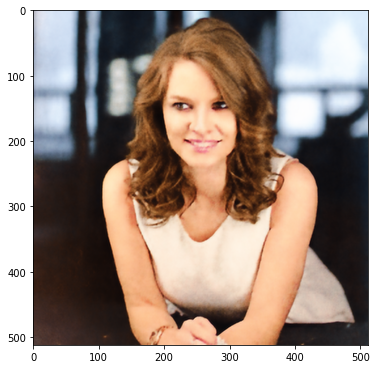

Iteration 01551    Loss 0.000469Iteration 01552    Loss 0.000470Iteration 01553    Loss 0.000529Iteration 01554    Loss 0.000474Iteration 01555    Loss 0.000492Iteration 01556    Loss 0.000469Iteration 01557    Loss 0.000491Iteration 01558    Loss 0.000471Iteration 01559    Loss 0.000477Iteration 01560    Loss 0.000509Iteration 01561    Loss 0.000472Iteration 01562    Loss 0.000481Iteration 01563    Loss 0.000493Iteration 01564    Loss 0.000473Iteration 01565    Loss 0.000482Iteration 01566    Loss 0.000466Iteration 01567    Loss 0.000482Iteration 01568    Loss 0.000459Iteration 01569    Loss 0.000474Iteration 01570    Loss 0.000470Iteration 01571    Loss 0.000464Iteration 01572    Loss 0.000468Iteration 01573    Loss 0.000477Iteration 01574    Loss 0.000483Iteration 01575    Loss 0.000466Iteration 01576    Loss 0.000457Iteration 01577    Loss 0.000487Iteration 01578    Loss 0.000465Iteration 01579    Loss 0.000471Iteration 01580    Loss 0.000458Iteration 01581    Loss 0.000484Iteratio

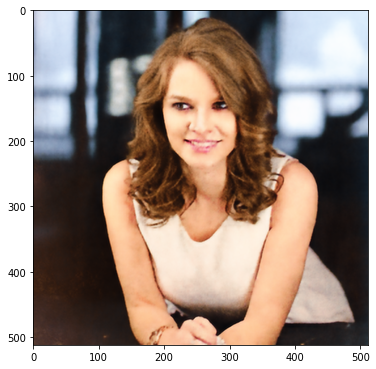

Iteration 01601    Loss 0.000460Iteration 01602    Loss 0.000445Iteration 01603    Loss 0.000467Iteration 01604    Loss 0.000443Iteration 01605    Loss 0.000462Iteration 01606    Loss 0.000469Iteration 01607    Loss 0.000472Iteration 01608    Loss 0.000467Iteration 01609    Loss 0.000461Iteration 01610    Loss 0.000470Iteration 01611    Loss 0.000464Iteration 01612    Loss 0.000479Iteration 01613    Loss 0.000477Iteration 01614    Loss 0.000445Iteration 01615    Loss 0.000475Iteration 01616    Loss 0.000511Iteration 01617    Loss 0.000442Iteration 01618    Loss 0.000488Iteration 01619    Loss 0.000491Iteration 01620    Loss 0.000463Iteration 01621    Loss 0.000485Iteration 01622    Loss 0.000473Iteration 01623    Loss 0.000461Iteration 01624    Loss 0.000473Iteration 01625    Loss 0.000459Iteration 01626    Loss 0.000452Iteration 01627    Loss 0.000472Iteration 01628    Loss 0.000440Iteration 01629    Loss 0.000439Iteration 01630    Loss 0.000467Iteration 01631    Loss 0.000441Iteratio

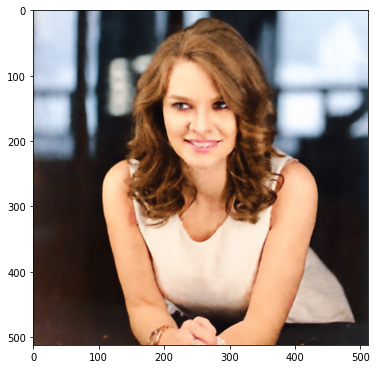

Iteration 01651    Loss 0.000470Iteration 01652    Loss 0.000434Iteration 01653    Loss 0.000466Iteration 01654    Loss 0.000448Iteration 01655    Loss 0.000444Iteration 01656    Loss 0.000441Iteration 01657    Loss 0.000431Iteration 01658    Loss 0.000449Iteration 01659    Loss 0.000444Iteration 01660    Loss 0.000444Iteration 01661    Loss 0.000437Iteration 01662    Loss 0.000446Iteration 01663    Loss 0.000464Iteration 01664    Loss 0.000431Iteration 01665    Loss 0.000465Iteration 01666    Loss 0.000452Iteration 01667    Loss 0.000423Iteration 01668    Loss 0.000435Iteration 01669    Loss 0.000443Iteration 01670    Loss 0.000442Iteration 01671    Loss 0.000408Iteration 01672    Loss 0.000430Iteration 01673    Loss 0.000427Iteration 01674    Loss 0.000428Iteration 01675    Loss 0.000424Iteration 01676    Loss 0.000458Iteration 01677    Loss 0.000458Iteration 01678    Loss 0.000425Iteration 01679    Loss 0.000431Iteration 01680    Loss 0.000457Iteration 01681    Loss 0.000437Iteratio

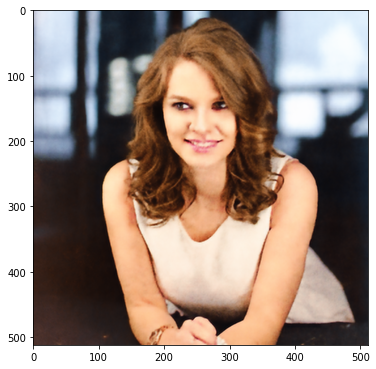

Iteration 01701    Loss 0.000431Iteration 01702    Loss 0.000442Iteration 01703    Loss 0.000454Iteration 01704    Loss 0.000459Iteration 01705    Loss 0.000434Iteration 01706    Loss 0.000432Iteration 01707    Loss 0.000449Iteration 01708    Loss 0.000424Iteration 01709    Loss 0.000446Iteration 01710    Loss 0.000457Iteration 01711    Loss 0.000456Iteration 01712    Loss 0.000425Iteration 01713    Loss 0.000478Iteration 01714    Loss 0.000454Iteration 01715    Loss 0.000421Iteration 01716    Loss 0.000449Iteration 01717    Loss 0.000429Iteration 01718    Loss 0.000438Iteration 01719    Loss 0.000423Iteration 01720    Loss 0.000424Iteration 01721    Loss 0.000421Iteration 01722    Loss 0.000433Iteration 01723    Loss 0.000411Iteration 01724    Loss 0.000424Iteration 01725    Loss 0.000452Iteration 01726    Loss 0.000451Iteration 01727    Loss 0.000407Iteration 01728    Loss 0.000454Iteration 01729    Loss 0.000459Iteration 01730    Loss 0.000428Iteration 01731    Loss 0.000452Iteratio

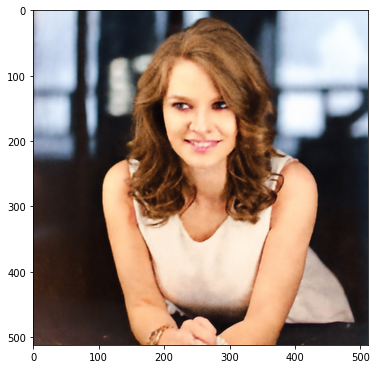

Iteration 01751    Loss 0.000404Iteration 01752    Loss 0.000412Iteration 01753    Loss 0.000410Iteration 01754    Loss 0.000401Iteration 01755    Loss 0.000403Iteration 01756    Loss 0.000392Iteration 01757    Loss 0.000393Iteration 01758    Loss 0.000409Iteration 01759    Loss 0.000403Iteration 01760    Loss 0.000397Iteration 01761    Loss 0.000408Iteration 01762    Loss 0.000408Iteration 01763    Loss 0.000408Iteration 01764    Loss 0.000400Iteration 01765    Loss 0.000412Iteration 01766    Loss 0.000404Iteration 01767    Loss 0.000406Iteration 01768    Loss 0.000407Iteration 01769    Loss 0.000410Iteration 01770    Loss 0.000411Iteration 01771    Loss 0.000410Iteration 01772    Loss 0.000419Iteration 01773    Loss 0.000407Iteration 01774    Loss 0.000405Iteration 01775    Loss 0.000415Iteration 01776    Loss 0.000407Iteration 01777    Loss 0.000412Iteration 01778    Loss 0.000400Iteration 01779    Loss 0.000420Iteration 01780    Loss 0.000402Iteration 01781    Loss 0.000411Iteratio

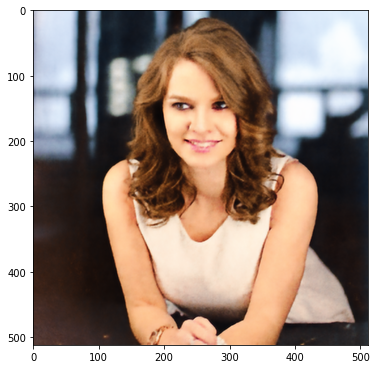

Iteration 01801    Loss 0.000415Iteration 01802    Loss 0.000399Iteration 01803    Loss 0.000413Iteration 01804    Loss 0.000421Iteration 01805    Loss 0.000405Iteration 01806    Loss 0.000438Iteration 01807    Loss 0.000431Iteration 01808    Loss 0.000423Iteration 01809    Loss 0.000417Iteration 01810    Loss 0.000433Iteration 01811    Loss 0.000433Iteration 01812    Loss 0.000418Iteration 01813    Loss 0.000458Iteration 01814    Loss 0.000431Iteration 01815    Loss 0.000404Iteration 01816    Loss 0.000438Iteration 01817    Loss 0.000433Iteration 01818    Loss 0.000383Iteration 01819    Loss 0.000412Iteration 01820    Loss 0.000394Iteration 01821    Loss 0.000397Iteration 01822    Loss 0.000403Iteration 01823    Loss 0.000406Iteration 01824    Loss 0.000417Iteration 01825    Loss 0.000406Iteration 01826    Loss 0.000403Iteration 01827    Loss 0.000418Iteration 01828    Loss 0.000402Iteration 01829    Loss 0.000432Iteration 01830    Loss 0.000418Iteration 01831    Loss 0.000395Iteratio

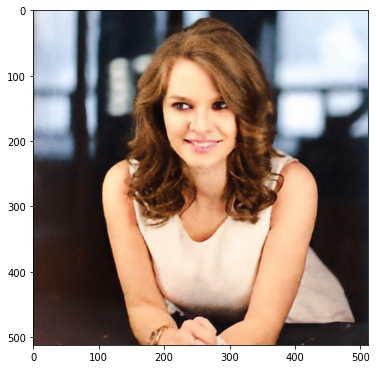

Iteration 01851    Loss 0.000387Iteration 01852    Loss 0.000427Iteration 01853    Loss 0.000475Iteration 01854    Loss 0.000432Iteration 01855    Loss 0.000415Iteration 01856    Loss 0.000428Iteration 01857    Loss 0.000407Iteration 01858    Loss 0.000401Iteration 01859    Loss 0.000459Iteration 01860    Loss 0.000416Iteration 01861    Loss 0.000402Iteration 01862    Loss 0.000466Iteration 01863    Loss 0.000415Iteration 01864    Loss 0.000401Iteration 01865    Loss 0.000434Iteration 01866    Loss 0.000424Iteration 01867    Loss 0.000408Iteration 01868    Loss 0.000386Iteration 01869    Loss 0.000393Iteration 01870    Loss 0.000381Iteration 01871    Loss 0.000422Iteration 01872    Loss 0.000408Iteration 01873    Loss 0.000385Iteration 01874    Loss 0.000416Iteration 01875    Loss 0.000429Iteration 01876    Loss 0.000378Iteration 01877    Loss 0.000408Iteration 01878    Loss 0.000405Iteration 01879    Loss 0.000378Iteration 01880    Loss 0.000401Iteration 01881    Loss 0.000391Iteratio

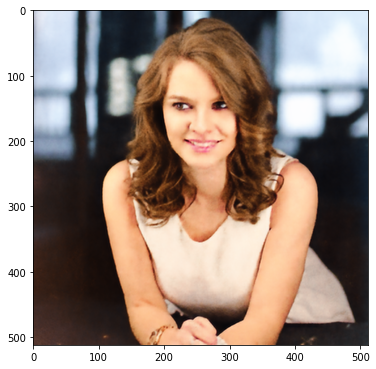

Iteration 01901    Loss 0.000387Iteration 01902    Loss 0.000399Iteration 01903    Loss 0.000417Iteration 01904    Loss 0.000369Iteration 01905    Loss 0.000416Iteration 01906    Loss 0.000411Iteration 01907    Loss 0.000405Iteration 01908    Loss 0.000419Iteration 01909    Loss 0.000423Iteration 01910    Loss 0.000397Iteration 01911    Loss 0.000405Iteration 01912    Loss 0.000405Iteration 01913    Loss 0.000393Iteration 01914    Loss 0.000400Iteration 01915    Loss 0.000399Iteration 01916    Loss 0.000378Iteration 01917    Loss 0.000438Iteration 01918    Loss 0.000412Iteration 01919    Loss 0.000379Iteration 01920    Loss 0.000392Iteration 01921    Loss 0.000375Iteration 01922    Loss 0.000421Iteration 01923    Loss 0.000384Iteration 01924    Loss 0.000397Iteration 01925    Loss 0.000443Iteration 01926    Loss 0.000408Iteration 01927    Loss 0.000361Iteration 01928    Loss 0.000402Iteration 01929    Loss 0.000389Iteration 01930    Loss 0.000393Iteration 01931    Loss 0.000379Iteratio

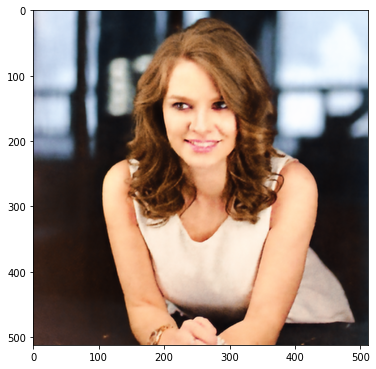

Iteration 01951    Loss 0.000398Iteration 01952    Loss 0.000446Iteration 01953    Loss 0.000407Iteration 01954    Loss 0.000390Iteration 01955    Loss 0.000470Iteration 01956    Loss 0.000413Iteration 01957    Loss 0.000377Iteration 01958    Loss 0.000401Iteration 01959    Loss 0.000375Iteration 01960    Loss 0.000381Iteration 01961    Loss 0.000417Iteration 01962    Loss 0.000363Iteration 01963    Loss 0.000396Iteration 01964    Loss 0.000399Iteration 01965    Loss 0.000364Iteration 01966    Loss 0.000396Iteration 01967    Loss 0.000367Iteration 01968    Loss 0.000377Iteration 01969    Loss 0.000395Iteration 01970    Loss 0.000361Iteration 01971    Loss 0.000386Iteration 01972    Loss 0.000383Iteration 01973    Loss 0.000355Iteration 01974    Loss 0.000381Iteration 01975    Loss 0.000363Iteration 01976    Loss 0.000377Iteration 01977    Loss 0.000378Iteration 01978    Loss 0.000358Iteration 01979    Loss 0.000368Iteration 01980    Loss 0.000381Iteration 01981    Loss 0.000380Iteratio

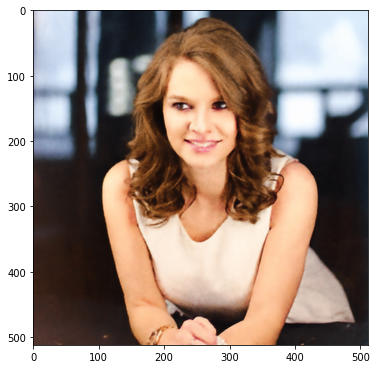

Iteration 02001    Loss 0.000401Iteration 02002    Loss 0.000386Iteration 02003    Loss 0.000364Iteration 02004    Loss 0.000391Iteration 02005    Loss 0.000398Iteration 02006    Loss 0.000380Iteration 02007    Loss 0.000376Iteration 02008    Loss 0.000368Iteration 02009    Loss 0.000384Iteration 02010    Loss 0.000373Iteration 02011    Loss 0.000382Iteration 02012    Loss 0.000374Iteration 02013    Loss 0.000355Iteration 02014    Loss 0.000377Iteration 02015    Loss 0.000354Iteration 02016    Loss 0.000379Iteration 02017    Loss 0.000378Iteration 02018    Loss 0.000356Iteration 02019    Loss 0.000411Iteration 02020    Loss 0.000349Iteration 02021    Loss 0.000383Iteration 02022    Loss 0.000375Iteration 02023    Loss 0.000356Iteration 02024    Loss 0.000378Iteration 02025    Loss 0.000379Iteration 02026    Loss 0.000362Iteration 02027    Loss 0.000384Iteration 02028    Loss 0.000409Iteration 02029    Loss 0.000369Iteration 02030    Loss 0.000366Iteration 02031    Loss 0.000396Iteratio

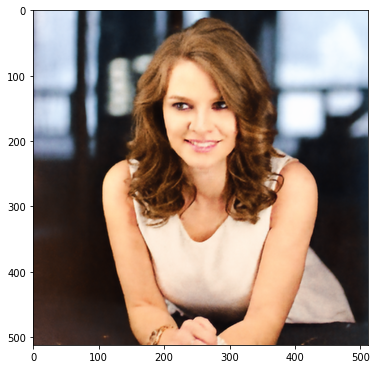

Iteration 02051    Loss 0.000351Iteration 02052    Loss 0.000358Iteration 02053    Loss 0.000351Iteration 02054    Loss 0.000354Iteration 02055    Loss 0.000360Iteration 02056    Loss 0.000348Iteration 02057    Loss 0.000350Iteration 02058    Loss 0.000370Iteration 02059    Loss 0.000347Iteration 02060    Loss 0.000346Iteration 02061    Loss 0.000375Iteration 02062    Loss 0.000348Iteration 02063    Loss 0.000369Iteration 02064    Loss 0.000353Iteration 02065    Loss 0.000347Iteration 02066    Loss 0.000380Iteration 02067    Loss 0.000351Iteration 02068    Loss 0.000339Iteration 02069    Loss 0.000359Iteration 02070    Loss 0.000350Iteration 02071    Loss 0.000344Iteration 02072    Loss 0.000347Iteration 02073    Loss 0.000347Iteration 02074    Loss 0.000346Iteration 02075    Loss 0.000347Iteration 02076    Loss 0.000356Iteration 02077    Loss 0.000353Iteration 02078    Loss 0.000348Iteration 02079    Loss 0.000346Iteration 02080    Loss 0.000357Iteration 02081    Loss 0.000361Iteratio

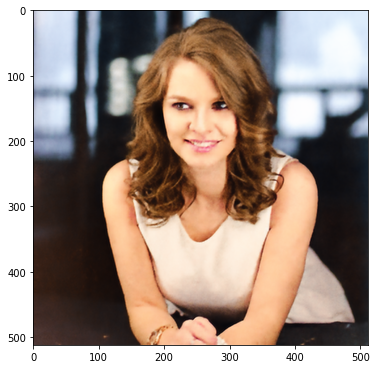

Iteration 02101    Loss 0.000337Iteration 02102    Loss 0.000340Iteration 02103    Loss 0.000333Iteration 02104    Loss 0.000345Iteration 02105    Loss 0.000348Iteration 02106    Loss 0.000342Iteration 02107    Loss 0.000338Iteration 02108    Loss 0.000336Iteration 02109    Loss 0.000350Iteration 02110    Loss 0.000337Iteration 02111    Loss 0.000332Iteration 02112    Loss 0.000335Iteration 02113    Loss 0.000334Iteration 02114    Loss 0.000329Iteration 02115    Loss 0.000335Iteration 02116    Loss 0.000342Iteration 02117    Loss 0.000334Iteration 02118    Loss 0.000335Iteration 02119    Loss 0.000357Iteration 02120    Loss 0.000360Iteration 02121    Loss 0.000352Iteration 02122    Loss 0.000337Iteration 02123    Loss 0.000360Iteration 02124    Loss 0.000357Iteration 02125    Loss 0.000349Iteration 02126    Loss 0.000352Iteration 02127    Loss 0.000374Iteration 02128    Loss 0.000402Iteration 02129    Loss 0.000381Iteration 02130    Loss 0.000349Iteration 02131    Loss 0.000338Iteratio

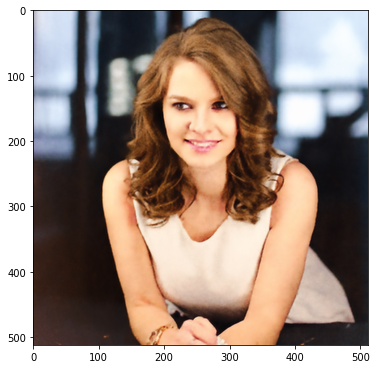

Iteration 02151    Loss 0.000334Iteration 02152    Loss 0.000328Iteration 02153    Loss 0.000339Iteration 02154    Loss 0.000340Iteration 02155    Loss 0.000358Iteration 02156    Loss 0.000338Iteration 02157    Loss 0.000344Iteration 02158    Loss 0.000360Iteration 02159    Loss 0.000394Iteration 02160    Loss 0.000360Iteration 02161    Loss 0.000330Iteration 02162    Loss 0.000345Iteration 02163    Loss 0.000356Iteration 02164    Loss 0.000352Iteration 02165    Loss 0.000364Iteration 02166    Loss 0.000343Iteration 02167    Loss 0.000339Iteration 02168    Loss 0.000343Iteration 02169    Loss 0.000347Iteration 02170    Loss 0.000371Iteration 02171    Loss 0.000356Iteration 02172    Loss 0.000342Iteration 02173    Loss 0.000384Iteration 02174    Loss 0.000388Iteration 02175    Loss 0.000331Iteration 02176    Loss 0.000362Iteration 02177    Loss 0.000364Iteration 02178    Loss 0.000329Iteration 02179    Loss 0.000340Iteration 02180    Loss 0.000357Iteration 02181    Loss 0.000344Iteratio

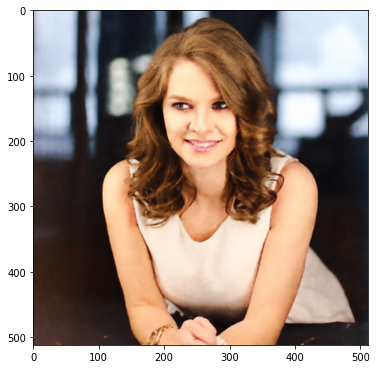

Iteration 02201    Loss 0.000382Iteration 02202    Loss 0.000333Iteration 02203    Loss 0.000353Iteration 02204    Loss 0.000367Iteration 02205    Loss 0.000350Iteration 02206    Loss 0.000339Iteration 02207    Loss 0.000339Iteration 02208    Loss 0.000348Iteration 02209    Loss 0.000338Iteration 02210    Loss 0.000334Iteration 02211    Loss 0.000333Iteration 02212    Loss 0.000352Iteration 02213    Loss 0.000324Iteration 02214    Loss 0.000338Iteration 02215    Loss 0.000334Iteration 02216    Loss 0.000319Iteration 02217    Loss 0.000322Iteration 02218    Loss 0.000326Iteration 02219    Loss 0.000330Iteration 02220    Loss 0.000317Iteration 02221    Loss 0.000332Iteration 02222    Loss 0.000332Iteration 02223    Loss 0.000322Iteration 02224    Loss 0.000333Iteration 02225    Loss 0.000337Iteration 02226    Loss 0.000320Iteration 02227    Loss 0.000328Iteration 02228    Loss 0.000327Iteration 02229    Loss 0.000316Iteration 02230    Loss 0.000331Iteration 02231    Loss 0.000328Iteratio

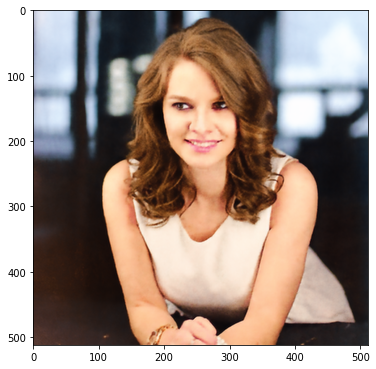

Iteration 02251    Loss 0.000329Iteration 02252    Loss 0.000321Iteration 02253    Loss 0.000322Iteration 02254    Loss 0.000324Iteration 02255    Loss 0.000310Iteration 02256    Loss 0.000318Iteration 02257    Loss 0.000329Iteration 02258    Loss 0.000320Iteration 02259    Loss 0.000313Iteration 02260    Loss 0.000325Iteration 02261    Loss 0.000335Iteration 02262    Loss 0.000335Iteration 02263    Loss 0.000322Iteration 02264    Loss 0.000329Iteration 02265    Loss 0.000340Iteration 02266    Loss 0.000322Iteration 02267    Loss 0.000314Iteration 02268    Loss 0.000333Iteration 02269    Loss 0.000322Iteration 02270    Loss 0.000302Iteration 02271    Loss 0.000331Iteration 02272    Loss 0.000328Iteration 02273    Loss 0.000310Iteration 02274    Loss 0.000328Iteration 02275    Loss 0.000326Iteration 02276    Loss 0.000313Iteration 02277    Loss 0.000331Iteration 02278    Loss 0.000313Iteration 02279    Loss 0.000326Iteration 02280    Loss 0.000324Iteration 02281    Loss 0.000309Iteratio

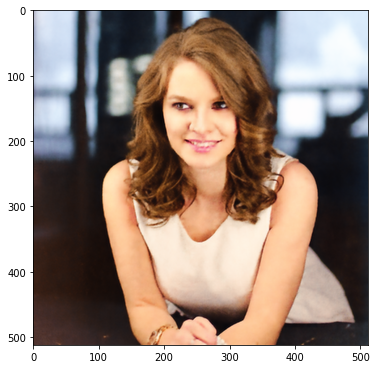

Iteration 02301    Loss 0.000305Iteration 02302    Loss 0.000314Iteration 02303    Loss 0.000321Iteration 02304    Loss 0.000305Iteration 02305    Loss 0.000329Iteration 02306    Loss 0.000323Iteration 02307    Loss 0.000303Iteration 02308    Loss 0.000325Iteration 02309    Loss 0.000306Iteration 02310    Loss 0.000343Iteration 02311    Loss 0.000350Iteration 02312    Loss 0.000323Iteration 02313    Loss 0.000310Iteration 02314    Loss 0.000337Iteration 02315    Loss 0.000319Iteration 02316    Loss 0.000318Iteration 02317    Loss 0.000319Iteration 02318    Loss 0.000306Iteration 02319    Loss 0.000308Iteration 02320    Loss 0.000318Iteration 02321    Loss 0.000305Iteration 02322    Loss 0.000310Iteration 02323    Loss 0.000340Iteration 02324    Loss 0.000304Iteration 02325    Loss 0.000332Iteration 02326    Loss 0.000336Iteration 02327    Loss 0.000312Iteration 02328    Loss 0.000328Iteration 02329    Loss 0.000328Iteration 02330    Loss 0.000305Iteration 02331    Loss 0.000350Iteratio

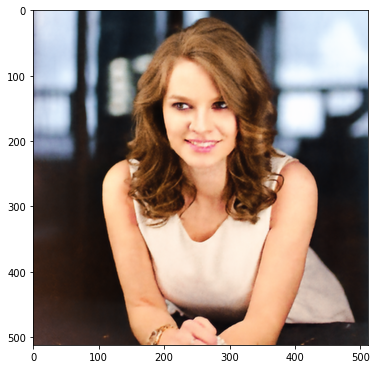

Iteration 02351    Loss 0.000306Iteration 02352    Loss 0.000303Iteration 02353    Loss 0.000305Iteration 02354    Loss 0.000298Iteration 02355    Loss 0.000299Iteration 02356    Loss 0.000300Iteration 02357    Loss 0.000301Iteration 02358    Loss 0.000303Iteration 02359    Loss 0.000300Iteration 02360    Loss 0.000302Iteration 02361    Loss 0.000304Iteration 02362    Loss 0.000304Iteration 02363    Loss 0.000309Iteration 02364    Loss 0.000308Iteration 02365    Loss 0.000311Iteration 02366    Loss 0.000306Iteration 02367    Loss 0.000311Iteration 02368    Loss 0.000308Iteration 02369    Loss 0.000294Iteration 02370    Loss 0.000309Iteration 02371    Loss 0.000306Iteration 02372    Loss 0.000307Iteration 02373    Loss 0.000302Iteration 02374    Loss 0.000302Iteration 02375    Loss 0.000303Iteration 02376    Loss 0.000297Iteration 02377    Loss 0.000321Iteration 02378    Loss 0.000314Iteration 02379    Loss 0.000293Iteration 02380    Loss 0.000293Iteration 02381    Loss 0.000312Iteratio

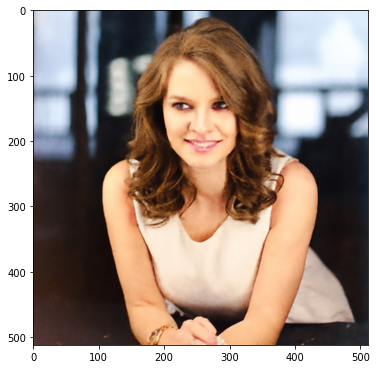

Iteration 02401    Loss 0.000337Iteration 02402    Loss 0.000307Iteration 02403    Loss 0.000315Iteration 02404    Loss 0.000356Iteration 02405    Loss 0.000315Iteration 02406    Loss 0.000310Iteration 02407    Loss 0.000358Iteration 02408    Loss 0.000345Iteration 02409    Loss 0.000300Iteration 02410    Loss 0.000337Iteration 02411    Loss 0.000338Iteration 02412    Loss 0.000335Iteration 02413    Loss 0.000324Iteration 02414    Loss 0.000350Iteration 02415    Loss 0.000345Iteration 02416    Loss 0.000300Iteration 02417    Loss 0.000339Iteration 02418    Loss 0.000314Iteration 02419    Loss 0.000321Iteration 02420    Loss 0.000368Iteration 02421    Loss 0.000310Iteration 02422    Loss 0.000315Iteration 02423    Loss 0.000362Iteration 02424    Loss 0.000297Iteration 02425    Loss 0.000338Iteration 02426    Loss 0.000371Iteration 02427    Loss 0.000317Iteration 02428    Loss 0.000328Iteration 02429    Loss 0.000354Iteration 02430    Loss 0.000330Iteration 02431    Loss 0.000301Iteratio

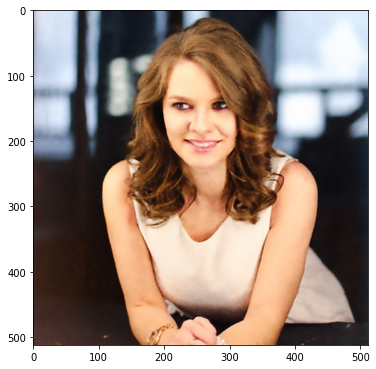

Iteration 02451    Loss 0.000302Iteration 02452    Loss 0.000288Iteration 02453    Loss 0.000312Iteration 02454    Loss 0.000312Iteration 02455    Loss 0.000291Iteration 02456    Loss 0.000320Iteration 02457    Loss 0.000320Iteration 02458    Loss 0.000290Iteration 02459    Loss 0.000301Iteration 02460    Loss 0.000307Iteration 02461    Loss 0.000289Iteration 02462    Loss 0.000316Iteration 02463    Loss 0.000301Iteration 02464    Loss 0.000295Iteration 02465    Loss 0.000305Iteration 02466    Loss 0.000295Iteration 02467    Loss 0.000295Iteration 02468    Loss 0.000309Iteration 02469    Loss 0.000288Iteration 02470    Loss 0.000300Iteration 02471    Loss 0.000302Iteration 02472    Loss 0.000293Iteration 02473    Loss 0.000303Iteration 02474    Loss 0.000288Iteration 02475    Loss 0.000300Iteration 02476    Loss 0.000283Iteration 02477    Loss 0.000301Iteration 02478    Loss 0.000312Iteration 02479    Loss 0.000302Iteration 02480    Loss 0.000285Iteration 02481    Loss 0.000279Iteratio

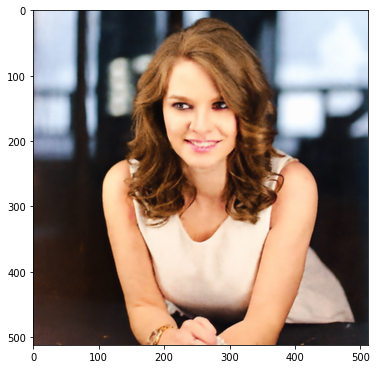

Iteration 02501    Loss 0.000282Iteration 02502    Loss 0.000288Iteration 02503    Loss 0.000308Iteration 02504    Loss 0.000309Iteration 02505    Loss 0.000294Iteration 02506    Loss 0.000289Iteration 02507    Loss 0.000309Iteration 02508    Loss 0.000343Iteration 02509    Loss 0.000343Iteration 02510    Loss 0.000318Iteration 02511    Loss 0.000312Iteration 02512    Loss 0.000335Iteration 02513    Loss 0.000328Iteration 02514    Loss 0.000283Iteration 02515    Loss 0.000324Iteration 02516    Loss 0.000320Iteration 02517    Loss 0.000289Iteration 02518    Loss 0.000306Iteration 02519    Loss 0.000302Iteration 02520    Loss 0.000306Iteration 02521    Loss 0.000299Iteration 02522    Loss 0.000293Iteration 02523    Loss 0.000304Iteration 02524    Loss 0.000282Iteration 02525    Loss 0.000277Iteration 02526    Loss 0.000288Iteration 02527    Loss 0.000286Iteration 02528    Loss 0.000276Iteration 02529    Loss 0.000285Iteration 02530    Loss 0.000281Iteration 02531    Loss 0.000280Iteratio

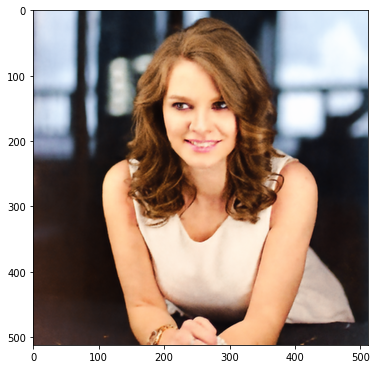

Iteration 02551    Loss 0.000291Iteration 02552    Loss 0.000297Iteration 02553    Loss 0.000284Iteration 02554    Loss 0.000271Iteration 02555    Loss 0.000302Iteration 02556    Loss 0.000297Iteration 02557    Loss 0.000283Iteration 02558    Loss 0.000296Iteration 02559    Loss 0.000283Iteration 02560    Loss 0.000285Iteration 02561    Loss 0.000295Iteration 02562    Loss 0.000286Iteration 02563    Loss 0.000285Iteration 02564    Loss 0.000290Iteration 02565    Loss 0.000280Iteration 02566    Loss 0.000280Iteration 02567    Loss 0.000289Iteration 02568    Loss 0.000292Iteration 02569    Loss 0.000279Iteration 02570    Loss 0.000265Iteration 02571    Loss 0.000286Iteration 02572    Loss 0.000282Iteration 02573    Loss 0.000275Iteration 02574    Loss 0.000281Iteration 02575    Loss 0.000281Iteration 02576    Loss 0.000275Iteration 02577    Loss 0.000275Iteration 02578    Loss 0.000290Iteration 02579    Loss 0.000278Iteration 02580    Loss 0.000276Iteration 02581    Loss 0.000287Iteratio

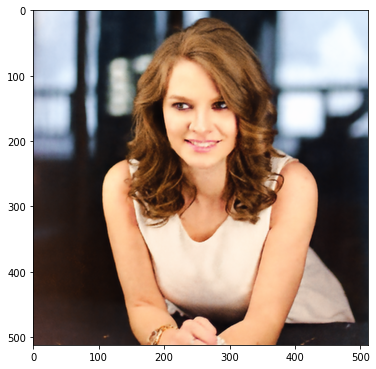

Iteration 02601    Loss 0.000268Iteration 02602    Loss 0.000273Iteration 02603    Loss 0.000276Iteration 02604    Loss 0.000270Iteration 02605    Loss 0.000271Iteration 02606    Loss 0.000267Iteration 02607    Loss 0.000277Iteration 02608    Loss 0.000290Iteration 02609    Loss 0.000276Iteration 02610    Loss 0.000300Iteration 02611    Loss 0.000286Iteration 02612    Loss 0.000314Iteration 02613    Loss 0.000307Iteration 02614    Loss 0.000293Iteration 02615    Loss 0.000271Iteration 02616    Loss 0.000300Iteration 02617    Loss 0.000272Iteration 02618    Loss 0.000283Iteration 02619    Loss 0.000281Iteration 02620    Loss 0.000279Iteration 02621    Loss 0.000290Iteration 02622    Loss 0.000273Iteration 02623    Loss 0.000280Iteration 02624    Loss 0.000275Iteration 02625    Loss 0.000278Iteration 02626    Loss 0.000276Iteration 02627    Loss 0.000271Iteration 02628    Loss 0.000292Iteration 02629    Loss 0.000296Iteration 02630    Loss 0.000306Iteration 02631    Loss 0.000281Iteratio

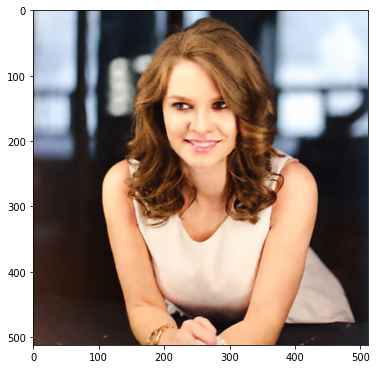

Iteration 02651    Loss 0.000269Iteration 02652    Loss 0.000263Iteration 02653    Loss 0.000273Iteration 02654    Loss 0.000285Iteration 02655    Loss 0.000277Iteration 02656    Loss 0.000270Iteration 02657    Loss 0.000264Iteration 02658    Loss 0.000271Iteration 02659    Loss 0.000267Iteration 02660    Loss 0.000261Iteration 02661    Loss 0.000288Iteration 02662    Loss 0.000290Iteration 02663    Loss 0.000268Iteration 02664    Loss 0.000268Iteration 02665    Loss 0.000262Iteration 02666    Loss 0.000281Iteration 02667    Loss 0.000288Iteration 02668    Loss 0.000270Iteration 02669    Loss 0.000277Iteration 02670    Loss 0.000315Iteration 02671    Loss 0.000321Iteration 02672    Loss 0.000288Iteration 02673    Loss 0.000263Iteration 02674    Loss 0.000268Iteration 02675    Loss 0.000303Iteration 02676    Loss 0.000286Iteration 02677    Loss 0.000262Iteration 02678    Loss 0.000308Iteration 02679    Loss 0.000332Iteration 02680    Loss 0.000283Iteration 02681    Loss 0.000268Iteratio

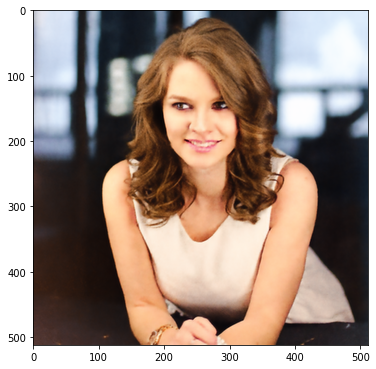

Iteration 02701    Loss 0.000262Iteration 02702    Loss 0.000279Iteration 02703    Loss 0.000289Iteration 02704    Loss 0.000266Iteration 02705    Loss 0.000271Iteration 02706    Loss 0.000270Iteration 02707    Loss 0.000269Iteration 02708    Loss 0.000264Iteration 02709    Loss 0.000270Iteration 02710    Loss 0.000272Iteration 02711    Loss 0.000265Iteration 02712    Loss 0.000264Iteration 02713    Loss 0.000276Iteration 02714    Loss 0.000267Iteration 02715    Loss 0.000264Iteration 02716    Loss 0.000257Iteration 02717    Loss 0.000260Iteration 02718    Loss 0.000258Iteration 02719    Loss 0.000261Iteration 02720    Loss 0.000275Iteration 02721    Loss 0.000274Iteration 02722    Loss 0.000255Iteration 02723    Loss 0.000264Iteration 02724    Loss 0.000265Iteration 02725    Loss 0.000268Iteration 02726    Loss 0.000261Iteration 02727    Loss 0.000256Iteration 02728    Loss 0.000269Iteration 02729    Loss 0.000263Iteration 02730    Loss 0.000261Iteration 02731    Loss 0.000256Iteratio

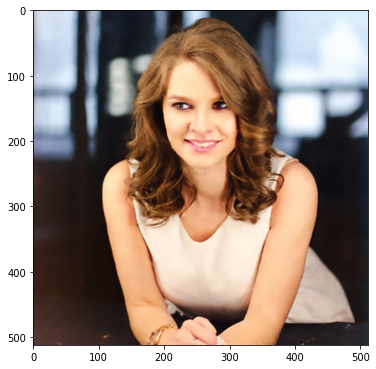

Iteration 02751    Loss 0.000263Iteration 02752    Loss 0.000257Iteration 02753    Loss 0.000252Iteration 02754    Loss 0.000252Iteration 02755    Loss 0.000250Iteration 02756    Loss 0.000262Iteration 02757    Loss 0.000251Iteration 02758    Loss 0.000257Iteration 02759    Loss 0.000259Iteration 02760    Loss 0.000260Iteration 02761    Loss 0.000256Iteration 02762    Loss 0.000258Iteration 02763    Loss 0.000267Iteration 02764    Loss 0.000263Iteration 02765    Loss 0.000252Iteration 02766    Loss 0.000254Iteration 02767    Loss 0.000263Iteration 02768    Loss 0.000250Iteration 02769    Loss 0.000248Iteration 02770    Loss 0.000259Iteration 02771    Loss 0.000258Iteration 02772    Loss 0.000254Iteration 02773    Loss 0.000257Iteration 02774    Loss 0.000256Iteration 02775    Loss 0.000251Iteration 02776    Loss 0.000258Iteration 02777    Loss 0.000264Iteration 02778    Loss 0.000250Iteration 02779    Loss 0.000264Iteration 02780    Loss 0.000265Iteration 02781    Loss 0.000253Iteratio

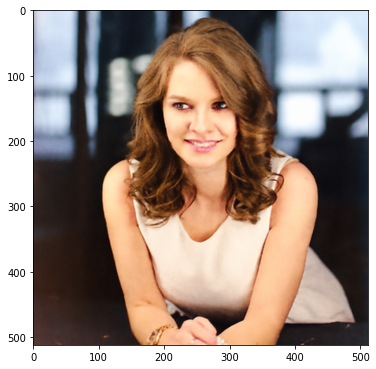

Iteration 02801    Loss 0.000252Iteration 02802    Loss 0.000271Iteration 02803    Loss 0.000261Iteration 02804    Loss 0.000261Iteration 02805    Loss 0.000257Iteration 02806    Loss 0.000256Iteration 02807    Loss 0.000250Iteration 02808    Loss 0.000252Iteration 02809    Loss 0.000271Iteration 02810    Loss 0.000288Iteration 02811    Loss 0.000274Iteration 02812    Loss 0.000260Iteration 02813    Loss 0.000263Iteration 02814    Loss 0.000257Iteration 02815    Loss 0.000262Iteration 02816    Loss 0.000261Iteration 02817    Loss 0.000253Iteration 02818    Loss 0.000255Iteration 02819    Loss 0.000261Iteration 02820    Loss 0.000275Iteration 02821    Loss 0.000272Iteration 02822    Loss 0.000249Iteration 02823    Loss 0.000269Iteration 02824    Loss 0.000273Iteration 02825    Loss 0.000258Iteration 02826    Loss 0.000288Iteration 02827    Loss 0.000303Iteration 02828    Loss 0.000265Iteration 02829    Loss 0.000259Iteration 02830    Loss 0.000284Iteration 02831    Loss 0.000278Iteratio

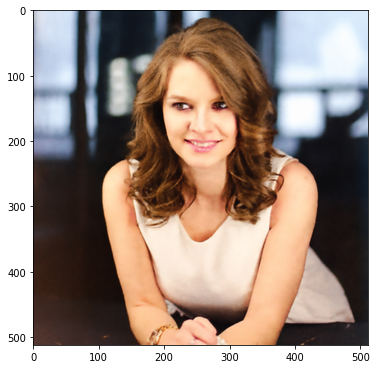

Iteration 02851    Loss 0.000280Iteration 02852    Loss 0.000275Iteration 02853    Loss 0.000250Iteration 02854    Loss 0.000245Iteration 02855    Loss 0.000264Iteration 02856    Loss 0.000266Iteration 02857    Loss 0.000251Iteration 02858    Loss 0.000246Iteration 02859    Loss 0.000264Iteration 02860    Loss 0.000258Iteration 02861    Loss 0.000253Iteration 02862    Loss 0.000257Iteration 02863    Loss 0.000280Iteration 02864    Loss 0.000292Iteration 02865    Loss 0.000252Iteration 02866    Loss 0.000244Iteration 02867    Loss 0.000269Iteration 02868    Loss 0.000255Iteration 02869    Loss 0.000245Iteration 02870    Loss 0.000287Iteration 02871    Loss 0.000295Iteration 02872    Loss 0.000259Iteration 02873    Loss 0.000260Iteration 02874    Loss 0.000266Iteration 02875    Loss 0.000272Iteration 02876    Loss 0.000281Iteration 02877    Loss 0.000269Iteration 02878    Loss 0.000257Iteration 02879    Loss 0.000287Iteration 02880    Loss 0.000283Iteration 02881    Loss 0.000246Iteratio

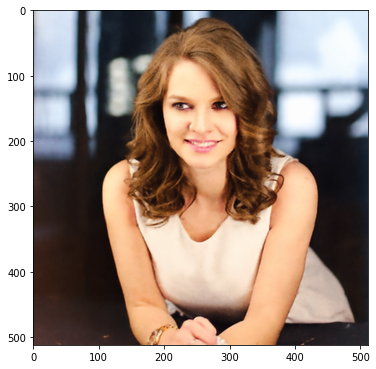

Iteration 02901    Loss 0.000250Iteration 02902    Loss 0.000243Iteration 02903    Loss 0.000260Iteration 02904    Loss 0.000271Iteration 02905    Loss 0.000260Iteration 02906    Loss 0.000247Iteration 02907    Loss 0.000253Iteration 02908    Loss 0.000239Iteration 02909    Loss 0.000247Iteration 02910    Loss 0.000241Iteration 02911    Loss 0.000253Iteration 02912    Loss 0.000252Iteration 02913    Loss 0.000243Iteration 02914    Loss 0.000237Iteration 02915    Loss 0.000251Iteration 02916    Loss 0.000256Iteration 02917    Loss 0.000258Iteration 02918    Loss 0.000244Iteration 02919    Loss 0.000248Iteration 02920    Loss 0.000239Iteration 02921    Loss 0.000254Iteration 02922    Loss 0.000266Iteration 02923    Loss 0.000254Iteration 02924    Loss 0.000240Iteration 02925    Loss 0.000245Iteration 02926    Loss 0.000260Iteration 02927    Loss 0.000251Iteration 02928    Loss 0.000238Iteration 02929    Loss 0.000243Iteration 02930    Loss 0.000249Iteration 02931    Loss 0.000251Iteratio

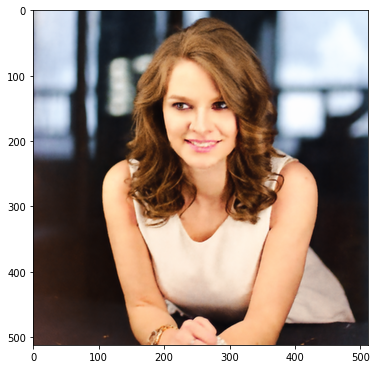

Iteration 02951    Loss 0.000239Iteration 02952    Loss 0.000238Iteration 02953    Loss 0.000238Iteration 02954    Loss 0.000235Iteration 02955    Loss 0.000237Iteration 02956    Loss 0.000233Iteration 02957    Loss 0.000232Iteration 02958    Loss 0.000236Iteration 02959    Loss 0.000229Iteration 02960    Loss 0.000239Iteration 02961    Loss 0.000240Iteration 02962    Loss 0.000250Iteration 02963    Loss 0.000243Iteration 02964    Loss 0.000238Iteration 02965    Loss 0.000243Iteration 02966    Loss 0.000247Iteration 02967    Loss 0.000245Iteration 02968    Loss 0.000239Iteration 02969    Loss 0.000235Iteration 02970    Loss 0.000234Iteration 02971    Loss 0.000237Iteration 02972    Loss 0.000237Iteration 02973    Loss 0.000239Iteration 02974    Loss 0.000248Iteration 02975    Loss 0.000251Iteration 02976    Loss 0.000251Iteration 02977    Loss 0.000243Iteration 02978    Loss 0.000236Iteration 02979    Loss 0.000233Iteration 02980    Loss 0.000240Iteration 02981    Loss 0.000231Iteratio

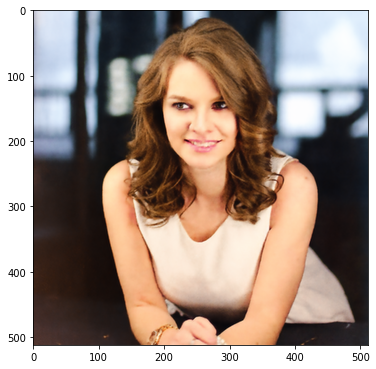

Iteration 03001    Loss 0.000245Iteration 03002    Loss 0.000241Iteration 03003    Loss 0.000245Iteration 03004    Loss 0.000262Iteration 03005    Loss 0.000249Iteration 03006    Loss 0.000236Iteration 03007    Loss 0.000263Iteration 03008    Loss 0.000263Iteration 03009    Loss 0.000238Iteration 03010    Loss 0.000256Iteration 03011    Loss 0.000281Iteration 03012    Loss 0.000242Iteration 03013    Loss 0.000236Iteration 03014    Loss 0.000276Iteration 03015    Loss 0.000274Iteration 03016    Loss 0.000243Iteration 03017    Loss 0.000235Iteration 03018    Loss 0.000269Iteration 03019    Loss 0.000323Iteration 03020    Loss 0.000313Iteration 03021    Loss 0.000257Iteration 03022    Loss 0.000231Iteration 03023    Loss 0.000258Iteration 03024    Loss 0.000263Iteration 03025    Loss 0.000241Iteration 03026    Loss 0.000228Iteration 03027    Loss 0.000242Iteration 03028    Loss 0.000240Iteration 03029    Loss 0.000228Iteration 03030    Loss 0.000232Iteration 03031    Loss 0.000232Iteratio

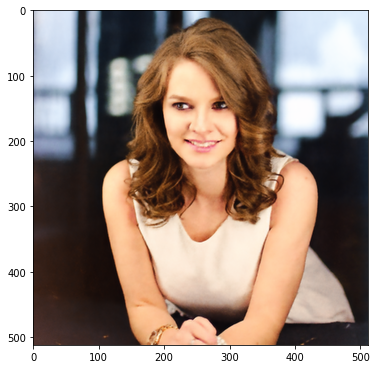

Iteration 03051    Loss 0.000229Iteration 03052    Loss 0.000239Iteration 03053    Loss 0.000225Iteration 03054    Loss 0.000223Iteration 03055    Loss 0.000237Iteration 03056    Loss 0.000252Iteration 03057    Loss 0.000237Iteration 03058    Loss 0.000227Iteration 03059    Loss 0.000243Iteration 03060    Loss 0.000266Iteration 03061    Loss 0.000243Iteration 03062    Loss 0.000227Iteration 03063    Loss 0.000241Iteration 03064    Loss 0.000256Iteration 03065    Loss 0.000254Iteration 03066    Loss 0.000253Iteration 03067    Loss 0.000229Iteration 03068    Loss 0.000259Iteration 03069    Loss 0.000275Iteration 03070    Loss 0.000230Iteration 03071    Loss 0.000233Iteration 03072    Loss 0.000265Iteration 03073    Loss 0.000255Iteration 03074    Loss 0.000235Iteration 03075    Loss 0.000238Iteration 03076    Loss 0.000253Iteration 03077    Loss 0.000252Iteration 03078    Loss 0.000229Iteration 03079    Loss 0.000231Iteration 03080    Loss 0.000253Iteration 03081    Loss 0.000252Iteratio

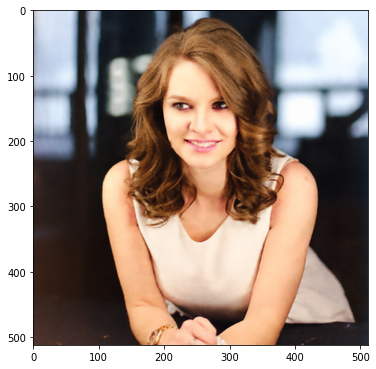

Iteration 03101    Loss 0.000264Iteration 03102    Loss 0.000236Iteration 03103    Loss 0.000228Iteration 03104    Loss 0.000234Iteration 03105    Loss 0.000231Iteration 03106    Loss 0.000225Iteration 03107    Loss 0.000230Iteration 03108    Loss 0.000231Iteration 03109    Loss 0.000219Iteration 03110    Loss 0.000230Iteration 03111    Loss 0.000227Iteration 03112    Loss 0.000222Iteration 03113    Loss 0.000233Iteration 03114    Loss 0.000233Iteration 03115    Loss 0.000226Iteration 03116    Loss 0.000247Iteration 03117    Loss 0.000239Iteration 03118    Loss 0.000226Iteration 03119    Loss 0.000234Iteration 03120    Loss 0.000246Iteration 03121    Loss 0.000228Iteration 03122    Loss 0.000227Iteration 03123    Loss 0.000235Iteration 03124    Loss 0.000213Iteration 03125    Loss 0.000225Iteration 03126    Loss 0.000228Iteration 03127    Loss 0.000226Iteration 03128    Loss 0.000238Iteration 03129    Loss 0.000227Iteration 03130    Loss 0.000223Iteration 03131    Loss 0.000229Iteratio

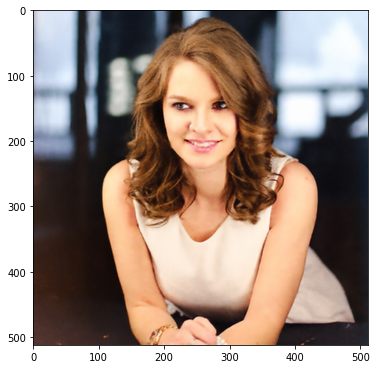

Iteration 03151    Loss 0.000230Iteration 03152    Loss 0.000258Iteration 03153    Loss 0.000255Iteration 03154    Loss 0.000226Iteration 03155    Loss 0.000233Iteration 03156    Loss 0.000261Iteration 03157    Loss 0.000255Iteration 03158    Loss 0.000239Iteration 03159    Loss 0.000233Iteration 03160    Loss 0.000256Iteration 03161    Loss 0.000245Iteration 03162    Loss 0.000225Iteration 03163    Loss 0.000231Iteration 03164    Loss 0.000251Iteration 03165    Loss 0.000241Iteration 03166    Loss 0.000235Iteration 03167    Loss 0.000233Iteration 03168    Loss 0.000248Iteration 03169    Loss 0.000263Iteration 03170    Loss 0.000229Iteration 03171    Loss 0.000216Iteration 03172    Loss 0.000226Iteration 03173    Loss 0.000219Iteration 03174    Loss 0.000222Iteration 03175    Loss 0.000225Iteration 03176    Loss 0.000234Iteration 03177    Loss 0.000262Iteration 03178    Loss 0.000254Iteration 03179    Loss 0.000215Iteration 03180    Loss 0.000241Iteration 03181    Loss 0.000239Iteratio

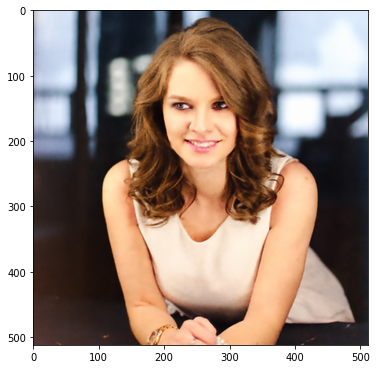

Iteration 03201    Loss 0.000222Iteration 03202    Loss 0.000222Iteration 03203    Loss 0.000244Iteration 03204    Loss 0.000217Iteration 03205    Loss 0.000239Iteration 03206    Loss 0.000278Iteration 03207    Loss 0.000264Iteration 03208    Loss 0.000228Iteration 03209    Loss 0.000225Iteration 03210    Loss 0.000223Iteration 03211    Loss 0.000219Iteration 03212    Loss 0.000222Iteration 03213    Loss 0.000243Iteration 03214    Loss 0.000239Iteration 03215    Loss 0.000227Iteration 03216    Loss 0.000218Iteration 03217    Loss 0.000226Iteration 03218    Loss 0.000236Iteration 03219    Loss 0.000223Iteration 03220    Loss 0.000217Iteration 03221    Loss 0.000220Iteration 03222    Loss 0.000213Iteration 03223    Loss 0.000214Iteration 03224    Loss 0.000217Iteration 03225    Loss 0.000213Iteration 03226    Loss 0.000214Iteration 03227    Loss 0.000215Iteration 03228    Loss 0.000218Iteration 03229    Loss 0.000213Iteration 03230    Loss 0.000220Iteration 03231    Loss 0.000231Iteratio

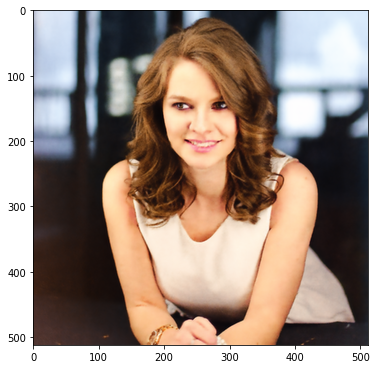

Iteration 03251    Loss 0.000214Iteration 03252    Loss 0.000225Iteration 03253    Loss 0.000220Iteration 03254    Loss 0.000213Iteration 03255    Loss 0.000220Iteration 03256    Loss 0.000236Iteration 03257    Loss 0.000215Iteration 03258    Loss 0.000218Iteration 03259    Loss 0.000218Iteration 03260    Loss 0.000220Iteration 03261    Loss 0.000219Iteration 03262    Loss 0.000227Iteration 03263    Loss 0.000216Iteration 03264    Loss 0.000219Iteration 03265    Loss 0.000213Iteration 03266    Loss 0.000225Iteration 03267    Loss 0.000215Iteration 03268    Loss 0.000221Iteration 03269    Loss 0.000237Iteration 03270    Loss 0.000232Iteration 03271    Loss 0.000212Iteration 03272    Loss 0.000213Iteration 03273    Loss 0.000235Iteration 03274    Loss 0.000232Iteration 03275    Loss 0.000237Iteration 03276    Loss 0.000229Iteration 03277    Loss 0.000223Iteration 03278    Loss 0.000212Iteration 03279    Loss 0.000223Iteration 03280    Loss 0.000208Iteration 03281    Loss 0.000221Iteratio

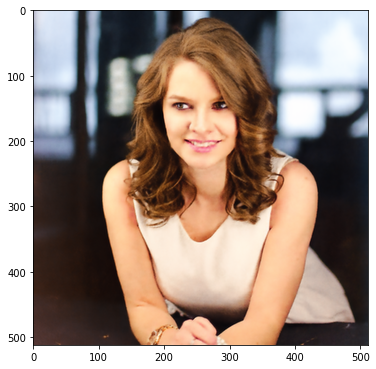

Iteration 03301    Loss 0.000211Iteration 03302    Loss 0.000211Iteration 03303    Loss 0.000219Iteration 03304    Loss 0.000214Iteration 03305    Loss 0.000209Iteration 03306    Loss 0.000207Iteration 03307    Loss 0.000212Iteration 03308    Loss 0.000219Iteration 03309    Loss 0.000217Iteration 03310    Loss 0.000210Iteration 03311    Loss 0.000206Iteration 03312    Loss 0.000211Iteration 03313    Loss 0.000217Iteration 03314    Loss 0.000215Iteration 03315    Loss 0.000205Iteration 03316    Loss 0.000215Iteration 03317    Loss 0.000214Iteration 03318    Loss 0.000210Iteration 03319    Loss 0.000205Iteration 03320    Loss 0.000214Iteration 03321    Loss 0.000222Iteration 03322    Loss 0.000223Iteration 03323    Loss 0.000211Iteration 03324    Loss 0.000202Iteration 03325    Loss 0.000213Iteration 03326    Loss 0.000236Iteration 03327    Loss 0.000234Iteration 03328    Loss 0.000211Iteration 03329    Loss 0.000201Iteration 03330    Loss 0.000219Iteration 03331    Loss 0.000222Iteratio

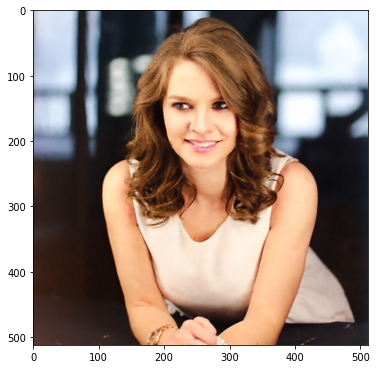

Iteration 03351    Loss 0.000218Iteration 03352    Loss 0.000219Iteration 03353    Loss 0.000220Iteration 03354    Loss 0.000234Iteration 03355    Loss 0.000231Iteration 03356    Loss 0.000217Iteration 03357    Loss 0.000199Iteration 03358    Loss 0.000208Iteration 03359    Loss 0.000222Iteration 03360    Loss 0.000209Iteration 03361    Loss 0.000201Iteration 03362    Loss 0.000230Iteration 03363    Loss 0.000255Iteration 03364    Loss 0.000250Iteration 03365    Loss 0.000233Iteration 03366    Loss 0.000230Iteration 03367    Loss 0.000249Iteration 03368    Loss 0.000291Iteration 03369    Loss 0.000291Iteration 03370    Loss 0.000218Iteration 03371    Loss 0.000221Iteration 03372    Loss 0.000286Iteration 03373    Loss 0.000292Iteration 03374    Loss 0.000218Iteration 03375    Loss 0.000237Iteration 03376    Loss 0.000300Iteration 03377    Loss 0.000297Iteration 03378    Loss 0.000226Iteration 03379    Loss 0.000259Iteration 03380    Loss 0.000267Iteration 03381    Loss 0.000263Iteratio

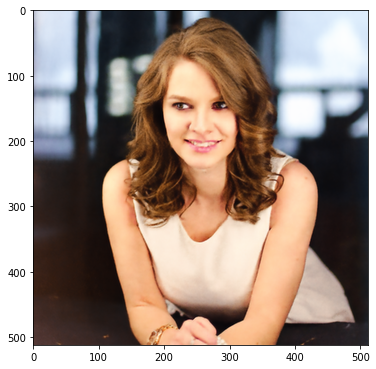

Iteration 03401    Loss 0.000206Iteration 03402    Loss 0.000205Iteration 03403    Loss 0.000206Iteration 03404    Loss 0.000209Iteration 03405    Loss 0.000198Iteration 03406    Loss 0.000200Iteration 03407    Loss 0.000204Iteration 03408    Loss 0.000202Iteration 03409    Loss 0.000208Iteration 03410    Loss 0.000209Iteration 03411    Loss 0.000201Iteration 03412    Loss 0.000205Iteration 03413    Loss 0.000208Iteration 03414    Loss 0.000216Iteration 03415    Loss 0.000202Iteration 03416    Loss 0.000201Iteration 03417    Loss 0.000216Iteration 03418    Loss 0.000202Iteration 03419    Loss 0.000201Iteration 03420    Loss 0.000211Iteration 03421    Loss 0.000201Iteration 03422    Loss 0.000216Iteration 03423    Loss 0.000223Iteration 03424    Loss 0.000205Iteration 03425    Loss 0.000201Iteration 03426    Loss 0.000232Iteration 03427    Loss 0.000212Iteration 03428    Loss 0.000199Iteration 03429    Loss 0.000217Iteration 03430    Loss 0.000221Iteration 03431    Loss 0.000203Iteratio

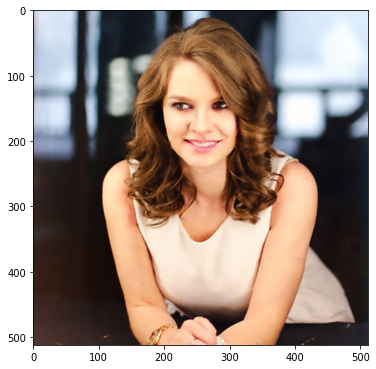

Iteration 03451    Loss 0.000223Iteration 03452    Loss 0.000232Iteration 03453    Loss 0.000236Iteration 03454    Loss 0.000221Iteration 03455    Loss 0.000233Iteration 03456    Loss 0.000228Iteration 03457    Loss 0.000209Iteration 03458    Loss 0.000216Iteration 03459    Loss 0.000218Iteration 03460    Loss 0.000211Iteration 03461    Loss 0.000211Iteration 03462    Loss 0.000209Iteration 03463    Loss 0.000211Iteration 03464    Loss 0.000223Iteration 03465    Loss 0.000222Iteration 03466    Loss 0.000223Iteration 03467    Loss 0.000212Iteration 03468    Loss 0.000208Iteration 03469    Loss 0.000205Iteration 03470    Loss 0.000221Iteration 03471    Loss 0.000202Iteration 03472    Loss 0.000211Iteration 03473    Loss 0.000212Iteration 03474    Loss 0.000215Iteration 03475    Loss 0.000205Iteration 03476    Loss 0.000205Iteration 03477    Loss 0.000196Iteration 03478    Loss 0.000200Iteration 03479    Loss 0.000203Iteration 03480    Loss 0.000198Iteration 03481    Loss 0.000196Iteratio

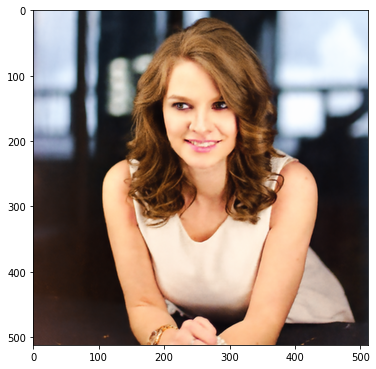

Iteration 03501    Loss 0.000203Iteration 03502    Loss 0.000198Iteration 03503    Loss 0.000192Iteration 03504    Loss 0.000198Iteration 03505    Loss 0.000205Iteration 03506    Loss 0.000215Iteration 03507    Loss 0.000218Iteration 03508    Loss 0.000201Iteration 03509    Loss 0.000191Iteration 03510    Loss 0.000211Iteration 03511    Loss 0.000228Iteration 03512    Loss 0.000221Iteration 03513    Loss 0.000212Iteration 03514    Loss 0.000195Iteration 03515    Loss 0.000196Iteration 03516    Loss 0.000210Iteration 03517    Loss 0.000220Iteration 03518    Loss 0.000206Iteration 03519    Loss 0.000212Iteration 03520    Loss 0.000209Iteration 03521    Loss 0.000211Iteration 03522    Loss 0.000211Iteration 03523    Loss 0.000203Iteration 03524    Loss 0.000201Iteration 03525    Loss 0.000218Iteration 03526    Loss 0.000212Iteration 03527    Loss 0.000201Iteration 03528    Loss 0.000207Iteration 03529    Loss 0.000220Iteration 03530    Loss 0.000216Iteration 03531    Loss 0.000222Iteratio

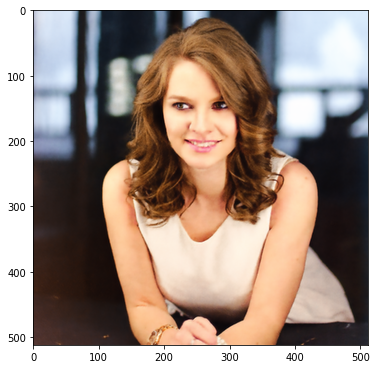

Iteration 03551    Loss 0.000195Iteration 03552    Loss 0.000198Iteration 03553    Loss 0.000187Iteration 03554    Loss 0.000191Iteration 03555    Loss 0.000188Iteration 03556    Loss 0.000191Iteration 03557    Loss 0.000196Iteration 03558    Loss 0.000201Iteration 03559    Loss 0.000195Iteration 03560    Loss 0.000186Iteration 03561    Loss 0.000189Iteration 03562    Loss 0.000197Iteration 03563    Loss 0.000193Iteration 03564    Loss 0.000197Iteration 03565    Loss 0.000197Iteration 03566    Loss 0.000188Iteration 03567    Loss 0.000191Iteration 03568    Loss 0.000196Iteration 03569    Loss 0.000191Iteration 03570    Loss 0.000194Iteration 03571    Loss 0.000202Iteration 03572    Loss 0.000202Iteration 03573    Loss 0.000202Iteration 03574    Loss 0.000203Iteration 03575    Loss 0.000194Iteration 03576    Loss 0.000188Iteration 03577    Loss 0.000203Iteration 03578    Loss 0.000215Iteration 03579    Loss 0.000206Iteration 03580    Loss 0.000196Iteration 03581    Loss 0.000189Iteratio

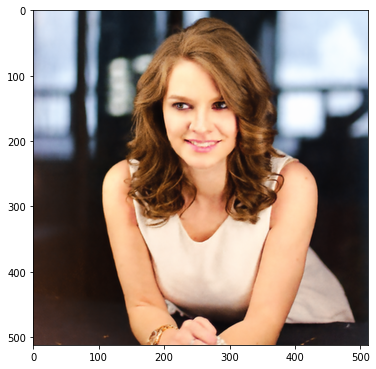

Iteration 03601    Loss 0.000189Iteration 03602    Loss 0.000184Iteration 03603    Loss 0.000208Iteration 03604    Loss 0.000219Iteration 03605    Loss 0.000207Iteration 03606    Loss 0.000188Iteration 03607    Loss 0.000201Iteration 03608    Loss 0.000196Iteration 03609    Loss 0.000198Iteration 03610    Loss 0.000196Iteration 03611    Loss 0.000194Iteration 03612    Loss 0.000205Iteration 03613    Loss 0.000201Iteration 03614    Loss 0.000187Iteration 03615    Loss 0.000204Iteration 03616    Loss 0.000212Iteration 03617    Loss 0.000198Iteration 03618    Loss 0.000191Iteration 03619    Loss 0.000197Iteration 03620    Loss 0.000189Iteration 03621    Loss 0.000187Iteration 03622    Loss 0.000194Iteration 03623    Loss 0.000195Iteration 03624    Loss 0.000187Iteration 03625    Loss 0.000198Iteration 03626    Loss 0.000197Iteration 03627    Loss 0.000188Iteration 03628    Loss 0.000201Iteration 03629    Loss 0.000196Iteration 03630    Loss 0.000188Iteration 03631    Loss 0.000198Iteratio

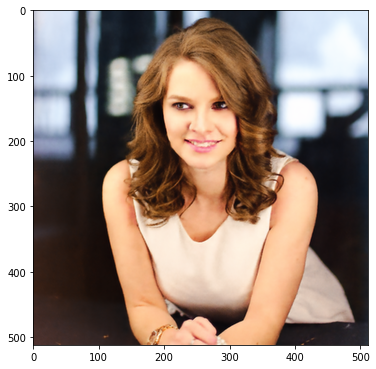

Iteration 03651    Loss 0.000197Iteration 03652    Loss 0.000212Iteration 03653    Loss 0.000217Iteration 03654    Loss 0.000210Iteration 03655    Loss 0.000192Iteration 03656    Loss 0.000182Iteration 03657    Loss 0.000196Iteration 03658    Loss 0.000214Iteration 03659    Loss 0.000206Iteration 03660    Loss 0.000187Iteration 03661    Loss 0.000191Iteration 03662    Loss 0.000210Iteration 03663    Loss 0.000211Iteration 03664    Loss 0.000195Iteration 03665    Loss 0.000187Iteration 03666    Loss 0.000199Iteration 03667    Loss 0.000211Iteration 03668    Loss 0.000204Iteration 03669    Loss 0.000192Iteration 03670    Loss 0.000186Iteration 03671    Loss 0.000201Iteration 03672    Loss 0.000231Iteration 03673    Loss 0.000229Iteration 03674    Loss 0.000202Iteration 03675    Loss 0.000185Iteration 03676    Loss 0.000203Iteration 03677    Loss 0.000209Iteration 03678    Loss 0.000214Iteration 03679    Loss 0.000212Iteration 03680    Loss 0.000204Iteration 03681    Loss 0.000189Iteratio

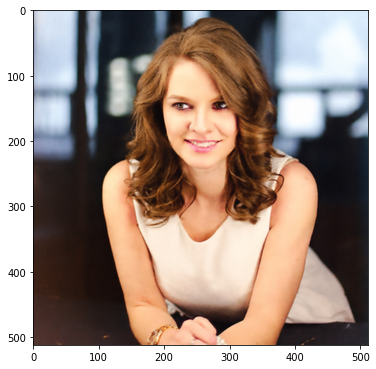

Iteration 03701    Loss 0.000216Iteration 03702    Loss 0.000239Iteration 03703    Loss 0.000240Iteration 03704    Loss 0.000214Iteration 03705    Loss 0.000190Iteration 03706    Loss 0.000211Iteration 03707    Loss 0.000249Iteration 03708    Loss 0.000221Iteration 03709    Loss 0.000185Iteration 03710    Loss 0.000197Iteration 03711    Loss 0.000214Iteration 03712    Loss 0.000199Iteration 03713    Loss 0.000189Iteration 03714    Loss 0.000190Iteration 03715    Loss 0.000191Iteration 03716    Loss 0.000201Iteration 03717    Loss 0.000193Iteration 03718    Loss 0.000187Iteration 03719    Loss 0.000181Iteration 03720    Loss 0.000185Iteration 03721    Loss 0.000182Iteration 03722    Loss 0.000188Iteration 03723    Loss 0.000184Iteration 03724    Loss 0.000186Iteration 03725    Loss 0.000197Iteration 03726    Loss 0.000199Iteration 03727    Loss 0.000190Iteration 03728    Loss 0.000180Iteration 03729    Loss 0.000185Iteration 03730    Loss 0.000189Iteration 03731    Loss 0.000192Iteratio

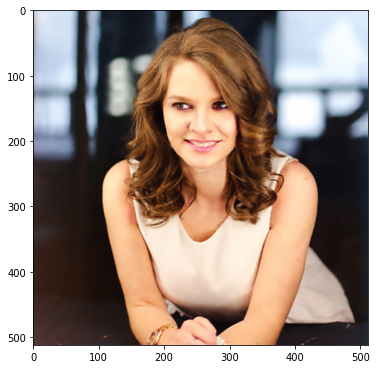

Iteration 03751    Loss 0.000185Iteration 03752    Loss 0.000183Iteration 03753    Loss 0.000185Iteration 03754    Loss 0.000184Iteration 03755    Loss 0.000181Iteration 03756    Loss 0.000185Iteration 03757    Loss 0.000187Iteration 03758    Loss 0.000188Iteration 03759    Loss 0.000184Iteration 03760    Loss 0.000184Iteration 03761    Loss 0.000178Iteration 03762    Loss 0.000179Iteration 03763    Loss 0.000184Iteration 03764    Loss 0.000187Iteration 03765    Loss 0.000179Iteration 03766    Loss 0.000179Iteration 03767    Loss 0.000189Iteration 03768    Loss 0.000181Iteration 03769    Loss 0.000174Iteration 03770    Loss 0.000181Iteration 03771    Loss 0.000194Iteration 03772    Loss 0.000211Iteration 03773    Loss 0.000217Iteration 03774    Loss 0.000198Iteration 03775    Loss 0.000180Iteration 03776    Loss 0.000177Iteration 03777    Loss 0.000178Iteration 03778    Loss 0.000189Iteration 03779    Loss 0.000198Iteration 03780    Loss 0.000197Iteration 03781    Loss 0.000182Iteratio

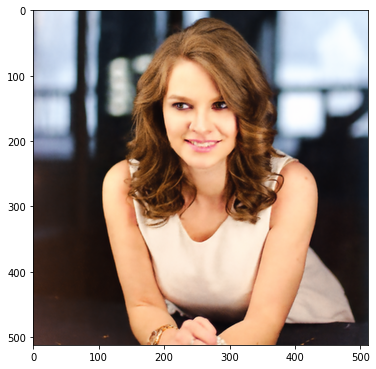

Iteration 03801    Loss 0.000188Iteration 03802    Loss 0.000184Iteration 03803    Loss 0.000185Iteration 03804    Loss 0.000187Iteration 03805    Loss 0.000189Iteration 03806    Loss 0.000219Iteration 03807    Loss 0.000234Iteration 03808    Loss 0.000209Iteration 03809    Loss 0.000192Iteration 03810    Loss 0.000207Iteration 03811    Loss 0.000201Iteration 03812    Loss 0.000223Iteration 03813    Loss 0.000222Iteration 03814    Loss 0.000205Iteration 03815    Loss 0.000180Iteration 03816    Loss 0.000187Iteration 03817    Loss 0.000200Iteration 03818    Loss 0.000226Iteration 03819    Loss 0.000228Iteration 03820    Loss 0.000192Iteration 03821    Loss 0.000179Iteration 03822    Loss 0.000186Iteration 03823    Loss 0.000199Iteration 03824    Loss 0.000187Iteration 03825    Loss 0.000186Iteration 03826    Loss 0.000176Iteration 03827    Loss 0.000186Iteration 03828    Loss 0.000181Iteration 03829    Loss 0.000179Iteration 03830    Loss 0.000184Iteration 03831    Loss 0.000173Iteratio

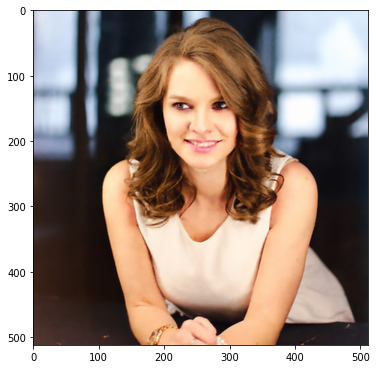

Iteration 03851    Loss 0.000180Iteration 03852    Loss 0.000193Iteration 03853    Loss 0.000211Iteration 03854    Loss 0.000208Iteration 03855    Loss 0.000207Iteration 03856    Loss 0.000200Iteration 03857    Loss 0.000182Iteration 03858    Loss 0.000183Iteration 03859    Loss 0.000210Iteration 03860    Loss 0.000204Iteration 03861    Loss 0.000186Iteration 03862    Loss 0.000172Iteration 03863    Loss 0.000190Iteration 03864    Loss 0.000208Iteration 03865    Loss 0.000213Iteration 03866    Loss 0.000206Iteration 03867    Loss 0.000197Iteration 03868    Loss 0.000183Iteration 03869    Loss 0.000194Iteration 03870    Loss 0.000211Iteration 03871    Loss 0.000200Iteration 03872    Loss 0.000176Iteration 03873    Loss 0.000196Iteration 03874    Loss 0.000213Iteration 03875    Loss 0.000195Iteration 03876    Loss 0.000175Iteration 03877    Loss 0.000192Iteration 03878    Loss 0.000218Iteration 03879    Loss 0.000209Iteration 03880    Loss 0.000194Iteration 03881    Loss 0.000177Iteratio

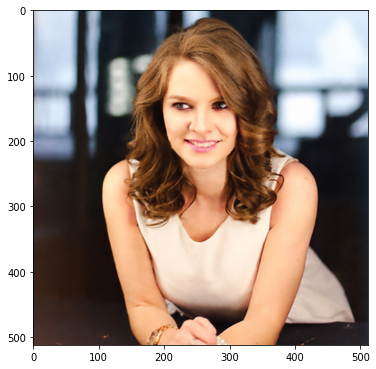

Iteration 03901    Loss 0.000178Iteration 03902    Loss 0.000177Iteration 03903    Loss 0.000181Iteration 03904    Loss 0.000180Iteration 03905    Loss 0.000180Iteration 03906    Loss 0.000169Iteration 03907    Loss 0.000173Iteration 03908    Loss 0.000178Iteration 03909    Loss 0.000179Iteration 03910    Loss 0.000174Iteration 03911    Loss 0.000172Iteration 03912    Loss 0.000175Iteration 03913    Loss 0.000181Iteration 03914    Loss 0.000182Iteration 03915    Loss 0.000181Iteration 03916    Loss 0.000176Iteration 03917    Loss 0.000176Iteration 03918    Loss 0.000181Iteration 03919    Loss 0.000181Iteration 03920    Loss 0.000174Iteration 03921    Loss 0.000168Iteration 03922    Loss 0.000170Iteration 03923    Loss 0.000169Iteration 03924    Loss 0.000174Iteration 03925    Loss 0.000177Iteration 03926    Loss 0.000175Iteration 03927    Loss 0.000167Iteration 03928    Loss 0.000175Iteration 03929    Loss 0.000185Iteration 03930    Loss 0.000191Iteration 03931    Loss 0.000191Iteratio

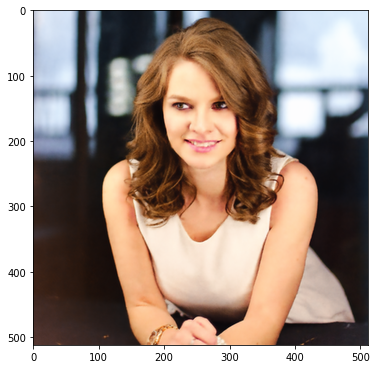

Iteration 03951    Loss 0.000173Iteration 03952    Loss 0.000186Iteration 03953    Loss 0.000186Iteration 03954    Loss 0.000168Iteration 03955    Loss 0.000181Iteration 03956    Loss 0.000185Iteration 03957    Loss 0.000182Iteration 03958    Loss 0.000188Iteration 03959    Loss 0.000191Iteration 03960    Loss 0.000190Iteration 03961    Loss 0.000175Iteration 03962    Loss 0.000174Iteration 03963    Loss 0.000174Iteration 03964    Loss 0.000177Iteration 03965    Loss 0.000188Iteration 03966    Loss 0.000195Iteration 03967    Loss 0.000184Iteration 03968    Loss 0.000177Iteration 03969    Loss 0.000200Iteration 03970    Loss 0.000197Iteration 03971    Loss 0.000179Iteration 03972    Loss 0.000188Iteration 03973    Loss 0.000200Iteration 03974    Loss 0.000187Iteration 03975    Loss 0.000186Iteration 03976    Loss 0.000224Iteration 03977    Loss 0.000216Iteration 03978    Loss 0.000172Iteration 03979    Loss 0.000206Iteration 03980    Loss 0.000227Iteration 03981    Loss 0.000180Iteratio

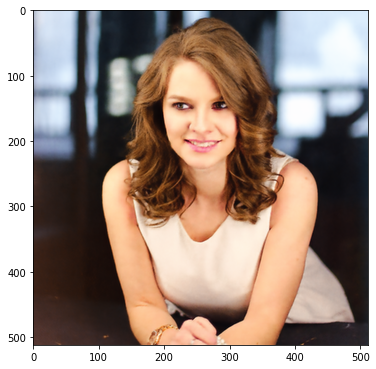

Iteration 04001    Loss 0.000196Iteration 04002    Loss 0.000192Iteration 04003    Loss 0.000195Iteration 04004    Loss 0.000177Iteration 04005    Loss 0.000189Iteration 04006    Loss 0.000193Iteration 04007    Loss 0.000198Iteration 04008    Loss 0.000210Iteration 04009    Loss 0.000190Iteration 04010    Loss 0.000170Iteration 04011    Loss 0.000190Iteration 04012    Loss 0.000200Iteration 04013    Loss 0.000184Iteration 04014    Loss 0.000171Iteration 04015    Loss 0.000185Iteration 04016    Loss 0.000191Iteration 04017    Loss 0.000186Iteration 04018    Loss 0.000167Iteration 04019    Loss 0.000182Iteration 04020    Loss 0.000177Iteration 04021    Loss 0.000172Iteration 04022    Loss 0.000170Iteration 04023    Loss 0.000171Iteration 04024    Loss 0.000167Iteration 04025    Loss 0.000169Iteration 04026    Loss 0.000170Iteration 04027    Loss 0.000175Iteration 04028    Loss 0.000166Iteration 04029    Loss 0.000166Iteration 04030    Loss 0.000171Iteration 04031    Loss 0.000175Iteratio

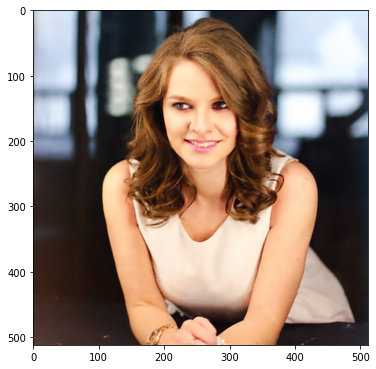

Iteration 04051    Loss 0.000176Iteration 04052    Loss 0.000177Iteration 04053    Loss 0.000168Iteration 04054    Loss 0.000162Iteration 04055    Loss 0.000169Iteration 04056    Loss 0.000173Iteration 04057    Loss 0.000185Iteration 04058    Loss 0.000178Iteration 04059    Loss 0.000178Iteration 04060    Loss 0.000164Iteration 04061    Loss 0.000165Iteration 04062    Loss 0.000176Iteration 04063    Loss 0.000172Iteration 04064    Loss 0.000166Iteration 04065    Loss 0.000165Iteration 04066    Loss 0.000175Iteration 04067    Loss 0.000173Iteration 04068    Loss 0.000180Iteration 04069    Loss 0.000169Iteration 04070    Loss 0.000173Iteration 04071    Loss 0.000181Iteration 04072    Loss 0.000184Iteration 04073    Loss 0.000191Iteration 04074    Loss 0.000173Iteration 04075    Loss 0.000175Iteration 04076    Loss 0.000172Iteration 04077    Loss 0.000174Iteration 04078    Loss 0.000179Iteration 04079    Loss 0.000170Iteration 04080    Loss 0.000176Iteration 04081    Loss 0.000168Iteratio

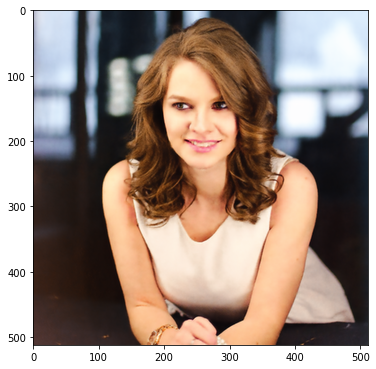

Iteration 04101    Loss 0.000175Iteration 04102    Loss 0.000165Iteration 04103    Loss 0.000179Iteration 04104    Loss 0.000184Iteration 04105    Loss 0.000170Iteration 04106    Loss 0.000160Iteration 04107    Loss 0.000172Iteration 04108    Loss 0.000180Iteration 04109    Loss 0.000174Iteration 04110    Loss 0.000180Iteration 04111    Loss 0.000192Iteration 04112    Loss 0.000189Iteration 04113    Loss 0.000164Iteration 04114    Loss 0.000169Iteration 04115    Loss 0.000188Iteration 04116    Loss 0.000178Iteration 04117    Loss 0.000163Iteration 04118    Loss 0.000172Iteration 04119    Loss 0.000175Iteration 04120    Loss 0.000165Iteration 04121    Loss 0.000172Iteration 04122    Loss 0.000179Iteration 04123    Loss 0.000168Iteration 04124    Loss 0.000163Iteration 04125    Loss 0.000176Iteration 04126    Loss 0.000178Iteration 04127    Loss 0.000159Iteration 04128    Loss 0.000172Iteration 04129    Loss 0.000174Iteration 04130    Loss 0.000160Iteration 04131    Loss 0.000162Iteratio

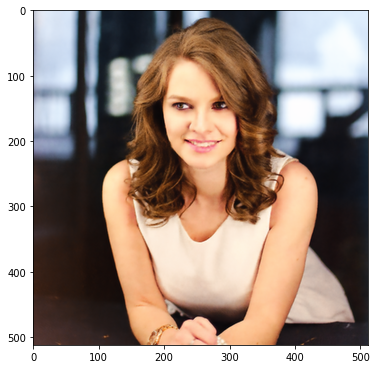

Iteration 04151    Loss 0.000184Iteration 04152    Loss 0.000182Iteration 04153    Loss 0.000174Iteration 04154    Loss 0.000162Iteration 04155    Loss 0.000162Iteration 04156    Loss 0.000162Iteration 04157    Loss 0.000176Iteration 04158    Loss 0.000173Iteration 04159    Loss 0.000184Iteration 04160    Loss 0.000177Iteration 04161    Loss 0.000165Iteration 04162    Loss 0.000162Iteration 04163    Loss 0.000157Iteration 04164    Loss 0.000167Iteration 04165    Loss 0.000169Iteration 04166    Loss 0.000169Iteration 04167    Loss 0.000169Iteration 04168    Loss 0.000159Iteration 04169    Loss 0.000160Iteration 04170    Loss 0.000154Iteration 04171    Loss 0.000157Iteration 04172    Loss 0.000158Iteration 04173    Loss 0.000163Iteration 04174    Loss 0.000171Iteration 04175    Loss 0.000179Iteration 04176    Loss 0.000189Iteration 04177    Loss 0.000185Iteration 04178    Loss 0.000176Iteration 04179    Loss 0.000161Iteration 04180    Loss 0.000165Iteration 04181    Loss 0.000172Iteratio

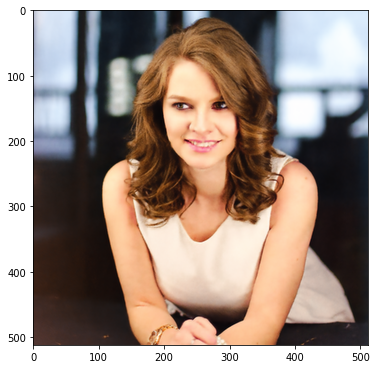

Iteration 04201    Loss 0.000163Iteration 04202    Loss 0.000160Iteration 04203    Loss 0.000162Iteration 04204    Loss 0.000171Iteration 04205    Loss 0.000166Iteration 04206    Loss 0.000159Iteration 04207    Loss 0.000167Iteration 04208    Loss 0.000173Iteration 04209    Loss 0.000158Iteration 04210    Loss 0.000157Iteration 04211    Loss 0.000165Iteration 04212    Loss 0.000172Iteration 04213    Loss 0.000162Iteration 04214    Loss 0.000158Iteration 04215    Loss 0.000159Iteration 04216    Loss 0.000159Iteration 04217    Loss 0.000161Iteration 04218    Loss 0.000161Iteration 04219    Loss 0.000162Iteration 04220    Loss 0.000160Iteration 04221    Loss 0.000158Iteration 04222    Loss 0.000164Iteration 04223    Loss 0.000164Iteration 04224    Loss 0.000162Iteration 04225    Loss 0.000164Iteration 04226    Loss 0.000174Iteration 04227    Loss 0.000179Iteration 04228    Loss 0.000172Iteration 04229    Loss 0.000184Iteration 04230    Loss 0.000185Iteration 04231    Loss 0.000166Iteratio

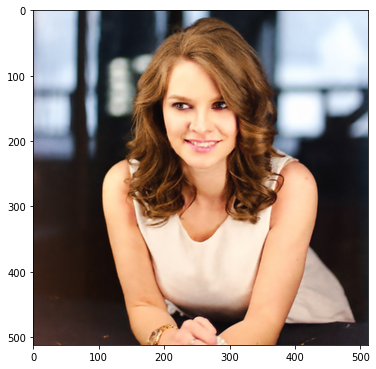

Iteration 04251    Loss 0.000161Iteration 04252    Loss 0.000160Iteration 04253    Loss 0.000157Iteration 04254    Loss 0.000156Iteration 04255    Loss 0.000161Iteration 04256    Loss 0.000168Iteration 04257    Loss 0.000161Iteration 04258    Loss 0.000162Iteration 04259    Loss 0.000159Iteration 04260    Loss 0.000162Iteration 04261    Loss 0.000160Iteration 04262    Loss 0.000153Iteration 04263    Loss 0.000161Iteration 04264    Loss 0.000161Iteration 04265    Loss 0.000158Iteration 04266    Loss 0.000156Iteration 04267    Loss 0.000152Iteration 04268    Loss 0.000153Iteration 04269    Loss 0.000153Iteration 04270    Loss 0.000153Iteration 04271    Loss 0.000153Iteration 04272    Loss 0.000156Iteration 04273    Loss 0.000154Iteration 04274    Loss 0.000155Iteration 04275    Loss 0.000157Iteration 04276    Loss 0.000158Iteration 04277    Loss 0.000154Iteration 04278    Loss 0.000163Iteration 04279    Loss 0.000169Iteration 04280    Loss 0.000164Iteration 04281    Loss 0.000166Iteratio

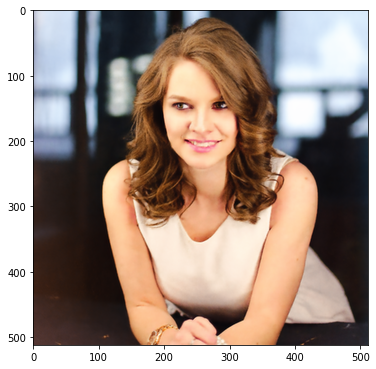

Iteration 04301    Loss 0.000195Iteration 04302    Loss 0.000183Iteration 04303    Loss 0.000174Iteration 04304    Loss 0.000173Iteration 04305    Loss 0.000177Iteration 04306    Loss 0.000169Iteration 04307    Loss 0.000163Iteration 04308    Loss 0.000166Iteration 04309    Loss 0.000192Iteration 04310    Loss 0.000180Iteration 04311    Loss 0.000170Iteration 04312    Loss 0.000168Iteration 04313    Loss 0.000179Iteration 04314    Loss 0.000170Iteration 04315    Loss 0.000154Iteration 04316    Loss 0.000170Iteration 04317    Loss 0.000175Iteration 04318    Loss 0.000171Iteration 04319    Loss 0.000163Iteration 04320    Loss 0.000162Iteration 04321    Loss 0.000156Iteration 04322    Loss 0.000160Iteration 04323    Loss 0.000157Iteration 04324    Loss 0.000160Iteration 04325    Loss 0.000159Iteration 04326    Loss 0.000159Iteration 04327    Loss 0.000155Iteration 04328    Loss 0.000161Iteration 04329    Loss 0.000173Iteration 04330    Loss 0.000173Iteration 04331    Loss 0.000170Iteratio

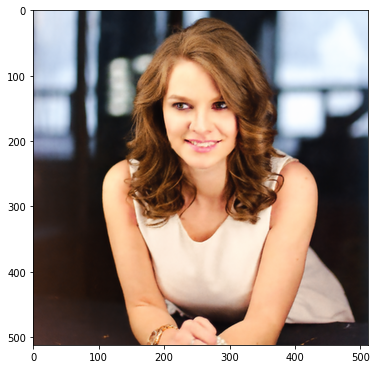

Iteration 04351    Loss 0.000150Iteration 04352    Loss 0.000152Iteration 04353    Loss 0.000154Iteration 04354    Loss 0.000154Iteration 04355    Loss 0.000150Iteration 04356    Loss 0.000148Iteration 04357    Loss 0.000155Iteration 04358    Loss 0.000158Iteration 04359    Loss 0.000160Iteration 04360    Loss 0.000160Iteration 04361    Loss 0.000154Iteration 04362    Loss 0.000149Iteration 04363    Loss 0.000148Iteration 04364    Loss 0.000156Iteration 04365    Loss 0.000171Iteration 04366    Loss 0.000185Iteration 04367    Loss 0.000187Iteration 04368    Loss 0.000166Iteration 04369    Loss 0.000152Iteration 04370    Loss 0.000152Iteration 04371    Loss 0.000167Iteration 04372    Loss 0.000183Iteration 04373    Loss 0.000190Iteration 04374    Loss 0.000178Iteration 04375    Loss 0.000163Iteration 04376    Loss 0.000147Iteration 04377    Loss 0.000161Iteration 04378    Loss 0.000168Iteration 04379    Loss 0.000167Iteration 04380    Loss 0.000158Iteration 04381    Loss 0.000155Iteratio

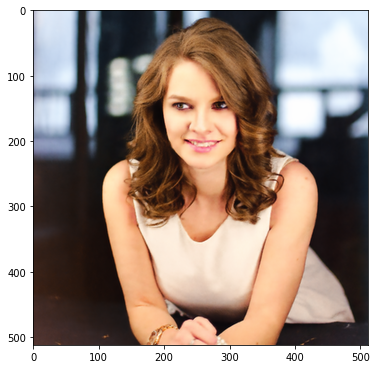

Iteration 04401    Loss 0.000155Iteration 04402    Loss 0.000152Iteration 04403    Loss 0.000153Iteration 04404    Loss 0.000161Iteration 04405    Loss 0.000156Iteration 04406    Loss 0.000151Iteration 04407    Loss 0.000150Iteration 04408    Loss 0.000162Iteration 04409    Loss 0.000181Iteration 04410    Loss 0.000192Iteration 04411    Loss 0.000182Iteration 04412    Loss 0.000164Iteration 04413    Loss 0.000148Iteration 04414    Loss 0.000161Iteration 04415    Loss 0.000179Iteration 04416    Loss 0.000165Iteration 04417    Loss 0.000160Iteration 04418    Loss 0.000155Iteration 04419    Loss 0.000170Iteration 04420    Loss 0.000168Iteration 04421    Loss 0.000169Iteration 04422    Loss 0.000161Iteration 04423    Loss 0.000157Iteration 04424    Loss 0.000158Iteration 04425    Loss 0.000157Iteration 04426    Loss 0.000163Iteration 04427    Loss 0.000155Iteration 04428    Loss 0.000152Iteration 04429    Loss 0.000148Iteration 04430    Loss 0.000157Iteration 04431    Loss 0.000151Iteratio

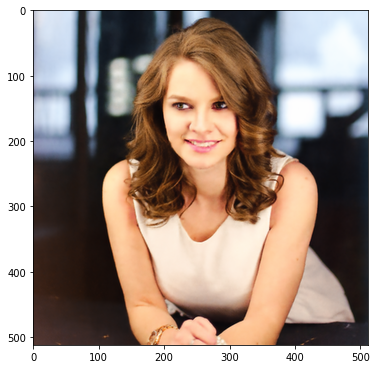

Iteration 04451    Loss 0.000151Iteration 04452    Loss 0.000155Iteration 04453    Loss 0.000155Iteration 04454    Loss 0.000149Iteration 04455    Loss 0.000151Iteration 04456    Loss 0.000154Iteration 04457    Loss 0.000152Iteration 04458    Loss 0.000148Iteration 04459    Loss 0.000153Iteration 04460    Loss 0.000145Iteration 04461    Loss 0.000145Iteration 04462    Loss 0.000153Iteration 04463    Loss 0.000168Iteration 04464    Loss 0.000165Iteration 04465    Loss 0.000169Iteration 04466    Loss 0.000166Iteration 04467    Loss 0.000165Iteration 04468    Loss 0.000147Iteration 04469    Loss 0.000147Iteration 04470    Loss 0.000155Iteration 04471    Loss 0.000155Iteration 04472    Loss 0.000153Iteration 04473    Loss 0.000151Iteration 04474    Loss 0.000148Iteration 04475    Loss 0.000145Iteration 04476    Loss 0.000148Iteration 04477    Loss 0.000154Iteration 04478    Loss 0.000159Iteration 04479    Loss 0.000157Iteration 04480    Loss 0.000155Iteration 04481    Loss 0.000156Iteratio

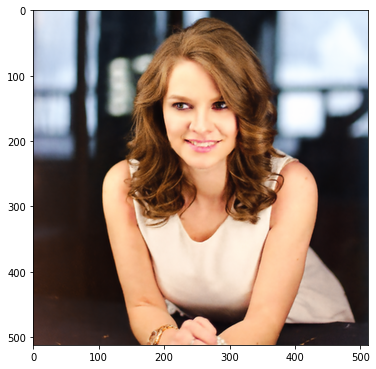

Iteration 04501    Loss 0.000151Iteration 04502    Loss 0.000155Iteration 04503    Loss 0.000170Iteration 04504    Loss 0.000164Iteration 04505    Loss 0.000155Iteration 04506    Loss 0.000151Iteration 04507    Loss 0.000152Iteration 04508    Loss 0.000154Iteration 04509    Loss 0.000163Iteration 04510    Loss 0.000160Iteration 04511    Loss 0.000151Iteration 04512    Loss 0.000153Iteration 04513    Loss 0.000160Iteration 04514    Loss 0.000165Iteration 04515    Loss 0.000151Iteration 04516    Loss 0.000157Iteration 04517    Loss 0.000162Iteration 04518    Loss 0.000173Iteration 04519    Loss 0.000162Iteration 04520    Loss 0.000152Iteration 04521    Loss 0.000150Iteration 04522    Loss 0.000146Iteration 04523    Loss 0.000148Iteration 04524    Loss 0.000143Iteration 04525    Loss 0.000146Iteration 04526    Loss 0.000144Iteration 04527    Loss 0.000145Iteration 04528    Loss 0.000143Iteration 04529    Loss 0.000148Iteration 04530    Loss 0.000141Iteration 04531    Loss 0.000147Iteratio

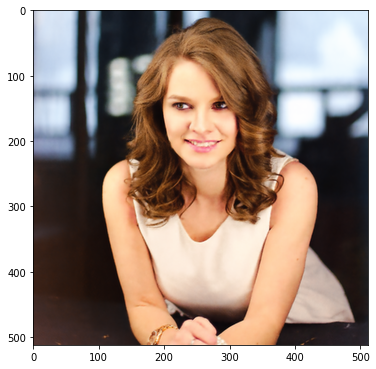

Iteration 04551    Loss 0.000164Iteration 04552    Loss 0.000160Iteration 04553    Loss 0.000151Iteration 04554    Loss 0.000145Iteration 04555    Loss 0.000148Iteration 04556    Loss 0.000147Iteration 04557    Loss 0.000147Iteration 04558    Loss 0.000145Iteration 04559    Loss 0.000144Iteration 04560    Loss 0.000144Iteration 04561    Loss 0.000150Iteration 04562    Loss 0.000153Iteration 04563    Loss 0.000155Iteration 04564    Loss 0.000143Iteration 04565    Loss 0.000143Iteration 04566    Loss 0.000148Iteration 04567    Loss 0.000148Iteration 04568    Loss 0.000146Iteration 04569    Loss 0.000144Iteration 04570    Loss 0.000147Iteration 04571    Loss 0.000151Iteration 04572    Loss 0.000141Iteration 04573    Loss 0.000143Iteration 04574    Loss 0.000151Iteration 04575    Loss 0.000145Iteration 04576    Loss 0.000145Iteration 04577    Loss 0.000145Iteration 04578    Loss 0.000149Iteration 04579    Loss 0.000151Iteration 04580    Loss 0.000147Iteration 04581    Loss 0.000143Iteratio

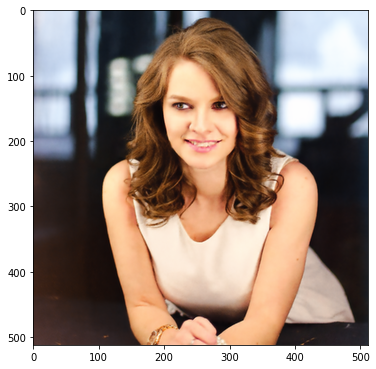

Iteration 04601    Loss 0.000152Iteration 04602    Loss 0.000146Iteration 04603    Loss 0.000142Iteration 04604    Loss 0.000144Iteration 04605    Loss 0.000144Iteration 04606    Loss 0.000147Iteration 04607    Loss 0.000146Iteration 04608    Loss 0.000154Iteration 04609    Loss 0.000159Iteration 04610    Loss 0.000167Iteration 04611    Loss 0.000168Iteration 04612    Loss 0.000159Iteration 04613    Loss 0.000146Iteration 04614    Loss 0.000141Iteration 04615    Loss 0.000146Iteration 04616    Loss 0.000162Iteration 04617    Loss 0.000167Iteration 04618    Loss 0.000167Iteration 04619    Loss 0.000165Iteration 04620    Loss 0.000167Iteration 04621    Loss 0.000178Iteration 04622    Loss 0.000196Iteration 04623    Loss 0.000191Iteration 04624    Loss 0.000161Iteration 04625    Loss 0.000145Iteration 04626    Loss 0.000160Iteration 04627    Loss 0.000182Iteration 04628    Loss 0.000176Iteration 04629    Loss 0.000159Iteration 04630    Loss 0.000146Iteration 04631    Loss 0.000154Iteratio

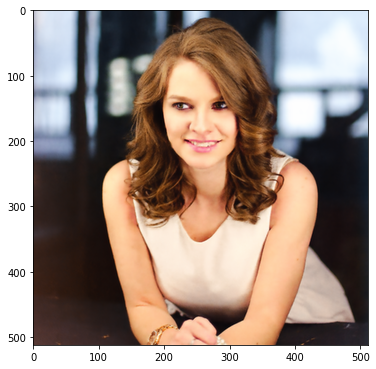

Iteration 04651    Loss 0.000158Iteration 04652    Loss 0.000168Iteration 04653    Loss 0.000163Iteration 04654    Loss 0.000149Iteration 04655    Loss 0.000143Iteration 04656    Loss 0.000145Iteration 04657    Loss 0.000162Iteration 04658    Loss 0.000159Iteration 04659    Loss 0.000162Iteration 04660    Loss 0.000154Iteration 04661    Loss 0.000149Iteration 04662    Loss 0.000142Iteration 04663    Loss 0.000142Iteration 04664    Loss 0.000149Iteration 04665    Loss 0.000158Iteration 04666    Loss 0.000156Iteration 04667    Loss 0.000155Iteration 04668    Loss 0.000145Iteration 04669    Loss 0.000144Iteration 04670    Loss 0.000141Iteration 04671    Loss 0.000140Iteration 04672    Loss 0.000139Iteration 04673    Loss 0.000141Iteration 04674    Loss 0.000143Iteration 04675    Loss 0.000153Iteration 04676    Loss 0.000160Iteration 04677    Loss 0.000165Iteration 04678    Loss 0.000161Iteration 04679    Loss 0.000158Iteration 04680    Loss 0.000147Iteration 04681    Loss 0.000140Iteratio

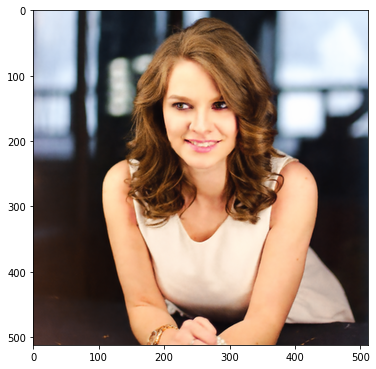

Iteration 04701    Loss 0.000158Iteration 04702    Loss 0.000148Iteration 04703    Loss 0.000142Iteration 04704    Loss 0.000141Iteration 04705    Loss 0.000140Iteration 04706    Loss 0.000145Iteration 04707    Loss 0.000144Iteration 04708    Loss 0.000152Iteration 04709    Loss 0.000153Iteration 04710    Loss 0.000144Iteration 04711    Loss 0.000136Iteration 04712    Loss 0.000139Iteration 04713    Loss 0.000143Iteration 04714    Loss 0.000144Iteration 04715    Loss 0.000138Iteration 04716    Loss 0.000139Iteration 04717    Loss 0.000138Iteration 04718    Loss 0.000139Iteration 04719    Loss 0.000145Iteration 04720    Loss 0.000135Iteration 04721    Loss 0.000139Iteration 04722    Loss 0.000133Iteration 04723    Loss 0.000139Iteration 04724    Loss 0.000138Iteration 04725    Loss 0.000138Iteration 04726    Loss 0.000148Iteration 04727    Loss 0.000153Iteration 04728    Loss 0.000164Iteration 04729    Loss 0.000151Iteration 04730    Loss 0.000145Iteration 04731    Loss 0.000145Iteratio

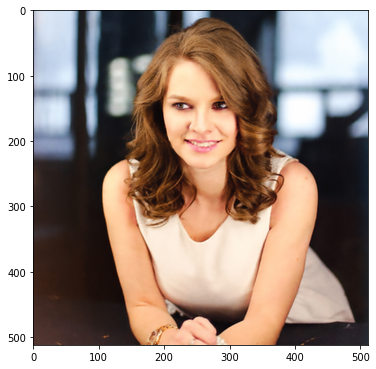

Iteration 04751    Loss 0.000141Iteration 04752    Loss 0.000140Iteration 04753    Loss 0.000142Iteration 04754    Loss 0.000137Iteration 04755    Loss 0.000142Iteration 04756    Loss 0.000137Iteration 04757    Loss 0.000139Iteration 04758    Loss 0.000138Iteration 04759    Loss 0.000137Iteration 04760    Loss 0.000142Iteration 04761    Loss 0.000140Iteration 04762    Loss 0.000140Iteration 04763    Loss 0.000138Iteration 04764    Loss 0.000146Iteration 04765    Loss 0.000151Iteration 04766    Loss 0.000137Iteration 04767    Loss 0.000141Iteration 04768    Loss 0.000142Iteration 04769    Loss 0.000138Iteration 04770    Loss 0.000136Iteration 04771    Loss 0.000143Iteration 04772    Loss 0.000159Iteration 04773    Loss 0.000164Iteration 04774    Loss 0.000152Iteration 04775    Loss 0.000162Iteration 04776    Loss 0.000162Iteration 04777    Loss 0.000151Iteration 04778    Loss 0.000141Iteration 04779    Loss 0.000145Iteration 04780    Loss 0.000170Iteration 04781    Loss 0.000177Iteratio

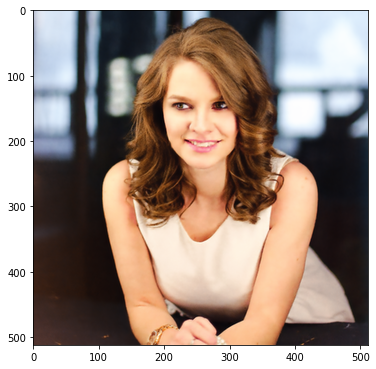

Iteration 04801    Loss 0.000136Iteration 04802    Loss 0.000133Iteration 04803    Loss 0.000141Iteration 04804    Loss 0.000137Iteration 04805    Loss 0.000141Iteration 04806    Loss 0.000138Iteration 04807    Loss 0.000151Iteration 04808    Loss 0.000147Iteration 04809    Loss 0.000138Iteration 04810    Loss 0.000142Iteration 04811    Loss 0.000147Iteration 04812    Loss 0.000147Iteration 04813    Loss 0.000140Iteration 04814    Loss 0.000143Iteration 04815    Loss 0.000145Iteration 04816    Loss 0.000144Iteration 04817    Loss 0.000141Iteration 04818    Loss 0.000139Iteration 04819    Loss 0.000145Iteration 04820    Loss 0.000144Iteration 04821    Loss 0.000146Iteration 04822    Loss 0.000150Iteration 04823    Loss 0.000150Iteration 04824    Loss 0.000154Iteration 04825    Loss 0.000158Iteration 04826    Loss 0.000164Iteration 04827    Loss 0.000169Iteration 04828    Loss 0.000151Iteration 04829    Loss 0.000139Iteration 04830    Loss 0.000136Iteration 04831    Loss 0.000137Iteratio

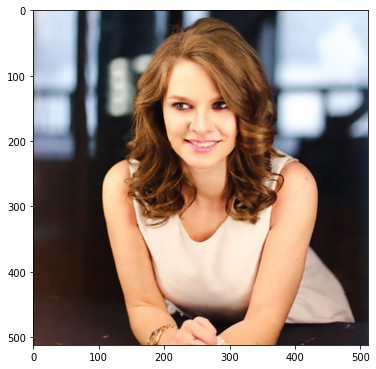

Iteration 04851    Loss 0.000131Iteration 04852    Loss 0.000138Iteration 04853    Loss 0.000149Iteration 04854    Loss 0.000146Iteration 04855    Loss 0.000145Iteration 04856    Loss 0.000146Iteration 04857    Loss 0.000149Iteration 04858    Loss 0.000153Iteration 04859    Loss 0.000146Iteration 04860    Loss 0.000148Iteration 04861    Loss 0.000146Iteration 04862    Loss 0.000136Iteration 04863    Loss 0.000134Iteration 04864    Loss 0.000130Iteration 04865    Loss 0.000132Iteration 04866    Loss 0.000133Iteration 04867    Loss 0.000133Iteration 04868    Loss 0.000133Iteration 04869    Loss 0.000133Iteration 04870    Loss 0.000140Iteration 04871    Loss 0.000141Iteration 04872    Loss 0.000146Iteration 04873    Loss 0.000140Iteration 04874    Loss 0.000136Iteration 04875    Loss 0.000136Iteration 04876    Loss 0.000137Iteration 04877    Loss 0.000138Iteration 04878    Loss 0.000133Iteration 04879    Loss 0.000130Iteration 04880    Loss 0.000131Iteration 04881    Loss 0.000134Iteratio

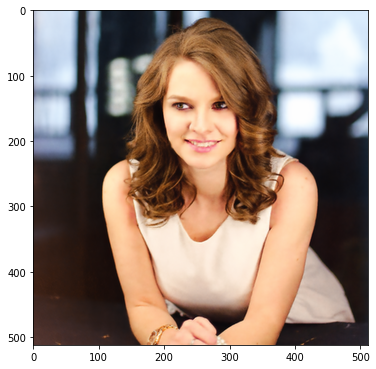

Iteration 04901    Loss 0.000183Iteration 04902    Loss 0.000160Iteration 04903    Loss 0.000135Iteration 04904    Loss 0.000141Iteration 04905    Loss 0.000164Iteration 04906    Loss 0.000175Iteration 04907    Loss 0.000162Iteration 04908    Loss 0.000134Iteration 04909    Loss 0.000154Iteration 04910    Loss 0.000166Iteration 04911    Loss 0.000169Iteration 04912    Loss 0.000162Iteration 04913    Loss 0.000145Iteration 04914    Loss 0.000147Iteration 04915    Loss 0.000163Iteration 04916    Loss 0.000173Iteration 04917    Loss 0.000161Iteration 04918    Loss 0.000132Iteration 04919    Loss 0.000153Iteration 04920    Loss 0.000168Iteration 04921    Loss 0.000148Iteration 04922    Loss 0.000145Iteration 04923    Loss 0.000140Iteration 04924    Loss 0.000145Iteration 04925    Loss 0.000145Iteration 04926    Loss 0.000153Iteration 04927    Loss 0.000152Iteration 04928    Loss 0.000142Iteration 04929    Loss 0.000133Iteration 04930    Loss 0.000141Iteration 04931    Loss 0.000147Iteratio

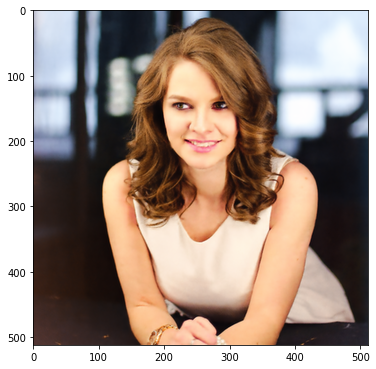

Iteration 04951    Loss 0.000142Iteration 04952    Loss 0.000159Iteration 04953    Loss 0.000160Iteration 04954    Loss 0.000143Iteration 04955    Loss 0.000133Iteration 04956    Loss 0.000137Iteration 04957    Loss 0.000144Iteration 04958    Loss 0.000135Iteration 04959    Loss 0.000132Iteration 04960    Loss 0.000137Iteration 04961    Loss 0.000135Iteration 04962    Loss 0.000139Iteration 04963    Loss 0.000127Iteration 04964    Loss 0.000131Iteration 04965    Loss 0.000132Iteration 04966    Loss 0.000140Iteration 04967    Loss 0.000144Iteration 04968    Loss 0.000151Iteration 04969    Loss 0.000145Iteration 04970    Loss 0.000137Iteration 04971    Loss 0.000128Iteration 04972    Loss 0.000132Iteration 04973    Loss 0.000143Iteration 04974    Loss 0.000146Iteration 04975    Loss 0.000145Iteration 04976    Loss 0.000137Iteration 04977    Loss 0.000137Iteration 04978    Loss 0.000135Iteration 04979    Loss 0.000143Iteration 04980    Loss 0.000156Iteration 04981    Loss 0.000157Iteratio

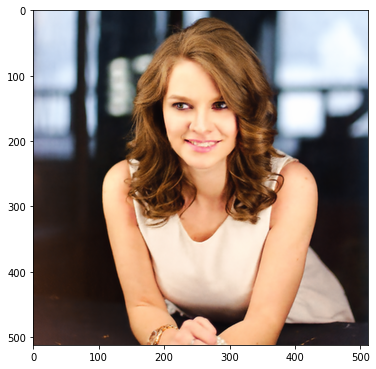

Iteration 05001    Loss 0.000142Iteration 05002    Loss 0.000159Iteration 05003    Loss 0.000148Iteration 05004    Loss 0.000140Iteration 05005    Loss 0.000130Iteration 05006    Loss 0.000139Iteration 05007    Loss 0.000151Iteration 05008    Loss 0.000158Iteration 05009    Loss 0.000152Iteration 05010    Loss 0.000141Iteration 05011    Loss 0.000134Iteration 05012    Loss 0.000145Iteration 05013    Loss 0.000148Iteration 05014    Loss 0.000150Iteration 05015    Loss 0.000138Iteration 05016    Loss 0.000144Iteration 05017    Loss 0.000159Iteration 05018    Loss 0.000170Iteration 05019    Loss 0.000156Iteration 05020    Loss 0.000140Iteration 05021    Loss 0.000140Iteration 05022    Loss 0.000146Iteration 05023    Loss 0.000146Iteration 05024    Loss 0.000136Iteration 05025    Loss 0.000133Iteration 05026    Loss 0.000143Iteration 05027    Loss 0.000144Iteration 05028    Loss 0.000135Iteration 05029    Loss 0.000134Iteration 05030    Loss 0.000142Iteration 05031    Loss 0.000144Iteratio

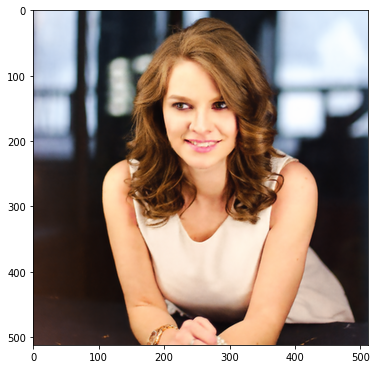

Iteration 05051    Loss 0.000138Iteration 05052    Loss 0.000144Iteration 05053    Loss 0.000131Iteration 05054    Loss 0.000126Iteration 05055    Loss 0.000128Iteration 05056    Loss 0.000130Iteration 05057    Loss 0.000131Iteration 05058    Loss 0.000126Iteration 05059    Loss 0.000129Iteration 05060    Loss 0.000129Iteration 05061    Loss 0.000131Iteration 05062    Loss 0.000133Iteration 05063    Loss 0.000129Iteration 05064    Loss 0.000134Iteration 05065    Loss 0.000138Iteration 05066    Loss 0.000139Iteration 05067    Loss 0.000140Iteration 05068    Loss 0.000134Iteration 05069    Loss 0.000130Iteration 05070    Loss 0.000127Iteration 05071    Loss 0.000126Iteration 05072    Loss 0.000132Iteration 05073    Loss 0.000136Iteration 05074    Loss 0.000135Iteration 05075    Loss 0.000132Iteration 05076    Loss 0.000130Iteration 05077    Loss 0.000127Iteration 05078    Loss 0.000129Iteration 05079    Loss 0.000126Iteration 05080    Loss 0.000126Iteration 05081    Loss 0.000126Iteratio

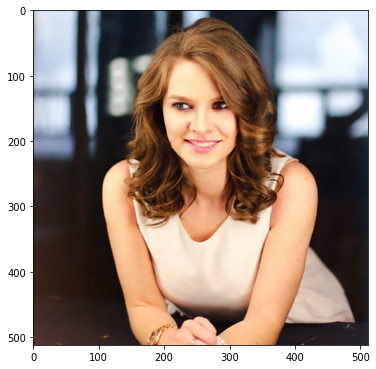

Iteration 05101    Loss 0.000126Iteration 05102    Loss 0.000130Iteration 05103    Loss 0.000128Iteration 05104    Loss 0.000135Iteration 05105    Loss 0.000137Iteration 05106    Loss 0.000146Iteration 05107    Loss 0.000153Iteration 05108    Loss 0.000149Iteration 05109    Loss 0.000151Iteration 05110    Loss 0.000152Iteration 05111    Loss 0.000142Iteration 05112    Loss 0.000133Iteration 05113    Loss 0.000151Iteration 05114    Loss 0.000177Iteration 05115    Loss 0.000195Iteration 05116    Loss 0.000184Iteration 05117    Loss 0.000149Iteration 05118    Loss 0.000128Iteration 05119    Loss 0.000128Iteration 05120    Loss 0.000139Iteration 05121    Loss 0.000139Iteration 05122    Loss 0.000130Iteration 05123    Loss 0.000130Iteration 05124    Loss 0.000127Iteration 05125    Loss 0.000134Iteration 05126    Loss 0.000129Iteration 05127    Loss 0.000127Iteration 05128    Loss 0.000128Iteration 05129    Loss 0.000128Iteration 05130    Loss 0.000131Iteration 05131    Loss 0.000131Iteratio

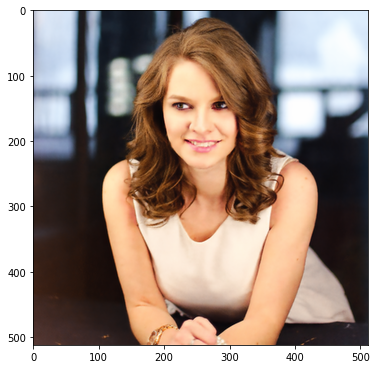

Iteration 05151    Loss 0.000129Iteration 05152    Loss 0.000129Iteration 05153    Loss 0.000132Iteration 05154    Loss 0.000133Iteration 05155    Loss 0.000133Iteration 05156    Loss 0.000128Iteration 05157    Loss 0.000132Iteration 05158    Loss 0.000133Iteration 05159    Loss 0.000138Iteration 05160    Loss 0.000135Iteration 05161    Loss 0.000138Iteration 05162    Loss 0.000130Iteration 05163    Loss 0.000124Iteration 05164    Loss 0.000126Iteration 05165    Loss 0.000136Iteration 05166    Loss 0.000146Iteration 05167    Loss 0.000144Iteration 05168    Loss 0.000135Iteration 05169    Loss 0.000131Iteration 05170    Loss 0.000134Iteration 05171    Loss 0.000137Iteration 05172    Loss 0.000130Iteration 05173    Loss 0.000129Iteration 05174    Loss 0.000125Iteration 05175    Loss 0.000124Iteration 05176    Loss 0.000127Iteration 05177    Loss 0.000127Iteration 05178    Loss 0.000126Iteration 05179    Loss 0.000120Iteration 05180    Loss 0.000125Iteration 05181    Loss 0.000133Iteratio

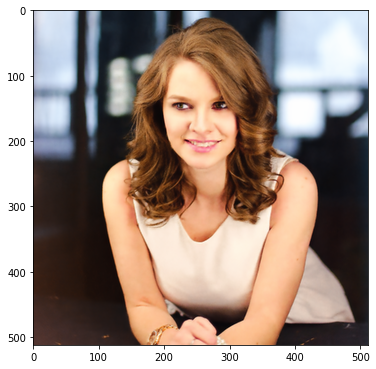

Iteration 05201    Loss 0.000129Iteration 05202    Loss 0.000136Iteration 05203    Loss 0.000142Iteration 05204    Loss 0.000137Iteration 05205    Loss 0.000135Iteration 05206    Loss 0.000138Iteration 05207    Loss 0.000147Iteration 05208    Loss 0.000152Iteration 05209    Loss 0.000154Iteration 05210    Loss 0.000159Iteration 05211    Loss 0.000168Iteration 05212    Loss 0.000178Iteration 05213    Loss 0.000159Iteration 05214    Loss 0.000148Iteration 05215    Loss 0.000143Iteration 05216    Loss 0.000136Iteration 05217    Loss 0.000128Iteration 05218    Loss 0.000130Iteration 05219    Loss 0.000132Iteration 05220    Loss 0.000141Iteration 05221    Loss 0.000138Iteration 05222    Loss 0.000135Iteration 05223    Loss 0.000137Iteration 05224    Loss 0.000144Iteration 05225    Loss 0.000139Iteration 05226    Loss 0.000133Iteration 05227    Loss 0.000127Iteration 05228    Loss 0.000124Iteration 05229    Loss 0.000127Iteration 05230    Loss 0.000126Iteration 05231    Loss 0.000129Iteratio

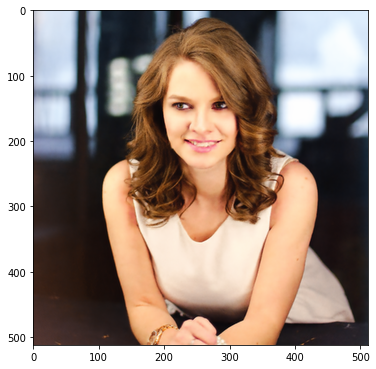

Iteration 05251    Loss 0.000129Iteration 05252    Loss 0.000123Iteration 05253    Loss 0.000127Iteration 05254    Loss 0.000127Iteration 05255    Loss 0.000123Iteration 05256    Loss 0.000120Iteration 05257    Loss 0.000129Iteration 05258    Loss 0.000134Iteration 05259    Loss 0.000130Iteration 05260    Loss 0.000123Iteration 05261    Loss 0.000118Iteration 05262    Loss 0.000123Iteration 05263    Loss 0.000130Iteration 05264    Loss 0.000144Iteration 05265    Loss 0.000151Iteration 05266    Loss 0.000143Iteration 05267    Loss 0.000135Iteration 05268    Loss 0.000130Iteration 05269    Loss 0.000132Iteration 05270    Loss 0.000135Iteration 05271    Loss 0.000150Iteration 05272    Loss 0.000168Iteration 05273    Loss 0.000152Iteration 05274    Loss 0.000132Iteration 05275    Loss 0.000125Iteration 05276    Loss 0.000142Iteration 05277    Loss 0.000155Iteration 05278    Loss 0.000140Iteration 05279    Loss 0.000122Iteration 05280    Loss 0.000127Iteration 05281    Loss 0.000142Iteratio

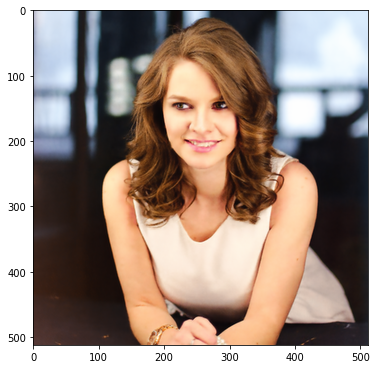

Iteration 05301    Loss 0.000126Iteration 05302    Loss 0.000119Iteration 05303    Loss 0.000129Iteration 05304    Loss 0.000133Iteration 05305    Loss 0.000141Iteration 05306    Loss 0.000155Iteration 05307    Loss 0.000158Iteration 05308    Loss 0.000156Iteration 05309    Loss 0.000132Iteration 05310    Loss 0.000122Iteration 05311    Loss 0.000129Iteration 05312    Loss 0.000135Iteration 05313    Loss 0.000141Iteration 05314    Loss 0.000144Iteration 05315    Loss 0.000130Iteration 05316    Loss 0.000122Iteration 05317    Loss 0.000122Iteration 05318    Loss 0.000132Iteration 05319    Loss 0.000132Iteration 05320    Loss 0.000129Iteration 05321    Loss 0.000126Iteration 05322    Loss 0.000120Iteration 05323    Loss 0.000123Iteration 05324    Loss 0.000129Iteration 05325    Loss 0.000132Iteration 05326    Loss 0.000126Iteration 05327    Loss 0.000124Iteration 05328    Loss 0.000122Iteration 05329    Loss 0.000120Iteration 05330    Loss 0.000127Iteration 05331    Loss 0.000132Iteratio

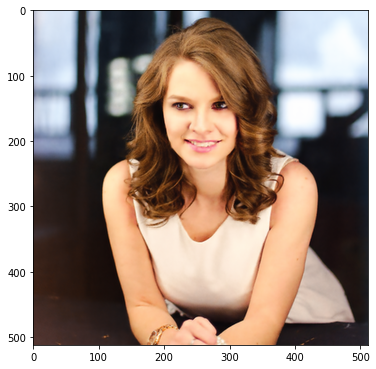

Iteration 05351    Loss 0.000117Iteration 05352    Loss 0.000116Iteration 05353    Loss 0.000120Iteration 05354    Loss 0.000120Iteration 05355    Loss 0.000119Iteration 05356    Loss 0.000117Iteration 05357    Loss 0.000115Iteration 05358    Loss 0.000116Iteration 05359    Loss 0.000114Iteration 05360    Loss 0.000118Iteration 05361    Loss 0.000123Iteration 05362    Loss 0.000132Iteration 05363    Loss 0.000136Iteration 05364    Loss 0.000147Iteration 05365    Loss 0.000158Iteration 05366    Loss 0.000152Iteration 05367    Loss 0.000133Iteration 05368    Loss 0.000124Iteration 05369    Loss 0.000126Iteration 05370    Loss 0.000137Iteration 05371    Loss 0.000141Iteration 05372    Loss 0.000130Iteration 05373    Loss 0.000121Iteration 05374    Loss 0.000123Iteration 05375    Loss 0.000131Iteration 05376    Loss 0.000134Iteration 05377    Loss 0.000123Iteration 05378    Loss 0.000115Iteration 05379    Loss 0.000119Iteration 05380    Loss 0.000121Iteration 05381    Loss 0.000125Iteratio

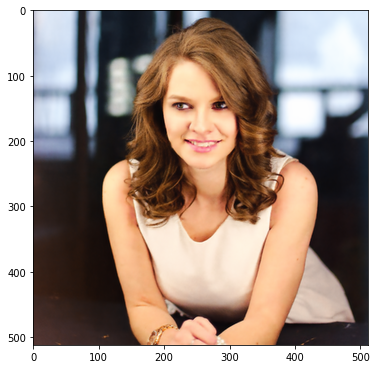

Iteration 05401    Loss 0.000129Iteration 05402    Loss 0.000128Iteration 05403    Loss 0.000132Iteration 05404    Loss 0.000127Iteration 05405    Loss 0.000115Iteration 05406    Loss 0.000116Iteration 05407    Loss 0.000123Iteration 05408    Loss 0.000133Iteration 05409    Loss 0.000129Iteration 05410    Loss 0.000121Iteration 05411    Loss 0.000122Iteration 05412    Loss 0.000123Iteration 05413    Loss 0.000120Iteration 05414    Loss 0.000117Iteration 05415    Loss 0.000116Iteration 05416    Loss 0.000115Iteration 05417    Loss 0.000115Iteration 05418    Loss 0.000113Iteration 05419    Loss 0.000114Iteration 05420    Loss 0.000113Iteration 05421    Loss 0.000117Iteration 05422    Loss 0.000118Iteration 05423    Loss 0.000117Iteration 05424    Loss 0.000117Iteration 05425    Loss 0.000116Iteration 05426    Loss 0.000114Iteration 05427    Loss 0.000115Iteration 05428    Loss 0.000114Iteration 05429    Loss 0.000115Iteration 05430    Loss 0.000114Iteration 05431    Loss 0.000119Iteratio

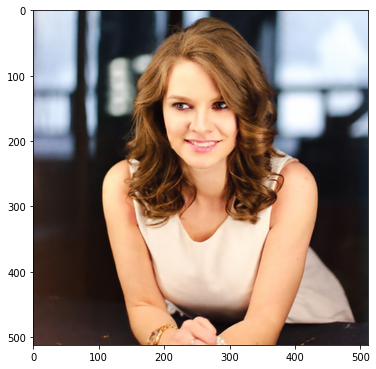

Iteration 05451    Loss 0.000119Iteration 05452    Loss 0.000122Iteration 05453    Loss 0.000122Iteration 05454    Loss 0.000116Iteration 05455    Loss 0.000121Iteration 05456    Loss 0.000121Iteration 05457    Loss 0.000119Iteration 05458    Loss 0.000116Iteration 05459    Loss 0.000120Iteration 05460    Loss 0.000127Iteration 05461    Loss 0.000132Iteration 05462    Loss 0.000122Iteration 05463    Loss 0.000117Iteration 05464    Loss 0.000119Iteration 05465    Loss 0.000116Iteration 05466    Loss 0.000114Iteration 05467    Loss 0.000115Iteration 05468    Loss 0.000114Iteration 05469    Loss 0.000118Iteration 05470    Loss 0.000114Iteration 05471    Loss 0.000115Iteration 05472    Loss 0.000117Iteration 05473    Loss 0.000118Iteration 05474    Loss 0.000111Iteration 05475    Loss 0.000110Iteration 05476    Loss 0.000112Iteration 05477    Loss 0.000116Iteration 05478    Loss 0.000117Iteration 05479    Loss 0.000120Iteration 05480    Loss 0.000120Iteration 05481    Loss 0.000121Iteratio

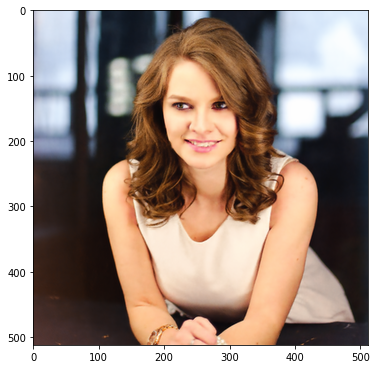

Iteration 05501    Loss 0.000145Iteration 05502    Loss 0.000124Iteration 05503    Loss 0.000121Iteration 05504    Loss 0.000128Iteration 05505    Loss 0.000135Iteration 05506    Loss 0.000132Iteration 05507    Loss 0.000120Iteration 05508    Loss 0.000115Iteration 05509    Loss 0.000114Iteration 05510    Loss 0.000121Iteration 05511    Loss 0.000127Iteration 05512    Loss 0.000130Iteration 05513    Loss 0.000128Iteration 05514    Loss 0.000126Iteration 05515    Loss 0.000114Iteration 05516    Loss 0.000114Iteration 05517    Loss 0.000119Iteration 05518    Loss 0.000118Iteration 05519    Loss 0.000114Iteration 05520    Loss 0.000113Iteration 05521    Loss 0.000113Iteration 05522    Loss 0.000117Iteration 05523    Loss 0.000119Iteration 05524    Loss 0.000120Iteration 05525    Loss 0.000116Iteration 05526    Loss 0.000124Iteration 05527    Loss 0.000127Iteration 05528    Loss 0.000133Iteration 05529    Loss 0.000133Iteration 05530    Loss 0.000120Iteration 05531    Loss 0.000117Iteratio

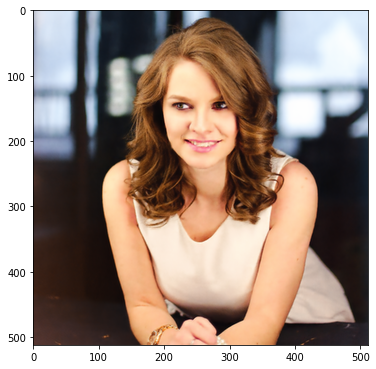

Iteration 05551    Loss 0.000118Iteration 05552    Loss 0.000126Iteration 05553    Loss 0.000128Iteration 05554    Loss 0.000115Iteration 05555    Loss 0.000115Iteration 05556    Loss 0.000122Iteration 05557    Loss 0.000125Iteration 05558    Loss 0.000128Iteration 05559    Loss 0.000128Iteration 05560    Loss 0.000122Iteration 05561    Loss 0.000117Iteration 05562    Loss 0.000115Iteration 05563    Loss 0.000116Iteration 05564    Loss 0.000112Iteration 05565    Loss 0.000116Iteration 05566    Loss 0.000124Iteration 05567    Loss 0.000123Iteration 05568    Loss 0.000125Iteration 05569    Loss 0.000130Iteration 05570    Loss 0.000132Iteration 05571    Loss 0.000126Iteration 05572    Loss 0.000116Iteration 05573    Loss 0.000113Iteration 05574    Loss 0.000112Iteration 05575    Loss 0.000118Iteration 05576    Loss 0.000116Iteration 05577    Loss 0.000115Iteration 05578    Loss 0.000114Iteration 05579    Loss 0.000115Iteration 05580    Loss 0.000118Iteration 05581    Loss 0.000125Iteratio

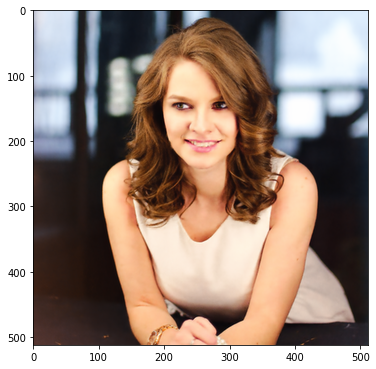

Iteration 05601    Loss 0.000114Iteration 05602    Loss 0.000112Iteration 05603    Loss 0.000110Iteration 05604    Loss 0.000110Iteration 05605    Loss 0.000112Iteration 05606    Loss 0.000109Iteration 05607    Loss 0.000111Iteration 05608    Loss 0.000109Iteration 05609    Loss 0.000115Iteration 05610    Loss 0.000111Iteration 05611    Loss 0.000109Iteration 05612    Loss 0.000114Iteration 05613    Loss 0.000110Iteration 05614    Loss 0.000111Iteration 05615    Loss 0.000115Iteration 05616    Loss 0.000112Iteration 05617    Loss 0.000116Iteration 05618    Loss 0.000123Iteration 05619    Loss 0.000127Iteration 05620    Loss 0.000138Iteration 05621    Loss 0.000130Iteration 05622    Loss 0.000121Iteration 05623    Loss 0.000119Iteration 05624    Loss 0.000111Iteration 05625    Loss 0.000117Iteration 05626    Loss 0.000120Iteration 05627    Loss 0.000120Iteration 05628    Loss 0.000123Iteration 05629    Loss 0.000119Iteration 05630    Loss 0.000107Iteration 05631    Loss 0.000119Iteratio

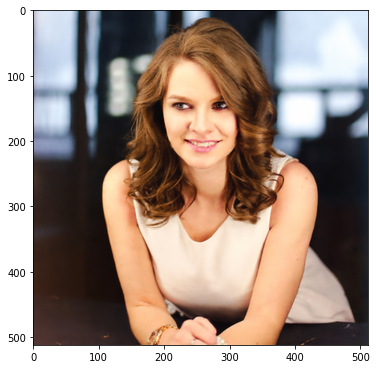

Iteration 05651    Loss 0.000123Iteration 05652    Loss 0.000119Iteration 05653    Loss 0.000114Iteration 05654    Loss 0.000113Iteration 05655    Loss 0.000123Iteration 05656    Loss 0.000123Iteration 05657    Loss 0.000117Iteration 05658    Loss 0.000112Iteration 05659    Loss 0.000110Iteration 05660    Loss 0.000117Iteration 05661    Loss 0.000113Iteration 05662    Loss 0.000115Iteration 05663    Loss 0.000112Iteration 05664    Loss 0.000117Iteration 05665    Loss 0.000116Iteration 05666    Loss 0.000116Iteration 05667    Loss 0.000117Iteration 05668    Loss 0.000116Iteration 05669    Loss 0.000125Iteration 05670    Loss 0.000118Iteration 05671    Loss 0.000114Iteration 05672    Loss 0.000111Iteration 05673    Loss 0.000116Iteration 05674    Loss 0.000126Iteration 05675    Loss 0.000127Iteration 05676    Loss 0.000137Iteration 05677    Loss 0.000140Iteration 05678    Loss 0.000127Iteration 05679    Loss 0.000113Iteration 05680    Loss 0.000111Iteration 05681    Loss 0.000132Iteratio

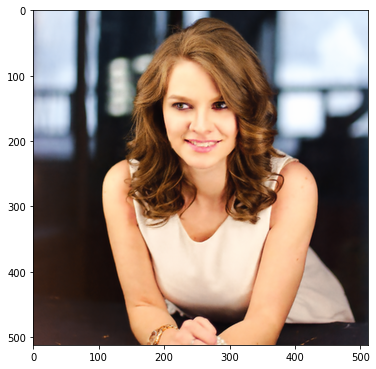

Iteration 05701    Loss 0.000118Iteration 05702    Loss 0.000128Iteration 05703    Loss 0.000129Iteration 05704    Loss 0.000127Iteration 05705    Loss 0.000130Iteration 05706    Loss 0.000123Iteration 05707    Loss 0.000111Iteration 05708    Loss 0.000116Iteration 05709    Loss 0.000128Iteration 05710    Loss 0.000118Iteration 05711    Loss 0.000109Iteration 05712    Loss 0.000111Iteration 05713    Loss 0.000111Iteration 05714    Loss 0.000110Iteration 05715    Loss 0.000107Iteration 05716    Loss 0.000113Iteration 05717    Loss 0.000110Iteration 05718    Loss 0.000107Iteration 05719    Loss 0.000109Iteration 05720    Loss 0.000117Iteration 05721    Loss 0.000116Iteration 05722    Loss 0.000110Iteration 05723    Loss 0.000110Iteration 05724    Loss 0.000127Iteration 05725    Loss 0.000134Iteration 05726    Loss 0.000123Iteration 05727    Loss 0.000128Iteration 05728    Loss 0.000133Iteration 05729    Loss 0.000122Iteration 05730    Loss 0.000108Iteration 05731    Loss 0.000111Iteratio

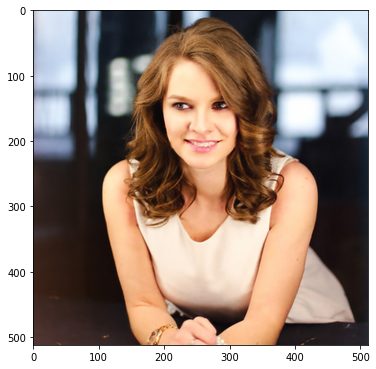

Iteration 05751    Loss 0.000118Iteration 05752    Loss 0.000119Iteration 05753    Loss 0.000114Iteration 05754    Loss 0.000114Iteration 05755    Loss 0.000111Iteration 05756    Loss 0.000112Iteration 05757    Loss 0.000117Iteration 05758    Loss 0.000118Iteration 05759    Loss 0.000120Iteration 05760    Loss 0.000112Iteration 05761    Loss 0.000110Iteration 05762    Loss 0.000107Iteration 05763    Loss 0.000108Iteration 05764    Loss 0.000110Iteration 05765    Loss 0.000108Iteration 05766    Loss 0.000106Iteration 05767    Loss 0.000106Iteration 05768    Loss 0.000104Iteration 05769    Loss 0.000107Iteration 05770    Loss 0.000106Iteration 05771    Loss 0.000108Iteration 05772    Loss 0.000107Iteration 05773    Loss 0.000110Iteration 05774    Loss 0.000114Iteration 05775    Loss 0.000118Iteration 05776    Loss 0.000114Iteration 05777    Loss 0.000107Iteration 05778    Loss 0.000106Iteration 05779    Loss 0.000109Iteration 05780    Loss 0.000124Iteration 05781    Loss 0.000130Iteratio

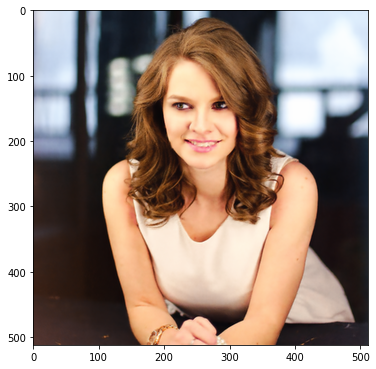

Iteration 05801    Loss 0.000116Iteration 05802    Loss 0.000118Iteration 05803    Loss 0.000108Iteration 05804    Loss 0.000102Iteration 05805    Loss 0.000109Iteration 05806    Loss 0.000115Iteration 05807    Loss 0.000109Iteration 05808    Loss 0.000103Iteration 05809    Loss 0.000104Iteration 05810    Loss 0.000111Iteration 05811    Loss 0.000116Iteration 05812    Loss 0.000114Iteration 05813    Loss 0.000111Iteration 05814    Loss 0.000116Iteration 05815    Loss 0.000113Iteration 05816    Loss 0.000114Iteration 05817    Loss 0.000112Iteration 05818    Loss 0.000106Iteration 05819    Loss 0.000114Iteration 05820    Loss 0.000121Iteration 05821    Loss 0.000118Iteration 05822    Loss 0.000124Iteration 05823    Loss 0.000130Iteration 05824    Loss 0.000135Iteration 05825    Loss 0.000137Iteration 05826    Loss 0.000124Iteration 05827    Loss 0.000116Iteration 05828    Loss 0.000111Iteration 05829    Loss 0.000108Iteration 05830    Loss 0.000111Iteration 05831    Loss 0.000109Iteratio

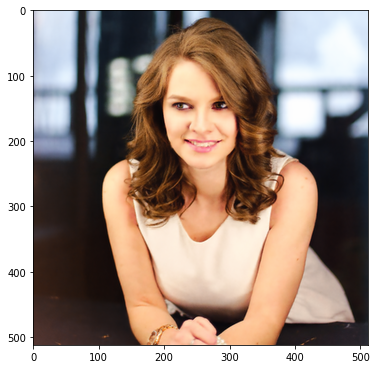

Iteration 05851    Loss 0.000117Iteration 05852    Loss 0.000120Iteration 05853    Loss 0.000118Iteration 05854    Loss 0.000114Iteration 05855    Loss 0.000114Iteration 05856    Loss 0.000111Iteration 05857    Loss 0.000111Iteration 05858    Loss 0.000113Iteration 05859    Loss 0.000114Iteration 05860    Loss 0.000113Iteration 05861    Loss 0.000114Iteration 05862    Loss 0.000119Iteration 05863    Loss 0.000127Iteration 05864    Loss 0.000125Iteration 05865    Loss 0.000123Iteration 05866    Loss 0.000110Iteration 05867    Loss 0.000107Iteration 05868    Loss 0.000107Iteration 05869    Loss 0.000107Iteration 05870    Loss 0.000108Iteration 05871    Loss 0.000114Iteration 05872    Loss 0.000113Iteration 05873    Loss 0.000111Iteration 05874    Loss 0.000112Iteration 05875    Loss 0.000110Iteration 05876    Loss 0.000107Iteration 05877    Loss 0.000107Iteration 05878    Loss 0.000108Iteration 05879    Loss 0.000111Iteration 05880    Loss 0.000115Iteration 05881    Loss 0.000111Iteratio

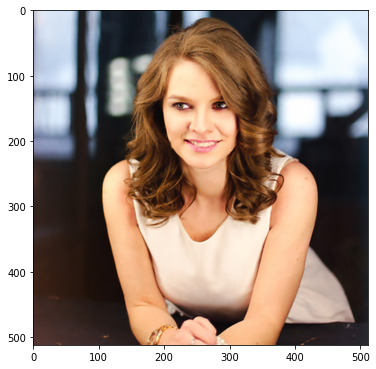

Iteration 05901    Loss 0.000117Iteration 05902    Loss 0.000113Iteration 05903    Loss 0.000111Iteration 05904    Loss 0.000122Iteration 05905    Loss 0.000122Iteration 05906    Loss 0.000127Iteration 05907    Loss 0.000124Iteration 05908    Loss 0.000127Iteration 05909    Loss 0.000136Iteration 05910    Loss 0.000132Iteration 05911    Loss 0.000110Iteration 05912    Loss 0.000105Iteration 05913    Loss 0.000123Iteration 05914    Loss 0.000137Iteration 05915    Loss 0.000135Iteration 05916    Loss 0.000132Iteration 05917    Loss 0.000138Iteration 05918    Loss 0.000142Iteration 05919    Loss 0.000130Iteration 05920    Loss 0.000118Iteration 05921    Loss 0.000112Iteration 05922    Loss 0.000120Iteration 05923    Loss 0.000116Iteration 05924    Loss 0.000104Iteration 05925    Loss 0.000108Iteration 05926    Loss 0.000115Iteration 05927    Loss 0.000114Iteration 05928    Loss 0.000103Iteration 05929    Loss 0.000104Iteration 05930    Loss 0.000108Iteration 05931    Loss 0.000108Iteratio

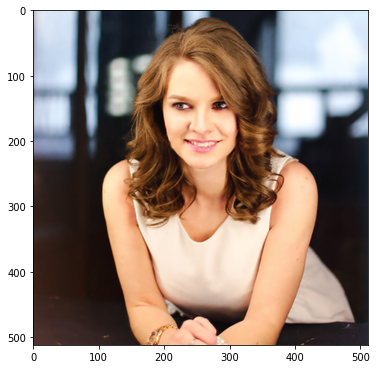

Iteration 05951    Loss 0.000105Iteration 05952    Loss 0.000104Iteration 05953    Loss 0.000105Iteration 05954    Loss 0.000102Iteration 05955    Loss 0.000106Iteration 05956    Loss 0.000106Iteration 05957    Loss 0.000115Iteration 05958    Loss 0.000112Iteration 05959    Loss 0.000110Iteration 05960    Loss 0.000103Iteration 05961    Loss 0.000102Iteration 05962    Loss 0.000105Iteration 05963    Loss 0.000113Iteration 05964    Loss 0.000122Iteration 05965    Loss 0.000128Iteration 05966    Loss 0.000124Iteration 05967    Loss 0.000114Iteration 05968    Loss 0.000106Iteration 05969    Loss 0.000107Iteration 05970    Loss 0.000108Iteration 05971    Loss 0.000109Iteration 05972    Loss 0.000103Iteration 05973    Loss 0.000101Iteration 05974    Loss 0.000102Iteration 05975    Loss 0.000113Iteration 05976    Loss 0.000121Iteration 05977    Loss 0.000114Iteration 05978    Loss 0.000104Iteration 05979    Loss 0.000100Iteration 05980    Loss 0.000108Iteration 05981    Loss 0.000115Iteratio

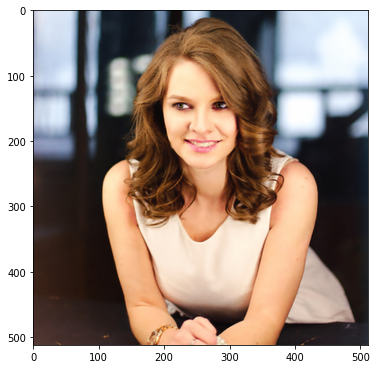

In [11]:
i = 0
loss=[]
def closure():
    
    global i,loss
    
    if param_noise:
        for n in [x for x in net.parameters() if len(x.size()) == 4]:
            n = n + n.detach().clone().normal_() * n.std() / 50
    
    net_input = net_input_saved
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
        
        
    out = net(net_input)
   
    total_loss = mse(out * mask_var, img_var * mask_var)
    total_loss.backward()
    loss=np.append(loss,total_loss.item())
    print ('Iteration %05d    Loss %f' % (i, total_loss.item()), sep='\r', end='')
    if  PLOT and i % show_every == 0:
        out_np = torch_to_np(out)
        plot_image_grid([np.clip(out_np, 0, 1)], factor=figsize, nrow=1)
        
    i += 1

    return total_loss

net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()

p = get_params(OPT_OVER, net, net_input)
optimize(OPTIMIZER, p, closure, LR, num_iter)

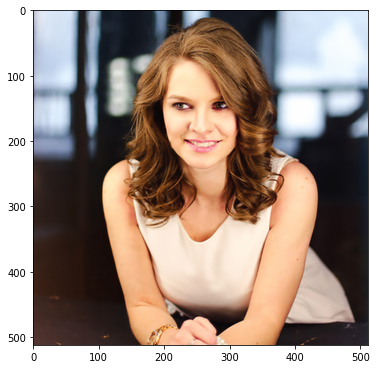

In [12]:
out_np = torch_to_np(net(net_input))
plot_image_grid([out_np], factor=5);

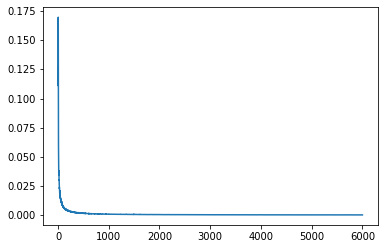

In [13]:
plt.plot(loss)